# <font color="#30143">Análisis Exploratorio de Datos</font>
<br><br>

---

## <font color="#30143">Introducción</font>

En esta investigación, trabajaremos con el conjunto de datos *"data_2017_2022.csv"*, el cual está compuesto por 4.084.061 registros obtenidos de un sistema de sensores distribuidos en 9 estaciones de medición de variables meteorológicas  ubicadas en el Valle del Cauca. Estas estaciones no solo miden nuestra variable objetivo, el PM10, sino también otros atríbutos y/o características asociadas al indice de la calidad del aire. La recolección de datos se realizó desde el 1 de enero de 2017 hasta el 31 de diciembre de 2022, abarcando un período total de 5 años.

### <font color="#30143">Importar Librerías</font>

In [1]:
# Load libraries
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
# Load sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error

import warnings
warnings.filterwarnings("ignore")

### <font color="#30143"> Cargar el dataset</font>

A continuación usamos la función `read_cvs()` de la libreria `pandas`para cargar los datos a nuestro entorno de trabajo. 

In [2]:
df = pd.read_csv("data_2017_2022.csv", sep=";")
df.head()

,fecha,estacion,variable,tipo,medicion
0,2017-01-01T00:59:59Z,base_aerea,pm25,val,NaN
1,2017-01-01T00:59:59Z,base_aerea,so2,val,NaN
2,2017-01-01T00:59:59Z,base_aerea,lluvia,val,NaN
3,2017-01-01T00:59:59Z,base_aerea,o3,val,NaN
4,2017-01-01T00:59:59Z,base_aerea,temperatura,val,NaN


---

## <font color="#30143"> Estadística Descriptiva</font>

### <font color="#30143"> Dimensiones y visualización del conjunto de datos</font>

A continuación verificados el tamaño de nuestro dataset y los nombres de cada una de las columnas y tipo de dato que lo componen: 

In [3]:
print(f'Cantidad de filas y columnnas{df.shape}')
print(f'Nombres de Columnas{df.columns}')

Cantidad de filas y columnnas(4084061, 5)
Nombres de ColumnasIndex(['fecha', 'estacion', 'variable', 'tipo', 'medicion'], dtype='object')


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4084061 entries, 0 to 4084060
Data columns (total 5 columns):
 #   Column    Dtype 
---  ------    ----- 
 0   fecha     object
 1   estacion  object
 2   variable  object
 3   tipo      object
 4   medicion  object
dtypes: object(5)
memory usage: 155.8+ MB


Ademas vemos una representación de los datos a tráves de la función `head()`

In [5]:
# head
df.head(5)

,fecha,estacion,variable,tipo,medicion
0,2017-01-01T00:59:59Z,base_aerea,pm25,val,NaN
1,2017-01-01T00:59:59Z,base_aerea,so2,val,NaN
2,2017-01-01T00:59:59Z,base_aerea,lluvia,val,NaN
3,2017-01-01T00:59:59Z,base_aerea,o3,val,NaN
4,2017-01-01T00:59:59Z,base_aerea,temperatura,val,NaN


<div class="alert alert-block" style="background-color: #e1d9e3; color: #30143; padding: 10px; border-radius: 10px;">
    <i class="fa fa-info-circle" aria-hidden="true"></i>
    <strong>Importante:</strong>
    Es necesario realizar un ajuste conforme a los principios de 
    <a href="https://www.jstatsoft.org/article/view/v059i10" target="_blank" style="color: #30143;">
        Tidy Data
    </a> 
    Para organizar los datos de manera efectiva, es fundamental <em>"mapear el significado de un conjunto de datos a su estructura de forma estándar"</em>, lo que facilita su análisis. Además, es crucial modificar el tipo de datos en ciertas variables; por ejemplo, convertir la variable "medición" a un formato numérico y la variable "fecha" a un formato datetime. Estos cambios permiten realizar análisis más precisos y eficientes, optimizando así la interpretación y el uso de la información contenida en el conjunto de datos.
</div>



* **<font color="#30143"> Estructuración de Datos según el Enfoque Tidy</font>**

In [6]:
df_1 = df.copy()
df_1["medicion"]=df_1["medicion"].str.replace(",", ".").astype("float") # convertir variable medición a númerica
df_1['fecha'] = pd.to_datetime(df_1['fecha']) # convertir variable fecha a datatime
df_1 = df_1.pivot(index=["fecha", "estacion"],columns= "variable", values="medicion").reset_index()
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 473256 entries, 0 to 473255
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype              
---  ------            --------------   -----              
 0   fecha             473256 non-null  datetime64[ns, UTC]
 1   estacion          473256 non-null  object             
 2   black_carbon      8620 non-null    float64            
 3   direccion_viento  204419 non-null  float64            
 4   h2s               15353 non-null   float64            
 5   humedad           230887 non-null  float64            
 6   lluvia            260671 non-null  float64            
 7   no2               1 non-null       float64            
 8   o3                201936 non-null  float64            
 9   pm10              234568 non-null  float64            
 10  pm25              174546 non-null  float64            
 11  presion           209181 non-null  float64            
 12  radiacion_solar   221284 non-null  float64  

Para más practicidad se renombran las variables de nuestro conjunto de datos. 

In [7]:
df_1 = df_1.rename(columns={    
    'variable': 'var',
    'black_carbon': 'BC',
    'direccion_viento': 'WD',
    'humedad': 'HR',
    'lluvia': 'RF',
    'presion': 'P',
    'radiacion_solar': 'RS',
    'temperatura': 'AT',
    'temperatura_10_m': 'AT_10_m',
    'uv-pm': 'UV',
    'velocidad_viento': 'WS',
    'h2s': 'H2S',
    'no2': 'NO2',
    'o3': 'O3',
    'so2': 'SO2',
    'pm10': 'PM10',
    'pm25': 'PM2.5'  
})

In [8]:
print(f'Cantidad de filas y columnnas{df_1.shape}')

Cantidad de filas y columnnas(473256, 18)


In [9]:
df_1["estacion"].unique()

array(['base_aerea', 'canaveralejo', 'compartir', 'era_obrero', 'ermita',
       'flora', 'pance', 'transitoria', 'univalle'], dtype=object)

In [10]:
# Obtener la fecha mínima y máxima
fecha_minima = df_1['fecha'].min()
fecha_maxima = df_1['fecha'].max()

print(f"Fecha mínima: {fecha_minima}")
print(f"Fecha máxima: {fecha_maxima}")

Fecha mínima: 2017-01-01 00:59:59+00:00
Fecha máxima: 2022-12-31 23:59:59+00:00


Ahora, nuestro conjunto de datos está compuesto por 473.256 registros obtenidos de un sistema de sensores distribuidos en 9 estaciones de medición de variables meteorológicas  ubicadas en el Valle del Cauca. La recolección de datos se realizó desde el 1 de enero de 2017 hasta el 31 de diciembre de 2022, abarcando un período total de 5 años.

A continuación se define nuestra variable objetivo (Target) y los atributos (características):

* PM10: Concentración de material particulado con diámetro aerodinámico menor o igual a 10 micrómetros $(\mu g/m^3)$ (Target).

* fecha: Corresponde a la fecha y hora de la medición en formato ISO 8601 (AAAA-MM-DDTHH:MM:SSZ).

* estacion: Identifica la estación de monitoreo donde se realizó la medición.

* BC: Concentración de carbono negro o hollín en el aire $(\mu g/m^3)$.

* WD: Dirección del viento en grados $(°)$.

* H2S: Concentración de sulfuro de hidrógeno $(\mu g/m^3)$.

* HR: Humedad relativa del aire en porcentaje $(%)$

* RF: Cantidad de precipitación en milímetros $(mm)$.

* NO2: Concentración de dióxido de nitrógeno $(\mu g/m^3)$.

* O3: Concentración de ozono $(\mu g/m^3)$.

* PM2.5: Concentración de material particulado con diámetro aerodinámico menor o igual a 2.5 micrómetros $(\mu g/m^3)$.

* P: Presión atmosférica en hectopascales $(\text{hPa})$.

* RS: Radiación solar en vatios por metro cuadrado $(W/m^2)$.

* SO2: Concentración de dióxido de azufre $(\mu g/m^3)$..

* AT: Temperatura del aire en grados Celsius $(°C)$.

* AT_10_m: Temperatura del aire a 10 metros de altura en grados Celsius  $(°C)$.

* UV: Índice UV.

* WS: Velocidad del viento en metros por segundo cuadrado $m/s^2$.

A continuación visualizamos nuestros datos a tráves de la función `head()`

In [11]:
df_1.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,NO2,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
0,2017-01-01 00:59:59+00:00,base_aerea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2017-01-01 00:59:59+00:00,canaveralejo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.7,NaN,NaN,NaN,0.314265,NaN,NaN,NaN,NaN
2,2017-01-01 00:59:59+00:00,compartir,NaN,208.6,NaN,75.9,0.0,NaN,8.456252,221.0,161.0,680.5,0.0,NaN,25.3,NaN,NaN,1.4
3,2017-01-01 00:59:59+00:00,era_obrero,NaN,NaN,NaN,NaN,0.0,NaN,16.147321,195.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2017-01-01 00:59:59+00:00,ermita,NaN,NaN,NaN,NaN,NaN,NaN,NaN,61.9,NaN,NaN,NaN,2.147475,NaN,NaN,NaN,NaN


### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [12]:
pd.set_option('display.precision', 2)
df_1.describe()

variable,BC,WD,H2S,HR,RF,NO2,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,8620.00,204419.00,15353.00,230887.00,260671.00,1.00,201936.00,234568.00,174546.00,209181.00,221284.00,132180.00,267206.00,13746.00,8620.00,205405.00
mean,4.55,178.45,2.15,70.71,0.28,0.13,25.26,40.49,16.66,878.77,226.74,4.64,25.56,23.71,2.79,1.55
std,18.99,100.54,2.13,16.13,2.57,NaN,28.97,25.00,10.93,70.11,294.66,8.49,3.85,3.48,1.79,1.46
min,0.03,0.00,0.00,12.80,0.00,0.13,-3.16,0.00,0.00,27.70,0.00,-4.53,8.00,14.70,0.02,0.00
25%,1.30,95.90,0.68,58.60,0.00,0.13,5.77,23.00,8.92,900.20,0.00,1.23,22.50,20.90,1.57,0.60
50%,1.99,173.30,1.49,71.10,0.00,0.13,12.95,36.00,14.34,903.00,23.00,3.04,25.20,22.90,2.41,1.00
75%,2.96,262.60,2.73,83.90,0.00,0.13,34.73,53.00,22.36,905.30,488.00,6.23,28.20,26.60,3.51,2.10
max,408.71,360.00,27.98,100.70,156.97,0.13,290.44,420.00,388.00,913.50,1042.91,842.15,40.20,33.00,20.77,37.70


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados:  
* **BC (Carbono Negro)**: Total de observaciones: $8,620$, media: $4.55\frac{\mu g}{m^3}$, desviación estándar: $18.99\frac{\mu g}{m^3}$, mínimo: $0.03\frac{\mu g}{m^3}$, máximo: $408.71\frac{\mu g}{m^3}$. La distribución es amplia y muestra un sesgo a la derecha, dado el alto valor máximo en comparación con la media.
  
* **WD (Dirección del Viento)**:Total de observaciones: $204,419$, media: $178.45°$, desviación estándar: $100.54°$, mínimo: $0°$, máximo: $360°$. La dirección del viento cubre todo el rango posible, sugiriendo una distribución uniforme.
  
* **H2S (Sulfuro de Hidrógeno)**:Total de observaciones: $15,353$, media: $2.15\frac{\mu g}{m^3}$, desviación estándar: $2.13\frac{\mu g}{m^3}$, mínimo: $0.00\frac{\mu g}{m^3}$, máximo: $27.98\frac{\mu g}{m^3}$. En cuanto a la distribución de los datos se observa que la mayoría de las mediciones de $\text{H}_2\text{S}$ se encuentran muy cercanas a la media, lo que indica una variabilidad mínima, pero con algunos valores extremos.

* **HR (Humedad Relativa)**:Total de observaciones: $230,887$, media: $70.71\%$, desviación estándar: $16.13\%$, mínimo: $12.80\%$, máximo: $100.70\%$
La humedad relativa muestra una distribución bastante amplia, pero centrada alrededor de la media, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos de humedad. 

* **RF (Precipitación)**: Total de observaciones: $260,671$, media: $0.28 mm$, desviación estándar: $2.57 mm$, mínimo: $0.00 mm$, máximo: $156.97 mm$, La mayoría de las mediciones de precipitación son bajas, con algunos eventos de lluvia intensa.
  
* **NO2 (Dióxido de Nitrógeno)**:Total de observaciones: 1, media: $0.13\frac{\mu g}{m^3}$. La falta de datos suficientes hace que el análisis sea limitado.

* **O3 (Ozono)**: Total de observaciones: $201,936$, media: $25.26\frac{\mu g}{m^3}$, desviación estándar: $28.97\frac{\mu g}{m^3}$, mínimo: $-3.16\frac{\mu g}{m^3}$, máximo: $290.44\frac{\mu g}{m^3}$. La distribución es amplia con un sesgo a la derecha debido a valores máximos altos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de $\text{O}_3$. 

* **PM10**: Total de observaciones: $234,568$, media: $40.49\frac{\mu g}{m^3}$, desviación estándar: $25.00\frac{\mu g}{m^3}$, mínimo: $0.00\frac{\mu g}{m^3}$, máximo: $420.00\frac{\mu g}{m^3}$, La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de PM10. 

* **PM2.5**: Total de observaciones: $174,546$, media: $16.66\frac{\mu g}{m^3}$, desviación estándar: $10.93\frac{\mu g}{m^3}$, mínimo: $0.00\frac{\mu g}{m^3}$, máximo: $388.00\frac{\mu g}{m^3}$, La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de PM2.5. 

* **P (Presión Atmosférica)**: Total de observaciones: $209,181$, media: $878.77 \text{hPa}$, desviación estándar: $70.11 \text{hPa}$, mínimo: $27.70\text{hPa}$, máximo: $913.50 \text{hPa}$. En cuanto a la distribución de los datos se observa quela mayoría de las mediciones de presión atmosférica se encuentran muy cercanas a la media, lo que indica una variabilidad mínima, pero con algunos valores mínimos que sugieren una mala medición. 

* **RS (Radiación Solar)**: Total de observaciones: $221,284$, Media: $226.74 \frac{W}{m^2}$, Desviación estándar: $294.66 \frac{W}{m^2}$, Mínimo: $0.00 \frac{W}{m^2}$, máximo: $1042.91 \frac{W}{m^2}$: La radiación solar tiene una distribución amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos Radiación Solar. 


* **SO2 (Dióxido de Azufre)**: Total de observaciones: $132,180$, media: $4.64\frac{\mu g}{m^3}$, desviación estándar: $8.49\frac{\mu g}{m^3}$, mínimo: $-4.53\frac{\mu g}{m^3}$, máximo: $842.15\frac{\mu g}{m^3}$. La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de $\text{SO}_2$

* **AT (Temperatura del Aire)**: Total de observaciones: $267,206$, media: $25.56°\text{C}$, desviación estándar: $3.85°\text{C}$, mínimo: $8.00°\text{C}$, máximo: $40.20°\text{C}$. La temperatura del aire tiene una distribución se encuentran muy cercanas a la media, lo que indica una variabilidad mínima, pero con algunos valores extremos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos Temperatura del aire. 


* **AT_10_m (Temperatura del Aire a 10 metros)**: Total de observaciones: $13,746$ media: $23.71°\text{C}$, desviación estándar: $3.48°\text{C}$, mínimo: $14.70°\text{C}$, máximo: $33.00°\text{C}$, La temperatura del aire a 10 metros también muestra una distribución estrecha, es decir que las mediciones se encuentran muy próximas a la media, lo que indica una variabilidad mínima, pero con algunos valores extremos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos Temperatura del aire a 10 metros de altura. 

* **UV (Índice UV)**:Total de observaciones: $8,620$, media: $2.79$, desviación estándar: $1.79$, mínimo: $0.02$, máximo: $20.77$, El índice UV muestra una distribución amplia con un sesgo a la derecha.

* **WS (Velocidad del Viento)**: Total de observaciones: $205,405$, media: $1.55 \frac{m}{s}$, desviación estándar: $1.46 \frac{m}{s}$, mínimo: $0.00 \frac{m}{s}$, máximo: $37.70 \frac{m}{s}$. La velocidad del viento tiene una distribución amplia con algunos valores extremos.



### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()`.

In [13]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 473256 entries, 0 to 473255
Data columns (total 18 columns):
 #   Column    Non-Null Count   Dtype              
---  ------    --------------   -----              
 0   fecha     473256 non-null  datetime64[ns, UTC]
 1   estacion  473256 non-null  object             
 2   BC        8620 non-null    float64            
 3   WD        204419 non-null  float64            
 4   H2S       15353 non-null   float64            
 5   HR        230887 non-null  float64            
 6   RF        260671 non-null  float64            
 7   NO2       1 non-null       float64            
 8   O3        201936 non-null  float64            
 9   PM10      234568 non-null  float64            
 10  PM2.5     174546 non-null  float64            
 11  P         209181 non-null  float64            
 12  RS        221284 non-null  float64            
 13  SO2       132180 non-null  float64            
 14  AT        267206 non-null  float64            
 15  

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [14]:
missing_values = df_1.isna().sum()
total_rows = df_1.shape[0]

missing_vars = missing_values[missing_values > 0]

missing_info_df = pd.DataFrame({    
    'Datos faltantes': missing_vars,
    'Porcentaje (%)': round((missing_vars / total_rows) * 100,2)})

missing_info_df

,Datos faltantes,Porcentaje (%)
variable,,
BC,464636,98.18
WD,268837,56.81
H2S,457903,96.76
HR,242369,51.21
RF,212585,44.92
NO2,473255,100.00
O3,271320,57.33
PM10,238688,50.44
PM2.5,298710,63.12


Dado que la variable la variable $\text{NO}_2$ tiene solo $1$ medición entre $473.256$ registros durante el periodo analizado, lo que representa casi un $100\%$ de datos faltantes, hemos optado por excluirla del análisis. 

Además, considerando que muchas de nuestras variables tienen más del $50\%$ de datos faltantes, planeamos aplicar un filtro por estación más adelante. Esto nos permitirá identificar qué estación tiene la menor cantidad de valores faltantes, ayudándonos a mitigar este problema de manera más efectiva.

In [15]:
df_t = df_1.copy()
df_t = df_t.drop(columns=["NO2"])

In [16]:
df_t.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 473256 entries, 0 to 473255
Data columns (total 17 columns):
 #   Column    Non-Null Count   Dtype              
---  ------    --------------   -----              
 0   fecha     473256 non-null  datetime64[ns, UTC]
 1   estacion  473256 non-null  object             
 2   BC        8620 non-null    float64            
 3   WD        204419 non-null  float64            
 4   H2S       15353 non-null   float64            
 5   HR        230887 non-null  float64            
 6   RF        260671 non-null  float64            
 7   O3        201936 non-null  float64            
 8   PM10      234568 non-null  float64            
 9   PM2.5     174546 non-null  float64            
 10  P         209181 non-null  float64            
 11  RS        221284 non-null  float64            
 12  SO2       132180 non-null  float64            
 13  AT        267206 non-null  float64            
 14  AT_10_m   13746 non-null   float64            
 15  

### <font color="#30143"> Correlación entre características</font>

In [17]:
# Pairwise Pearson correlations
pd.set_option('display.precision', 4)
df_c = df_t.drop(columns=['fecha', 'estacion'])
correlations = df_c.corr(method = 'spearman')
correlations

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,1.0000,-0.1643,NaN,0.0249,-0.0845,-0.0510,0.5673,0.5995,0.1367,0.0963,NaN,0.0418,NaN,0.8886,-0.1256
WD,-0.1643,1.0000,-0.1010,-0.2033,-0.0307,0.0579,-0.0122,-0.1136,-0.1084,-0.0106,-0.3000,0.1821,0.1868,-0.2157,0.3004
H2S,NaN,-0.1010,1.0000,0.2091,-0.0749,-0.2491,0.3541,0.2734,0.1916,-0.1794,NaN,-0.1580,NaN,NaN,-0.1342
HR,0.0249,-0.2033,0.2091,1.0000,0.2673,-0.7015,-0.2427,0.0366,0.4062,-0.4706,-0.2024,-0.9229,-0.9550,0.0634,-0.5506
RF,-0.0845,-0.0307,-0.0749,0.2673,1.0000,-0.1077,-0.1997,-0.1212,0.0675,-0.1307,-0.0534,-0.2245,-0.2850,-0.0976,-0.0216
O3,-0.0510,0.0579,-0.2491,-0.7015,-0.1077,1.0000,0.0226,0.0184,-0.2496,0.6157,0.1373,0.7193,0.6925,-0.1199,0.4495
PM10,0.5673,-0.0122,0.3541,-0.2427,-0.1997,0.0226,1.0000,0.5251,-0.0794,0.1352,0.2754,0.2529,0.3513,0.6235,0.0696
PM2.5,0.5995,-0.1136,0.2734,0.0366,-0.1212,0.0184,0.5251,1.0000,0.1759,0.1747,0.3089,0.0086,0.2298,0.6577,-0.2152
P,0.1367,-0.1084,0.1916,0.4062,0.0675,-0.2496,-0.0794,0.1759,1.0000,0.1225,0.0517,-0.3185,-0.1784,0.1545,-0.2700


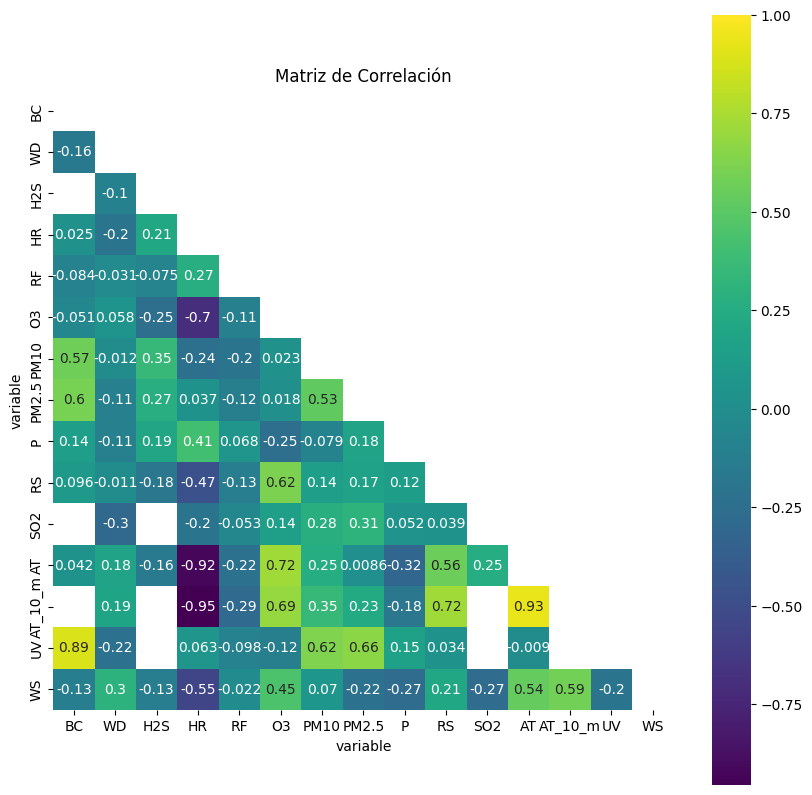

In [18]:
import seaborn as sns

plt.figure(figsize = (10,10))
mask = np.triu(np.ones_like(correlations, dtype=bool))
ax = sns.heatmap(correlations, vmax = 1, square = True, annot = True,mask=mask, cmap = 'viridis')
plt.title('Matriz de Correlación')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.92): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.
* `AT_10_m` y `HR` (-0.96): Refuerza la relación inversa entre temperatura y humedad.
* `UV` y `BC` (0.89): Sugiere que indices altos de rayos UV están asociadas con un aumento en los niveles del carbon negro.
* `AT_10_m` y `AT` (0.93): Sugiere que las temperaturas más altas estan asociadas con un aumento en la temperaturas a 10 metros de altura. 

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:
* `AT` y `O3` (0.71): Sugiere que las temperaturas más altas están asociadas con un aumento en los niveles de ozono.
* `AT_10_m` y `O3` (0.72): Similar al anterior, mostrando una fuerte relación entre temperatura y ozono.
* `HR` y `O3` (	-0.70): Indica que niveles más altos de humedad relativa están relacionados con una disminución en los niveles de ozono.
* `PM10` y `BC` (-0.70): Sugiere que los niveles altos de PM10 están asociadas con un aumento en los niveles del carbon negro
* `PM2.5` y `BC` (-0.70): Sugiere que los niveles altos de PM2.5 están asociadas con un aumento en los niveles del carbon negro
* `WS` y `HR` (-0.55): Sugiere que al aumentar la velocidad del viento, los niveles de humedad relativa disminuyen.
* `O3` y `RS` (0.62): Indica que un aumento en el ozono está asociado con un incremento en la radiación solar.
  
* `PM2.5` y `PM10` (0.52): Muestra que las concentraciones de estas partículas están estrechamente relacionadas, posiblemente por fuentes comunes o condiciones ambientales.
* `WS` y `AT` (0.54): Indica que al aumentar la velocidad del viento, la temperatura también aumenta.
* `WS` y `AT_10_m` (0.59): Indica que al aumentar la velocidad del viento, la temperatura a 10 metros de altura también aumenta.

Este análisis resalta las relaciones significativas entre las variables meteorológicas y la calidad del aire, proporcionando información valiosa sobre cómo las condiciones ambientales pueden influir en los niveles de contaminación. Sin embargo, se observó que aparentemente solo el carbon negro `BC` tiene una influencia fuerte en el aumento de los niveles de material particulado `PM10` y `PM2.5`, y este incremento es independiente de las condiciones ambientales. 


### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`:

In [19]:
# Skew for each attribute
df_c.skew()

variable
BC         12.4746
WD          0.0532
H2S         2.1684
HR         -0.1811
RF         20.1186
O3          1.7852
PM10        1.5173
PM2.5       2.0353
P          -2.4791
RS          0.9886
SO2        35.7246
AT          0.4475
AT_10_m     0.4492
UV          1.9907
WS          2.1691
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **SO2**: 35.7246
* **BC**: 12.4746
* **RF**: 20.1186
* **O3**: 1.7852
* **PM10**: 1.5173
* **PM2.5**: 2.0353
* **WS**:  2.1691
* **P**: -2.4791
* **UV**: 1.9907
* **H2S**: 2.1684

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):
* **RS**: 0.9886
* **WD**: 0.0532
* **HR**: -0.1811
* **AT**: 0.4475
* **AT_10_m**: 0.4492

---

## <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

### <font color="#30143"> Histograma y gráfico de densidad</font>

<Axes: xlabel='H2S', ylabel='Density'>

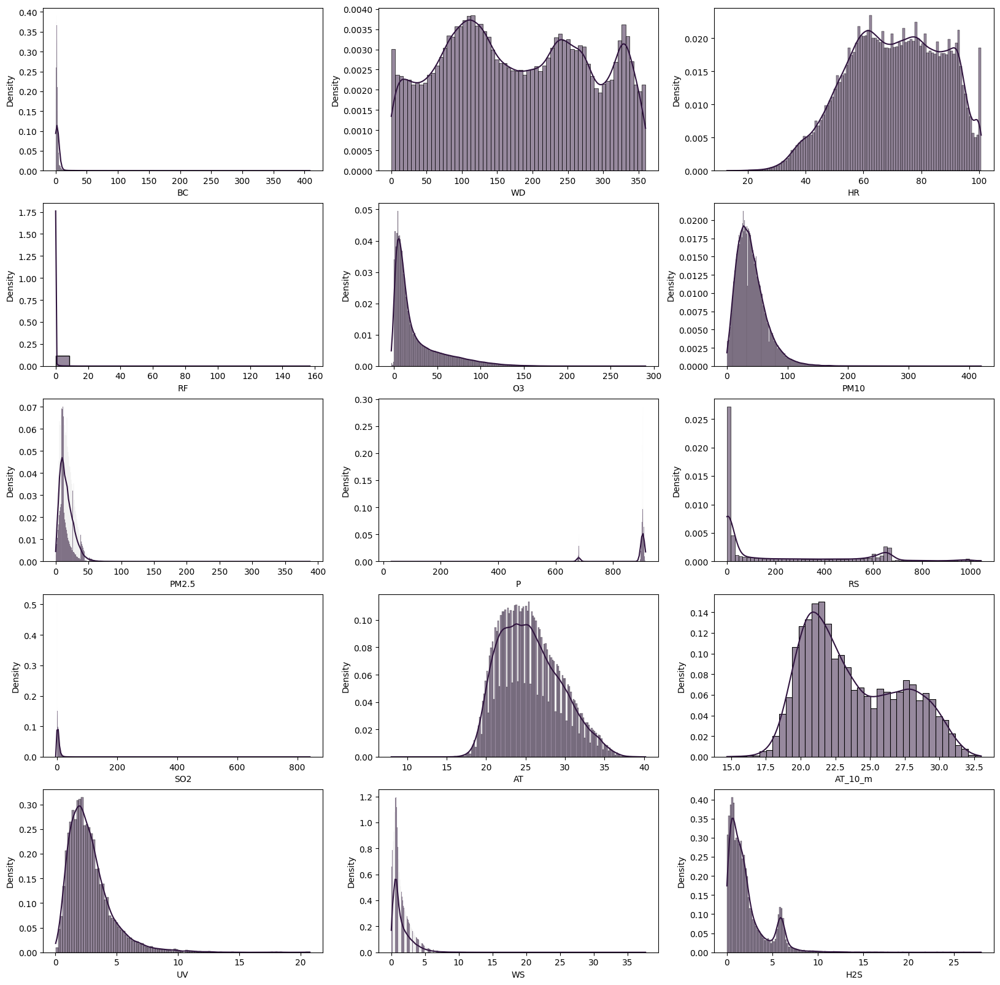

In [20]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns
f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_t["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
#sns.histplot(df_t["NO2"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["O3"], ax=ax[1, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_t["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

### <font color="#30143"> Diagrama de Cajas y Bigotes</font>

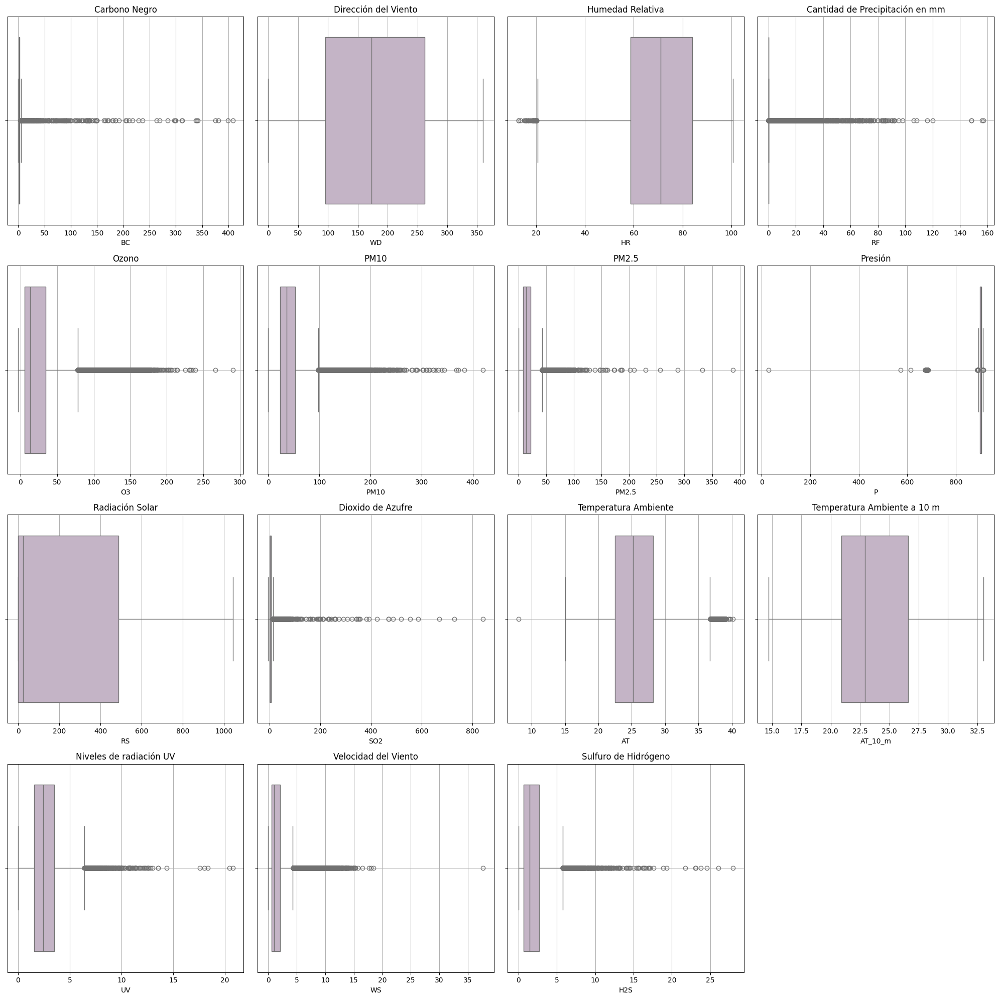

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para BC
plt.subplot(441)
sns.boxplot(x=df_t["BC"], color="#c6b1c9") 
plt.title('Carbono Negro')
plt.grid(True)

# Subplot para WD
plt.subplot(442)
sns.boxplot(x=df_t["WD"], color="#c6b1c9") 
plt.title('Dirección del Viento')
plt.grid(True)

# Subplot para HR
plt.subplot(443)
sns.boxplot(x=df_t["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para RF
plt.subplot(444)
sns.boxplot(x=df_t["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)


# Subplot para O3
plt.subplot(445)
sns.boxplot(x=df_t["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM10
plt.subplot(446)
sns.boxplot(x=df_t["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(447)
sns.boxplot(x=df_t["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(448)
sns.boxplot(x=df_t["P"], color="#c6b1c9") 
plt.title('Presión')
plt.grid(True)

# Subplot para RS
plt.subplot(449)
sns.boxplot(x=df_t["RS"], color="#c6b1c9") 
plt.title('Radiación Solar')
plt.grid(True)

# Subplot para SO2
plt.subplot(4, 4, 10)
sns.boxplot(x=df_t["SO2"], color="#c6b1c9") 
plt.title('Dioxido de Azufre')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 11)
sns.boxplot(x=df_t["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Subplot para AT_10_m
plt.subplot(4, 4, 12)
sns.boxplot(x=df_t["AT_10_m"], color="#c6b1c9") 
plt.title('Temperatura Ambiente a 10 m')
plt.grid(True)

# Subplot para UV
plt.subplot(4, 4, 13)
sns.boxplot(x=df_t["UV"], color="#c6b1c9") 
plt.title('Niveles de radiación UV')
plt.grid(True)

# Subplot para WS
plt.subplot(4, 4, 14)
sns.boxplot(x=df_t["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)

# Subplot para WS
plt.subplot(4, 4, 15)
sns.boxplot(x=df_t["H2S"], color="#c6b1c9") 
plt.title('Sulfuro de Hidrógeno')
plt.grid(True)


# Mostrar los gráficos
plt.tight_layout()
plt.show()




El diagrama de cajas y bigotes no solo complementa el resumen estadístico al mostrar visualmente aspectos como el sesgo, la simetría de la distribución y las medidas de posición, sino que también permite observar cómo se comportan las variables en relación con los valores atípicos. En este contexto, se puede notar que, salvo la dirección del viento, la temperatura ambiente a 10 metros de altura y el indice de radiación solar, las demás variables analizadas son propensas a tener posibles datos atípicos u outliers. 

A continuación se visualiza las interacciones entre las variables. 

### <font color="#30143"> Diagramas de dispersión</font>

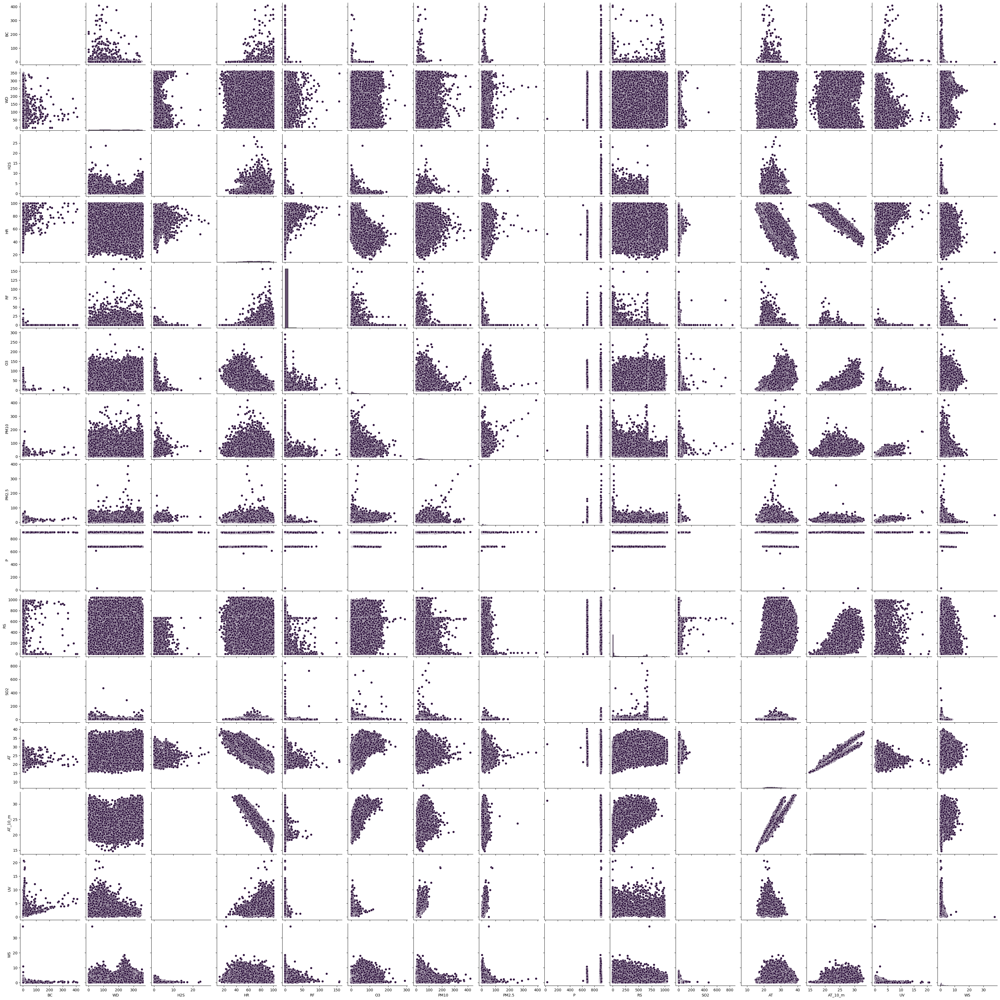

In [22]:
import seaborn as sns
sns.pairplot(df_c, 
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas


A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

---

## <font color="#30143"> Segmentación de datos por estación de medición</font>

Al filtrar por estación, esperamos reducir significativamente el porcentaje de datos faltantes en el conjunto de datos. Esto nos permitirá trabajar con un conjunto de datos más completo y preciso, lo que a su vez mejorará la calidad de los análisis y las conclusiones que podamos extraer.

Es importante tener en cuenta que la presencia de una gran cantidad de datos faltantes puede sesgar los resultados y limitar la capacidad de generalización de nuestro modelo. Por lo tanto, reducir este problema mediante un filtrado estratégico es un paso crucial en el proceso de análisis de datos.

Una vez que hayamos identificado la estación con menor cantidad de datos faltantes, podremos proceder con el análisis, teniendo en cuenta las limitaciones inherentes a los datos disponibles. Además, será necesario considerar el impacto que la falta de datos puede tener en la interpretación de los resultados y en la toma de decisiones basada en estos análisis.

A continuación se define función para visualización de datos faltantes por estación.

In [23]:
#Función para determinar los datos faltantes
def data_missing(df, columns, station): 
    df_missing = df[df[columns] == station]
    missing_values = df_missing.isna().sum()
    total_rows = df_missing.shape[0]

    missing_vars = missing_values[missing_values > 0]

    missing_info_df = pd.DataFrame({    
        'Datos faltantes': missing_vars,
        'Porcentaje (%)': round((missing_vars / total_rows) * 100, 2)
    })

    return missing_info_df

### <font color="#30143"> Estación Base Aérea</font>

A continuación visualizamos los datos correspondientes a la estación `base aérea`a tráves de la función `head()`

In [24]:
df_base_aerea = df_t[df_t['estacion'] == 'base_aerea']
df_base_aerea.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
0,2017-01-01 00:59:59+00:00,base_aerea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2017-01-01 01:59:59+00:00,base_aerea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18,2017-01-01 02:59:59+00:00,base_aerea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
27,2017-01-01 03:59:59+00:00,base_aerea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,2017-01-01 04:59:59+00:00,base_aerea,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [25]:
pd.set_option('display.precision', 2)
df_base_aerea.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,1990.00,0.0,0.0,11627.00,31941.00,0.0,32174.00,0.0,0.0,26537.00,37628.00,0.0,0.0,1986.00
mean,NaN,131.19,NaN,NaN,0.17,18.30,NaN,20.75,NaN,NaN,7.94,25.35,NaN,NaN,0.56
std,NaN,68.40,NaN,NaN,1.33,18.34,NaN,12.40,NaN,NaN,5.21,3.86,NaN,NaN,0.42
min,NaN,0.00,NaN,NaN,0.00,-0.65,NaN,0.00,NaN,NaN,0.00,15.30,NaN,NaN,0.00
25%,NaN,80.83,NaN,NaN,0.00,5.81,NaN,12.00,NaN,NaN,4.56,22.40,NaN,NaN,0.20
50%,NaN,122.10,NaN,NaN,0.00,10.87,NaN,19.00,NaN,NaN,6.70,24.90,NaN,NaN,0.50
75%,NaN,172.57,NaN,NaN,0.00,24.86,NaN,27.00,NaN,NaN,10.11,28.10,NaN,NaN,0.70
max,NaN,324.20,NaN,NaN,63.50,133.18,NaN,202.00,NaN,NaN,89.62,38.60,NaN,NaN,3.00


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados en la estación `base áerea`:  

* **BC (Carbono Negro)**: Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.
  
* **WD (Dirección del Viento)**:Total de observaciones: $1,990$, media: $131.19°$, desviación estándar: $68.40°$, mínimo: $0°$, máximo: $342.20°$. La dirección del viento cubre todo el rango posible, sugiriendo una distribución uniforme.
  
* **H2S (Sulfuro de Hidrógeno)**:Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.
  
* **HR (Humedad Relativa)**:Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.

* **RF (Precipitación)**: Total de observaciones: $11,627$, media: $18.30mm$, desviación estándar: $1.33mm$, mínimo: $0.00 mm$, máximo: $63.50mm$, La mayoría de las mediciones de precipitación son bajas, con algunos eventos de lluvia intensa.
  
* **NO2 (Dióxido de Nitrógeno)**:Total de observaciones: 1, media: $0.13\frac{\mu g}{m^3}$. La falta de datos suficientes hace que el análisis sea limitado.

* **O3 (Ozono)**: Total de observaciones: $31,941$, media: $18.30\frac{\mu g}{m^3}$, desviación estándar: $18.34\frac{\mu g}{m^3}$, mínimo: $-0.65\frac{\mu g}{m^3}$, máximo: $133.18\frac{\mu g}{m^3}$. La distribución es amplia con un sesgo a la derecha debido a valores máximos altos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de $\text{O}_3$. 

* **PM10**: Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.
 
* **PM2.5**: Total de observaciones: $32,174$, media: $20.75\frac{\mu g}{m^3}$, desviación estándar: $12.40\frac{\mu g}{m^3}$, mínimo: $0.00\frac{\mu g}{m^3}$, máximo: $202.00\frac{\mu g}{m^3}$, La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de PM2.5. 

* **P (Presión Atmosférica)**: Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.

* **RS (Radiación Solar)**: Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.

* **SO2 (Dióxido de Azufre)**: Total de observaciones: $26,537$, media: $7.94\frac{\mu g}{m^3}$, desviación estándar: $5.21\frac{\mu g}{m^3}$, mínimo: $0\frac{\mu g}{m^3}$, máximo: $89.62\frac{\mu g}{m^3}$. La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de $\text{SO}_2$

* **AT (Temperatura del Aire)**: Total de observaciones: $37,628$, media: $25.35°\text{C}$, desviación estándar: $3.86°\text{C}$, mínimo: $15.30°\text{C}$, máximo: $38.60°\text{C}$. La temperatura del aire tiene una distribución se encuentran muy cercanas a la media, lo que indica una variabilidad mínima, pero con algunos valores extremos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos Temperatura del aire. 

* **AT_10_m (Temperatura del Aire a 10 metros)**: Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.
  
* **UV (Índice UV)**: Total de observaciones: $0$. La ausencia de datos suficientes hace que el análisis sea limitado.
  
* **WS (Velocidad del Viento)**: Total de observaciones: $1,986$, media: $0.56 \frac{m}{s}$, desviación estándar: $0.42 \frac{m}{s}$, mínimo: $0\frac{m}{s}$, máximo: $3\frac{m}{s}$. La velocidad del viento tiene una distribución amplia, sugiriendo mayormente condiciones de viento leve. 


#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `base aérea`

In [26]:
df_base_aerea.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 0 to 473247
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        1990 non-null   float64            
 4   H2S       0 non-null      float64            
 5   HR        0 non-null      float64            
 6   RF        11627 non-null  float64            
 7   O3        31941 non-null  float64            
 8   PM10      0 non-null      float64            
 9   PM2.5     32174 non-null  float64            
 10  P         0 non-null      float64            
 11  RS        0 non-null      float64            
 12  SO2       26537 non-null  float64            
 13  AT        37628 non-null  float64            
 14  AT_10_m   0 non-null      float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [27]:
data_missing_base_aerea = data_missing(df_t, 'estacion', 'base_aerea')
data_missing_base_aerea

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,50594,96.22
H2S,52584,100.00
HR,52584,100.00
RF,40957,77.89
O3,20643,39.26
PM10,52584,100.00
PM2.5,20410,38.81
P,52584,100.00


#### <font color="#30143"> Correlación entre características</font>

In [28]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_base = df_base_aerea.drop(columns=['fecha', 'estacion'])
correlations_ba = df_c_base.corr(method = 'spearman')
correlations_ba

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,1.0000,NaN,NaN,0.0586,0.5648,NaN,-0.4339,NaN,NaN,0.2102,0.4557,NaN,NaN,0.8795
H2S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
RF,NaN,0.0586,NaN,NaN,1.0000,-0.0953,NaN,-0.1741,NaN,NaN,-0.1615,-0.2208,NaN,NaN,0.0247
O3,NaN,0.5648,NaN,NaN,-0.0953,1.0000,NaN,0.0130,NaN,NaN,0.2636,0.7141,NaN,NaN,0.6615
PM10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PM2.5,NaN,-0.4339,NaN,NaN,-0.1741,0.0130,NaN,1.0000,NaN,NaN,0.2428,0.0045,NaN,NaN,-0.3070
P,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


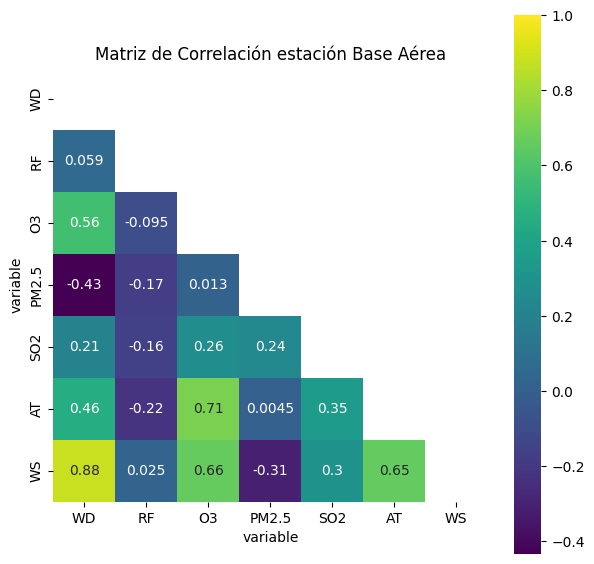

In [29]:
import seaborn as sns
import pandas as pd

df_cor_b_a = df_base_aerea.drop(columns=['fecha', 'estacion', 'BC', 'HR', 'P', 'PM10', 'RS', 'UV', 'AT_10_m', 'H2S'])

plt.figure(figsize = (7,7))
mask = np.triu(np.ones_like(df_cor_b_a.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_b_a.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Base Aérea')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `O3` (0.71): Sugiere que las temperaturas más altas están asociadas con un aumento en los niveles de ozono.
* `WS` y `WD` (0.88): Esta alta correlación indica que hay una relación significativa entre la velocidad del viento y la dirección del viento. Esto podría deberse a patrones meteorológicos donde ciertos rangos de dirección del viento coinciden con velocidades de viento más altas o viceversa. 

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `O3` y `WD` (0.56): Esto sugiere que los niveles de ozono pueden variar de manera consistente con ciertos cambios en la dirección del viento. Sin embargo, es importante aclarar que la dirección del viento es una variable circular, lo que significa que esta relación no implica que un cambio en la dirección (en grados) cause directamente un cambio en los niveles de ozono.
* `WS` y `AT` (0.65): Sugiere que al aumentar la velocidad del viento, la temperatura ambiente aumenta.

Este análisis resalta las relaciones significativas entre las variables meteorológicas y la calidad del aire, proporcionando información valiosa sobre cómo las condiciones ambientales pueden influir en los niveles de contaminación. Sin embargo, no se disponen de registros relacionados con la medición de `PM10`. Por lo tanto, esta estación `no es adecuada para incluirla en nuestro análisis`.

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [30]:
# Skew for each attribute
df_c_base.skew()

variable
BC             NaN
WD          0.5090
H2S            NaN
HR             NaN
RF         20.4741
O3          1.6854
PM10           NaN
PM2.5       1.5411
P              NaN
RS             NaN
SO2         2.4844
AT          0.3301
AT_10_m        NaN
UV             NaN
WS          1.4390
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **RF**:  20.4741
* **O3**: 1.6854
* **PM2.5**: 1.5411
* **WS**: 1.4390
* **SO2**: 2.4844

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):

* **WD**: 0.5090
* **AT**:  0.3301


#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

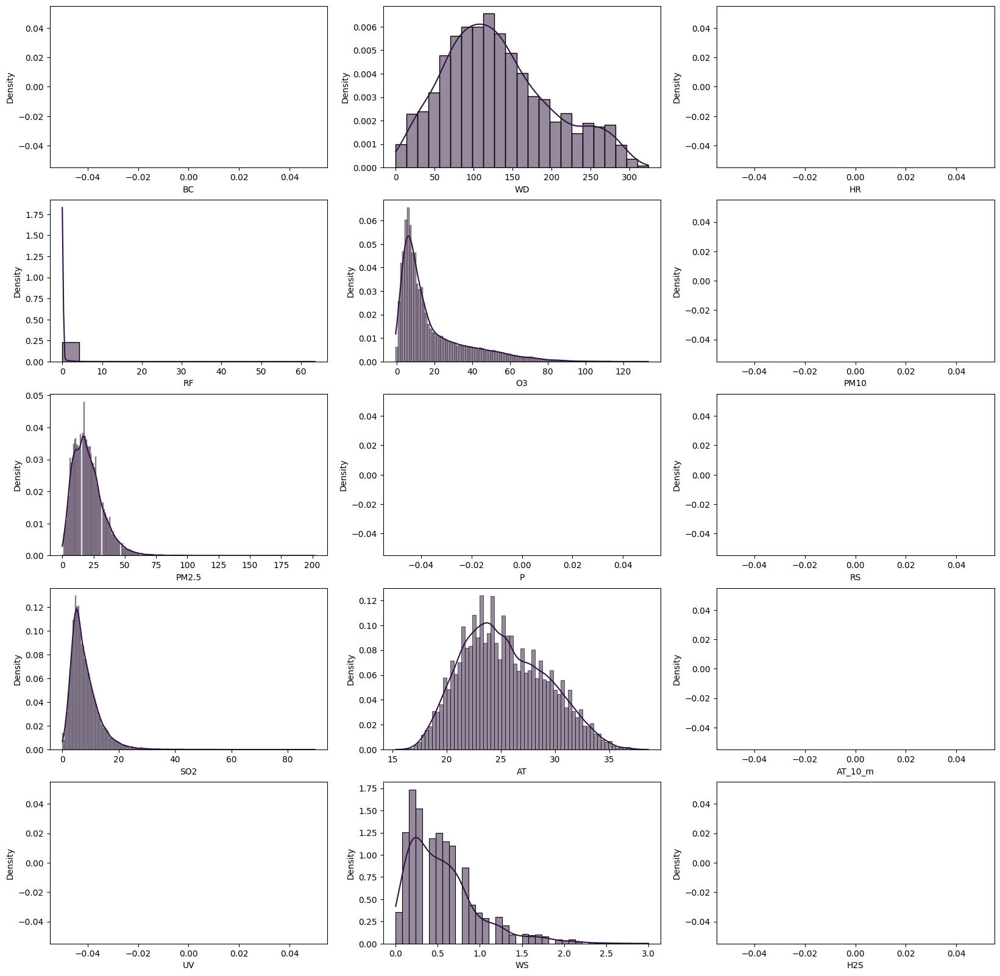

In [31]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_base_aerea["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

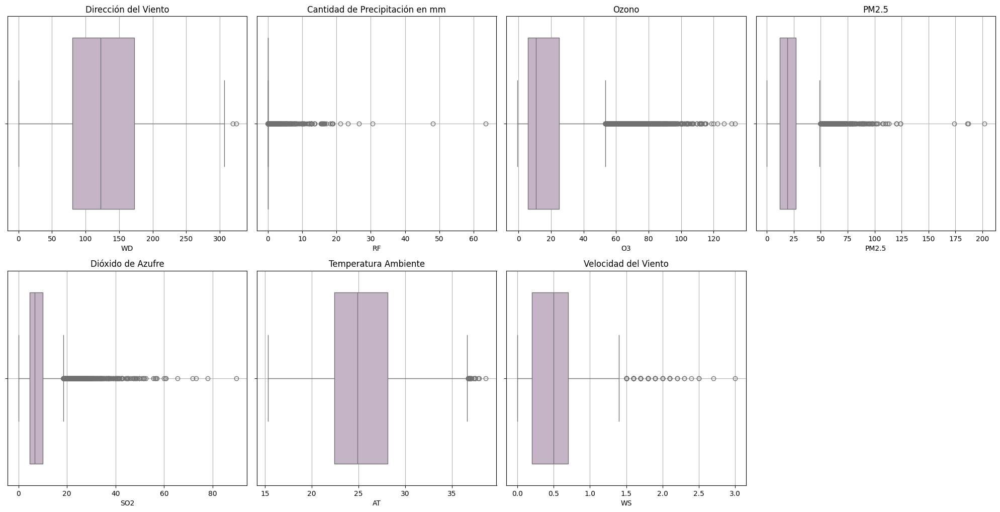

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para WD
plt.subplot(4, 4, 1)
sns.boxplot(x=df_base_aerea["WD"], color="#c6b1c9") 
plt.title('Dirección del Viento')
plt.grid(True)

# Subplot para RF
plt.subplot(4, 4, 2)
sns.boxplot(x=df_base_aerea["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)

# Subplot para O3
plt.subplot(4, 4, 3)
sns.boxplot(x=df_base_aerea["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 4)
sns.boxplot(x=df_base_aerea["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para SO2
plt.subplot(4, 4, 5)
sns.boxplot(x=df_base_aerea["SO2"], color="#c6b1c9") 
plt.title('Dióxido de Azufre')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 6)
sns.boxplot(x=df_base_aerea["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Subplot para WS
plt.subplot(4, 4, 7)
sns.boxplot(x=df_base_aerea["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)

# Mostrar los gráficos
plt.tight_layout()
plt.show()




A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

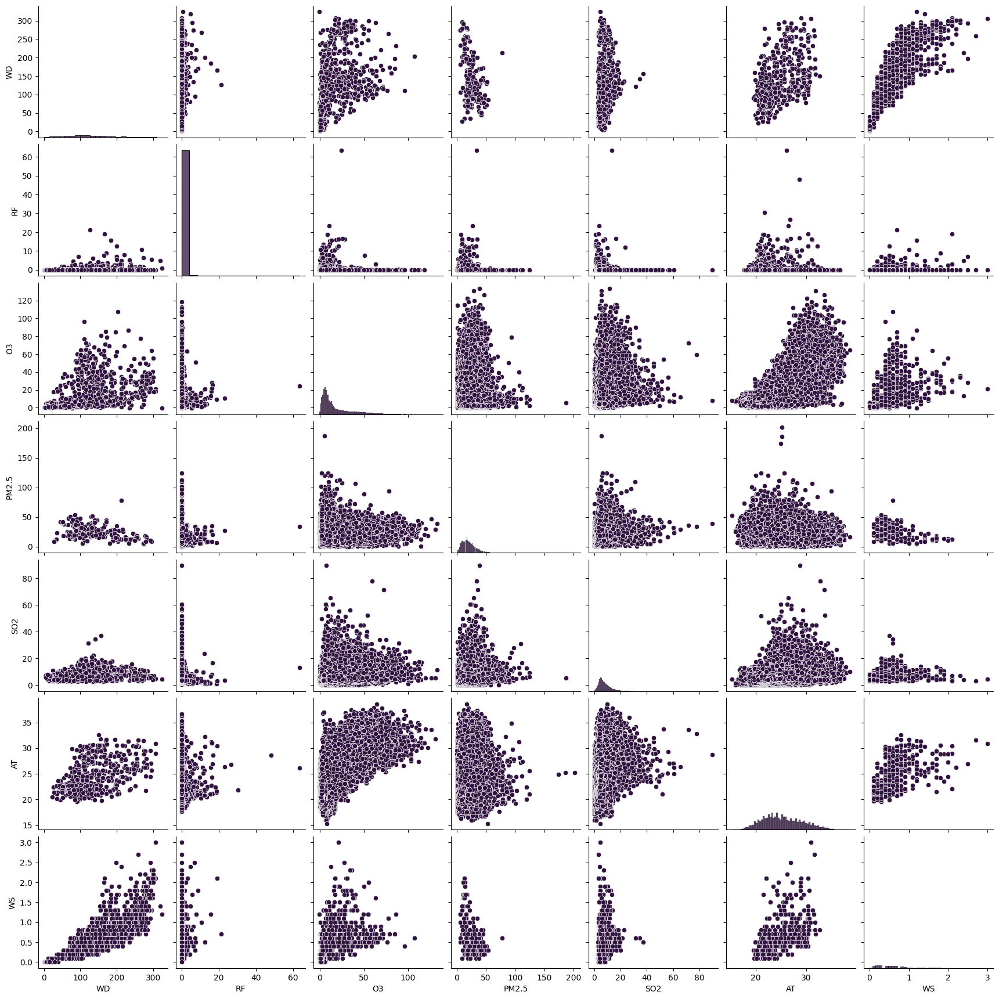

In [33]:
import seaborn as sns
# Eliminar las columnas 'fecha' y 'estacion'
df_cor_b_a = df_base_aerea.drop(columns=['fecha', 'estacion', 'BC', 'HR', 'P', 'PM10', 'RS', 'UV', 'AT_10_m', 'H2S'])

sns.pairplot(df_cor_b_a,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

### <font color="#30143"> Estación Canaveralejo</font>

A continuación visualizamos los datos correspondientes a la estación `Canaveralejo`a tráves de la función `head()`

In [34]:
df_canaveralejo = df_t[df_t['estacion'] == 'canaveralejo']
df_canaveralejo.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
1,2017-01-01 00:59:59+00:00,canaveralejo,NaN,NaN,NaN,NaN,NaN,NaN,51.7,NaN,NaN,NaN,0.3143,NaN,NaN,NaN,NaN
10,2017-01-01 01:59:59+00:00,canaveralejo,NaN,NaN,NaN,NaN,NaN,NaN,169.4,NaN,NaN,NaN,0.4452,NaN,NaN,NaN,NaN
19,2017-01-01 02:59:59+00:00,canaveralejo,NaN,NaN,NaN,NaN,NaN,NaN,98.6,NaN,NaN,NaN,0.2881,NaN,NaN,NaN,NaN
28,2017-01-01 03:59:59+00:00,canaveralejo,NaN,NaN,NaN,NaN,NaN,NaN,82.9,NaN,NaN,NaN,0.1571,NaN,NaN,NaN,NaN
37,2017-01-01 04:59:59+00:00,canaveralejo,NaN,NaN,NaN,NaN,NaN,NaN,94.7,NaN,NaN,NaN,0.1048,NaN,NaN,NaN,NaN


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [35]:
pd.set_option('display.precision', 2)
df_canaveralejo.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,32444.00,0.0,29698.00,24413.00,0.0,31087.00,10508.00,21597.00,17758.00,30340.00,29695.00,0.0,0.0,32437.00
mean,NaN,202.32,NaN,74.50,0.22,NaN,35.75,12.45,903.04,286.96,1.28,24.40,NaN,NaN,1.47
std,NaN,74.21,NaN,14.59,2.14,NaN,19.07,7.72,2.16,376.48,1.63,3.08,NaN,NaN,1.25
min,NaN,13.30,NaN,23.50,0.00,NaN,0.00,0.43,894.00,0.00,0.00,16.40,NaN,NaN,0.10
25%,NaN,143.30,NaN,61.90,0.00,NaN,21.70,7.56,902.00,2.88,0.13,21.80,NaN,NaN,0.70
50%,NaN,201.10,NaN,75.50,0.00,NaN,32.90,11.14,903.00,14.87,0.84,24.00,NaN,NaN,1.00
75%,NaN,260.70,NaN,86.60,0.00,NaN,46.50,15.73,904.80,569.00,1.81,26.80,NaN,NaN,1.50
max,NaN,349.20,NaN,100.00,156.00,NaN,208.00,153.70,909.00,1042.91,33.76,35.60,NaN,NaN,8.10


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados:  
* **BC (Carbono Negro)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **WD (Dirección del Viento)**: Total de observaciones: $32,444$, media: $202.32°$, desviación estándar: $74.21°$, mínimo: $13.30°$, máximo: $349.20°$. La dirección del viento tiene una distribución amplia que abarca casi todo el rango posible de dirección, sugiriendo una variabilidad significativa en la orientación del viento.

* **HR (Humedad Relativa)**: Total de observaciones: $29,698$, media: $74.50%$, desviación estándar: $14.59%$, mínimo: $23.50%$, máximo: $100%$. La humedad relativa muestra una variabilidad moderada, centrada alrededor de la media, lo cual podría indicar condiciones ambientales fluctuantes pero con predominancia de niveles altos de humedad.

* **RF (Precipitación)**: Total de observaciones: $24,413$, media: $0.22 mm$, desviación estándar: $2.14 mm$, mínimo: $0.00 mm$, máximo: $156.00 mm$. La precipitación tiene una distribución con valores bajos en su mayoría, pero presenta algunos eventos de lluvia intensa que generan una distribución sesgada a la derecha.

* **O3 (Ozono)**: No se cuentan con registros de ozono en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **PM10**: Total de observaciones: $31,087$, media: $35.75 \frac{\mu g}{m^3}$, desviación estándar: $19.07 \frac{\mu g}{m^3}$, mínimo: $0 \frac{\mu g}{m^3}$, máximo: $208.00 \frac{\mu g}{m^3}$. La distribución es amplia y presenta un sesgo a la derecha, lo cual puede ser indicativo de condiciones ambientales variables en términos de emisión de PM10.

* **PM2.5**: Total de observaciones: $10,508$, media: $12.45 \frac{\mu g}{m^3}$, desviación estándar: $7.72 \frac{\mu g}{m^3}$, mínimo: $0.43 \frac{\mu g}{m^3}$, máximo: $153.70 \frac{\mu g}{m^3}$. La distribución presenta un sesgo a la derecha, lo cual sugiere que, aunque la mayoría de las mediciones son bajas, existen algunas observaciones con niveles significativamente altos.

* **P (Presión Atmosférica)**: Total de observaciones: $21,597$, media: $903.04 \text{hPa}$, desviación estándar: $2.16 \text{hPa}$, mínimo: $894.00 \text{hPa}$, máximo: $909.00 \text{hPa}$. La presión atmosférica tiene una distribución estrecha con una variabilidad muy baja, lo que indica que las mediciones son bastante consistentes.

* **RS (Radiación Solar)**: Total de observaciones: $17,758$, media: $286.96 \frac{W}{m^2}$, desviación estándar: $376.48 \frac{W}{m^2}$, mínimo: $0 \frac{W}{m^2}$, máximo: $1042.91 \frac{W}{m^2}$. La radiación solar muestra una gran variabilidad y una distribución sesgada a la derecha, sugiriendo fluctuaciones significativas en la intensidad solar durante los periodos de medición.

* **SO2 (Dióxido de Azufre)**: Total de observaciones: $30,340$, media: $1.28 \frac{\mu g}{m^3}$, desviación estándar: $1.63 \frac{\mu g}{m^3}$, mínimo: $0 \frac{\mu g}{m^3}$, máximo: $33.76 \frac{\mu g}{m^3}$. La mayoría de las mediciones de SO2 son bajas, con algunos valores extremos que podrían estar asociados a eventos de alta contaminación.

* **AT (Temperatura del Aire)**: Total de observaciones: $29,695$, media: $24.40°\text{C}$, desviación estándar: $3.08°\text{C}$, mínimo: $16.40°\text{C}$, máximo: $35.60°\text{C}$. La temperatura del aire muestra una variabilidad moderada, centrada en un rango típico para climas templados a cálidos.

* **AT_10_m (Temperatura del Aire a 10 metros)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **UV (Índice UV)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **WS (Velocidad del Viento)**: Total de observaciones: $32,437$, media: $1.47 \frac{m}{s}$, desviación estándar: $1.25 \frac{m}{s}$, mínimo: $0.10 \frac{m}{s}$, máximo: $8.10 \frac{m}{s}$. La velocidad del viento tiene una distribución relativamente estrecha con algunos valores máximos que pueden indicar ráfagas esporádicas.

#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `base aérea`

In [36]:
df_canaveralejo.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 1 to 473248
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        32444 non-null  float64            
 4   H2S       0 non-null      float64            
 5   HR        29698 non-null  float64            
 6   RF        24413 non-null  float64            
 7   O3        0 non-null      float64            
 8   PM10      31087 non-null  float64            
 9   PM2.5     10508 non-null  float64            
 10  P         21597 non-null  float64            
 11  RS        17758 non-null  float64            
 12  SO2       30340 non-null  float64            
 13  AT        29695 non-null  float64            
 14  AT_10_m   0 non-null      float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [37]:
data_missing_canaveralejo = data_missing(df_t, 'estacion', 'canaveralejo')
data_missing_canaveralejo

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,20140,38.30
H2S,52584,100.00
HR,22886,43.52
RF,28171,53.57
O3,52584,100.00
PM10,21497,40.88
PM2.5,42076,80.02
P,30987,58.93


#### <font color="#30143"> Correlación entre características</font>

In [38]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_canaveralejo = df_canaveralejo.drop(columns=['fecha', 'estacion'])
correlations_c = df_c_canaveralejo.corr(method = 'spearman')
correlations_c

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,1.0000,NaN,-0.1153,-0.0805,NaN,-0.2724,-0.3524,-0.3737,-0.2950,-0.2269,0.0099,NaN,NaN,0.3563
H2S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HR,NaN,-0.1153,NaN,1.0000,0.3143,NaN,-0.1157,0.0518,0.5239,-0.5259,-0.0324,-0.9419,NaN,NaN,-0.6815
RF,NaN,-0.0805,NaN,0.3143,1.0000,NaN,-0.1361,-0.1371,0.1086,-0.1116,0.0423,-0.2648,NaN,NaN,-0.0445
O3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PM10,NaN,-0.2724,NaN,-0.1157,-0.1361,NaN,1.0000,0.6218,0.0719,0.2397,0.2457,0.1543,NaN,NaN,-0.1133
PM2.5,NaN,-0.3524,NaN,0.0518,-0.1371,NaN,0.6218,1.0000,0.1566,0.1710,0.1007,0.0229,NaN,NaN,-0.3113
P,NaN,-0.3737,NaN,0.5239,0.1086,NaN,0.0719,0.1566,1.0000,-0.0689,0.1528,-0.5173,NaN,NaN,-0.4801


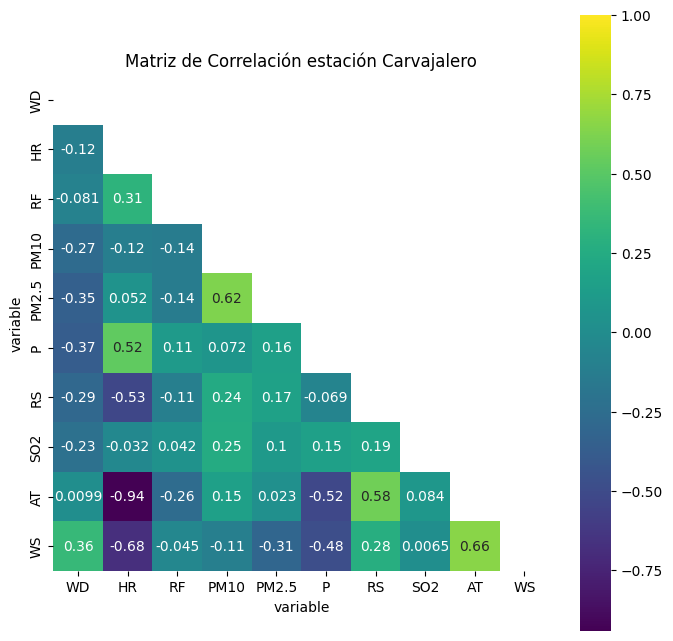

In [39]:
import seaborn as sns
import pandas as pd

df_cor_canaveralejo = df_canaveralejo.drop(columns=['fecha', 'estacion', 'BC','UV', 'AT_10_m', 'O3', 'H2S'])

plt.figure(figsize = (8,8))
mask = np.triu(np.ones_like(df_cor_canaveralejo.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_canaveralejo.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Carvajalero')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.94): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.
* `AT` y `O3` (0.78): Sugiere que las temperaturas más altas están asociadas con un aumento en los niveles de ozono.
* `HR` y `O3` (-0.78): Indica que niveles más altos de humedad relativa están relacionados con una disminución en los niveles de ozono.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `WS` y `HR` (-0.52): Sugiere que al aumentar la velocidad del viento, los niveles de humedad relativa disminuyen.
* `O3` y `RS` (0.61): Indica que un aumento en el ozono está asociado con un incremento en la radiación solar.
* `PM2.5` y `PM10` (0.70): Muestra que las concentraciones de estas partículas están estrechamente relacionadas, posiblemente por fuentes comunes o condiciones ambientales.
* `WS` y `AT` (0.66): Indica que un aumento en la velocidad del viento está asociado con un incremento en la temperatura ambiente.
* `AT` y `RS` (0.58): Indica que un aumento en la temperatura ambiente está asociado con un incremento en la radiación solar.
* `P` y `HR` (0.52): Indica que un aumento en presión barométrica está asociado con un incremento en la humedad relativa. 


Este análisis resalta las relaciones significativas entre las variables meteorológicas y la calidad del aire, proporcionando información valiosa sobre cómo las condiciones ambientales pueden influir en los niveles de contaminación. Sin embargo, se observó que aparentemente ninguna de las características meteorológicas tiene una influencia fuerte en los niveles de `PM10`. Esto sugiere que el PM10 podría ser el resultado de una fuente de generación adicional.

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [40]:
# Skew for each attribute
df_c_canaveralejo.skew()

variable
BC             NaN
WD          0.0405
H2S            NaN
HR         -0.1229
RF         28.9832
O3             NaN
PM10        1.0507
PM2.5       2.6770
P          -0.3558
RS          0.9258
SO2         3.8281
AT          0.3902
AT_10_m        NaN
UV             NaN
WS          1.9522
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **RF**: 28.9832
* **PM10**: 1.0507
* **PM2.5**: 2.6770
* **RS**: 0.9258
* **WS**: 1.9522
* **SO2**: 3.8281

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):

* **WD**: 0.0405
* **HR**: -0.1229
* **P**: -0.3558
* **AT**: 0.3902


#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

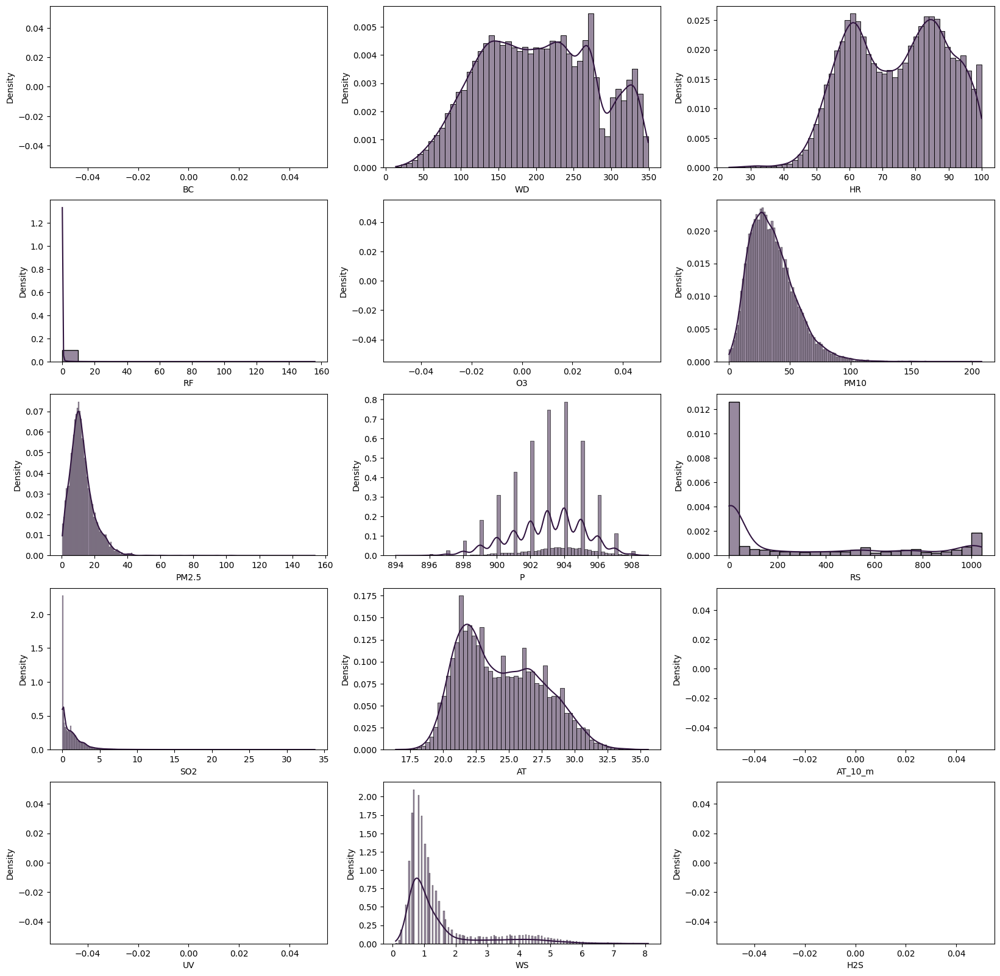

In [41]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_canaveralejo["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_canaveralejo["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

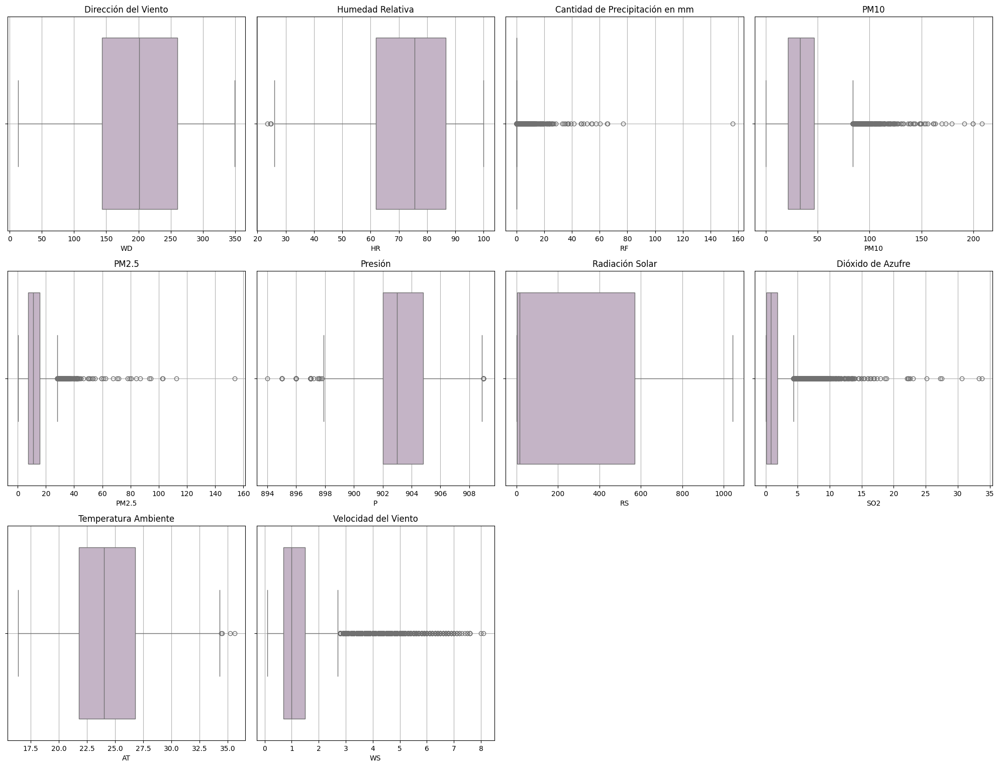

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para WD
plt.subplot(4, 4, 1)
sns.boxplot(x=df_canaveralejo["WD"], color="#c6b1c9") 
plt.title('Dirección del Viento')
plt.grid(True)

# Subplot para HR
plt.subplot(4, 4, 2)
sns.boxplot(x=df_canaveralejo["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para RF
plt.subplot(4, 4, 3)
sns.boxplot(x=df_canaveralejo["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)

# Subplot para PM10
plt.subplot(4, 4, 4)
sns.boxplot(x=df_canaveralejo["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)  # Se agregó el paréntesis de cierre aquí

# Subplot para PM2.5
plt.subplot(4, 4, 5)
sns.boxplot(x=df_canaveralejo["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 6)
sns.boxplot(x=df_canaveralejo["P"], color="#c6b1c9") 
plt.title('Presión')
plt.grid(True)

# Subplot para RS
plt.subplot(4, 4, 7)
sns.boxplot(x=df_canaveralejo["RS"], color="#c6b1c9") 
plt.title('Radiación Solar')
plt.grid(True)

# Subplot para SO2
plt.subplot(4, 4, 8)
sns.boxplot(x=df_canaveralejo["SO2"], color="#c6b1c9") 
plt.title('Dióxido de Azufre')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 9)
sns.boxplot(x=df_canaveralejo["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Subplot para WS
plt.subplot(4, 4, 10)
sns.boxplot(x=df_canaveralejo["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)

# Mostrar los gráficos
plt.tight_layout()
plt.show()




A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

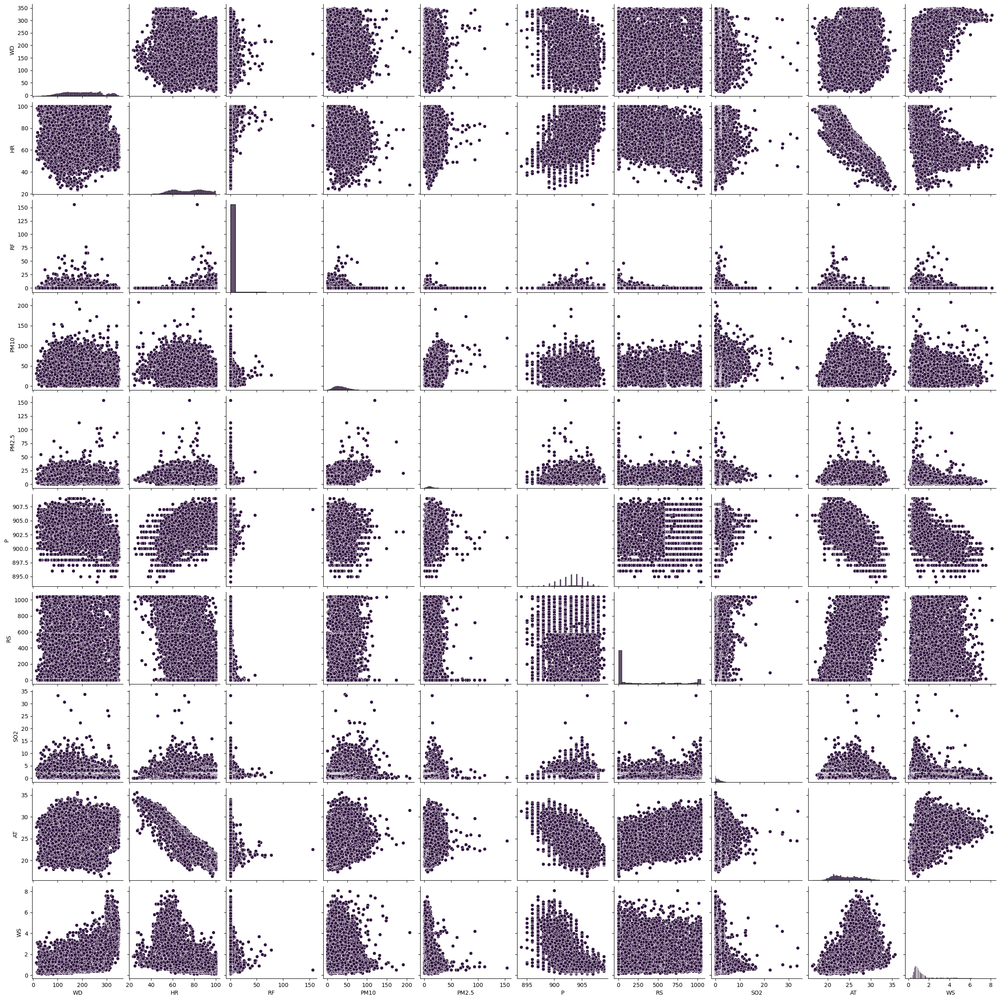

In [43]:
import seaborn as sns
sns.pairplot(df_cor_canaveralejo,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

### <font color="#30143"> Estación Compartir </font>

A continuación visualizamos los datos correspondientes a la estación `Compartir`a tráves de la función `head()`

In [44]:
df_compartir = df_t[df_t['estacion'] == 'compartir']
df_compartir.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
2,2017-01-01 00:59:59+00:00,compartir,NaN,208.6,NaN,75.9,0.0,8.4563,221.0,161.0,680.5,0.0,NaN,25.3,NaN,NaN,1.4
11,2017-01-01 01:59:59+00:00,compartir,NaN,65.2,NaN,77.3,0.0,8.2404,229.0,147.0,680.0,0.0,NaN,25.0,NaN,NaN,0.8
20,2017-01-01 02:59:59+00:00,compartir,NaN,86.8,NaN,77.6,0.0,6.6512,136.0,78.0,679.5,0.0,NaN,24.6,NaN,NaN,1.4
29,2017-01-01 03:59:59+00:00,compartir,NaN,216.0,NaN,79.2,0.0,5.9841,101.0,46.0,679.5,0.0,NaN,24.1,NaN,NaN,1.5
38,2017-01-01 04:59:59+00:00,compartir,NaN,271.8,NaN,79.9,0.0,6.5139,90.0,54.0,679.8,0.0,NaN,24.1,NaN,NaN,1.9


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [45]:
pd.set_option('display.precision', 2)
df_compartir.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,49551.00,0.0,45533.00,49550.00,35142.00,38283.00,32780.00,49550.00,49395.00,0.0,49542.00,7175.00,0.0,49551.00
mean,NaN,196.39,NaN,60.91,0.20,28.39,50.27,14.50,801.18,150.44,NaN,28.35,24.40,NaN,2.30
std,NaN,103.47,NaN,15.78,1.81,26.43,25.42,10.19,113.29,212.75,NaN,3.74,3.24,NaN,1.34
min,NaN,0.00,NaN,12.80,0.00,0.82,0.00,0.00,27.70,0.00,NaN,19.30,17.90,NaN,0.00
25%,NaN,105.40,NaN,47.70,0.00,9.85,33.00,8.00,680.60,6.50,NaN,25.30,21.70,NaN,1.40
50%,NaN,218.70,NaN,62.70,0.00,16.24,47.00,13.00,903.60,19.00,NaN,27.30,23.50,NaN,2.10
75%,NaN,279.40,NaN,72.20,0.00,40.80,63.00,19.00,907.50,248.90,NaN,31.50,27.10,NaN,3.00
max,NaN,360.00,NaN,100.00,90.42,159.16,420.00,388.00,913.20,1000.30,NaN,40.20,33.00,NaN,12.70


A continuación se realiza un análisis detallado para cada una de las características del conjunto de datos: 

* **BC (Carbono Negro)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **WD (Dirección del Viento)**:Total de observaciones: $49,551$, media: $196.39°$, desviación estándar: $103.47°$, mínimo: $0°$, máximo: $360°$. La dirección del viento cubre todo el rango posible, sugiriendo alta variabilidad en las direcciones del viento.
  
* **H2S (Sulfuro de Hidrógeno)**:No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **HR (Humedad Relativa)**:Total de observaciones: $45,533$, media: $60.91\%$, desviación estándar: $15.78\%$, mínimo: $12.80\%$, máximo: $100.00\%$. La humedad relativa presenta una amplia gama de valores, indicando variabilidad en las condiciones atmosféricas. La media sugiere un entorno generalmente húmedo, mientras que la desviación estándar refleja fluctuaciones significativas, es posible que sea debido a la presencia de datos atípicos. 

* **RF (Precipitación)**: Total de observaciones: $49,550$, media: $0.20 mm$, desviación estándar: $1.81 mm$, mínimo: $0.00 mm$, máximo: $90.42 mm$, La mayoría de las mediciones de precipitación son bajas, con algunas ocurrencias de eventos de lluvia intensos. La desviación estándar alta indica que, aunque la precipitación es generalmente baja, puede haber eventos de lluvia significativos.
  
* **O3 (Ozono)**: Total de observaciones: $35,142$, media: $28.39\frac{\mu g}{m^3}$, desviación estándar: $26.43 \frac{\mu g}{m^3}$, mínimo: $0.82\frac{\mu g}{m^3}$, máximo: $159.16 \frac{\mu g}{m^3}$. La concentración de ozono muestra una alta variabilidad con un sesgo a la derecha, lo que sugiere que hay algunos valores extremadamente altos, posiblemente debido a condiciones ambientales que favorecen la formación de ozono.

* **PM10**: Total de observaciones: $38,283$, media: $50.27\frac{\mu g}{m^3}$, desviación estándar: $25.42 \frac{\mu g}{m^3}$, mínimo: $0.00\frac{\mu g}{m^3}$, máximo: $420.00\frac{\mu g}{m^3}$,  La distribución de PM10 muestra una considerable variabilidad con valores extremos altos, lo que indica la presencia de episodios de contaminación severa.

* **PM2.5**: Total de observaciones: $32,780$, media: $14.50\frac{\mu g}{m^3}$, desviación estándar: $10.19\frac{\mu g}{m^3}$, mínimo: $0.43\frac{\mu g}{m^3}$, máximo: $388.00\frac{\mu g}{m^3}$, La concentración de PM2.5 también muestra una alta variabilidad, con un sesgo hacia valores más altos, reflejando posibles episodios de alta contaminación.

* **P (Presión Atmosférica)**: Total de observaciones: $49,550$, media: $801.18\text{hPa}$, desviación estándar: $113.29  \text{hPa}$, mínimo: $27.70\text{hPa}$, máximo: $ 913.20 \text{hPa}$. La presión atmosférica presenta una amplia variabilidad con un rango extendido de valores. La desviación estándar indica que hay grandes fluctuaciones en las lecturas de presión atmosférica, debido a posible error en las mediciones y/o presencia de datos atípicos. 

* **RS (Radiación Solar)**: Total de observaciones: $49,395$, Media: $150.44  \frac{W}{m^2}$, Desviación estándar: $212.75 \frac{W}{m^2}$, Mínimo: $0.00 \frac{W}{m^2}$, máximo: $1000.30\frac{W}{m^2}$.La radiación solar tiene una alta variabilidad con una amplia gama de valores, sugiriendo que las condiciones de radiación solar pueden variar significativamente, posiblemente debido a la presencia de nubes. 

* **SO2 (Dióxido de Azufre)**:  No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **AT (Temperatura del Aire)**: Total de observaciones: $49,542$, media: $28.35°\text{C}$, desviación estándar: $3.74°\text{C}$, mínimo: $19.30°\text{C}$, máximo: $ 40.20°\text{C}$. La temperatura del aire muestra una media relativamente alta con una variabilidad moderada, lo que indica que la temperatura es generalmente cálida con algunos valores extremos.

* **AT_10_m (Temperatura del Aire a 10 metros)**: Total de observaciones: $7,175$, media: $24.40°\text{C}$, desviación estándar: $3.24°\text{C}$, mínimo: $17.90°\text{C}$, máximo: $ 33.00°\text{C}$.  La temperatura a 10 metros tiene una distribución similar a la temperatura del aire, con una media moderada y una variabilidad que sugiere condiciones de temperatura algo estables con algunas fluctuaciones.

* **UV (Índice UV)**:No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **WS (Velocidad del Viento)**: Total de observaciones: $49,551,$, media: $2.30\frac{m}{s}$, desviación estándar: $1.34 \frac{m}{s}$, mínimo: $0.00 \frac{m}{s}$, máximo: $12.70\frac{m}{s}$. La velocidad del viento muestra una media moderada con una alta desviación estándar, lo que indica una amplia gama de velocidades de viento, desde muy bajas hasta significativamente altas.


#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `Compartir`

In [46]:
df_compartir.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 2 to 473249
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        49551 non-null  float64            
 4   H2S       0 non-null      float64            
 5   HR        45533 non-null  float64            
 6   RF        49550 non-null  float64            
 7   O3        35142 non-null  float64            
 8   PM10      38283 non-null  float64            
 9   PM2.5     32780 non-null  float64            
 10  P         49550 non-null  float64            
 11  RS        49395 non-null  float64            
 12  SO2       0 non-null      float64            
 13  AT        49542 non-null  float64            
 14  AT_10_m   7175 non-null   float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [47]:
data_missing_compartir = data_missing(df_t, 'estacion', 'compartir')
data_missing_compartir

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,3033,5.77
H2S,52584,100.00
HR,7051,13.41
RF,3034,5.77
O3,17442,33.17
PM10,14301,27.20
PM2.5,19804,37.66
P,3034,5.77


#### <font color="#30143"> Correlación entre características</font>

In [48]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_compartir = df_compartir.drop(columns=['fecha', 'estacion'])
correlations_compartir = df_c_compartir.corr(method = 'spearman')
correlations_compartir

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,1.0000,NaN,-0.0010,-0.0370,-0.0866,0.0374,0.1229,0.0943,0.0351,NaN,-0.0185,0.1766,NaN,-0.1057
H2S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HR,NaN,-0.0010,NaN,1.0000,0.3077,-0.7816,-0.0605,-0.0212,0.4007,-0.5091,NaN,-0.8893,-0.9497,NaN,-0.5208
RF,NaN,-0.0370,NaN,0.3077,1.0000,-0.0984,-0.2877,-0.1365,0.0851,-0.1132,NaN,-0.2877,-0.3088,NaN,-0.0161
O3,NaN,-0.0866,NaN,-0.7816,-0.0984,1.0000,-0.1133,-0.0627,-0.2875,0.6155,NaN,0.7785,0.7936,NaN,0.4702
PM10,NaN,0.0374,NaN,-0.0605,-0.2877,-0.1133,1.0000,0.7036,0.0104,0.0469,NaN,0.0809,0.2251,NaN,-0.0814
PM2.5,NaN,0.1229,NaN,-0.0212,-0.1365,-0.0627,0.7036,1.0000,0.1352,0.1735,NaN,0.0530,0.1519,NaN,-0.1260
P,NaN,0.0943,NaN,0.4007,0.0851,-0.2875,0.0104,0.1352,1.0000,0.2077,NaN,-0.2536,-0.5007,NaN,-0.3222


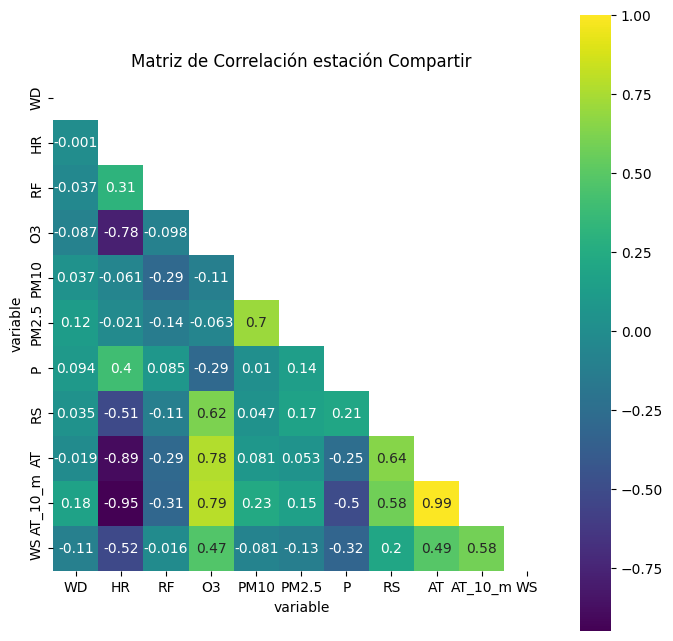

In [49]:
import seaborn as sns
import pandas as pd

df_cor_compartir = df_compartir.drop(columns=['fecha', 'estacion', 'BC','SO2', 'UV', 'H2S'])

plt.figure(figsize = (8,8))
mask = np.triu(np.ones_like(df_cor_compartir.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_compartir.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Compartir')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.89): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.
* `AT_10_m` y `HR` (-0.95): Refuerza la relación inversa entre temperatura y humedad.
* `AT` y `O3` (0.78): Sugiere que las temperaturas más altas están asociadas con un aumento en los niveles de ozono.
* `AT_10_m` y `O3` (0.84): Similar al anterior, mostrando una fuerte relación entre temperatura y ozono.
* `HR` y `O3` (-0.78): Indica que niveles más altos de humedad relativa están relacionados con una disminución en los niveles de ozono.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `WS` y `HR` (-0.52): Sugiere que al aumentar la velocidad del viento, los niveles de humedad relativa disminuyen.
* `O3` y `RS` (0.61): Indica que un aumento en el ozono está asociado con un incremento en la radiación solar.
* `PM2.5` y `PM10` (0.70): Muestra que las concentraciones de estas partículas están estrechamente relacionadas, posiblemente por fuentes comunes o condiciones ambientales.
* `P` y `AT_10_m` (-0.50): Sugiere que al disminuir la temperatura, la presión barométrica aumenta. En contraste, con `AT`, la correlación es -0.25, lo que indica que la presión también aumenta a mayor altura.
* `WS` y `AT_10_m` (0.52): Indica que al aumentar la velocidad del viento, la temperatura a 10 metros de altura también aumenta.

Este análisis resalta las relaciones significativas entre las variables meteorológicas y la calidad del aire, proporcionando información valiosa sobre cómo las condiciones ambientales pueden influir en los niveles de contaminación. Sin embargo, se observó que aparentemente ninguna de las características meteorológicas tiene una influencia fuerte en los niveles de `PM10`. Esto sugiere que el PM10 podría ser el resultado de una fuente de generación adicional. 

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. 

In [50]:
# Skew for each attribute
df_c_compartir.skew()

variable
BC             NaN
WD         -0.3130
H2S            NaN
HR         -0.0449
RF         18.6963
O3          1.4685
PM10        1.3306
PM2.5       5.3607
P          -0.1368
RS          1.5010
SO2            NaN
AT          0.4905
AT_10_m     0.4844
UV             NaN
WS          1.1840
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **RF**: 18.6963
* **O3**: 1.4685
* **PM10**: 1.3306
* **PM2.5**: 5.3607
* **RS**: 1.5010
* **WS**: 1.1840

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):

* **WD**: -0.3130
* **HR**: -0.0449
* **P**: -0.1368
* **AT**: 0.4905
* **AT_10_m**: 0.4844

####  <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

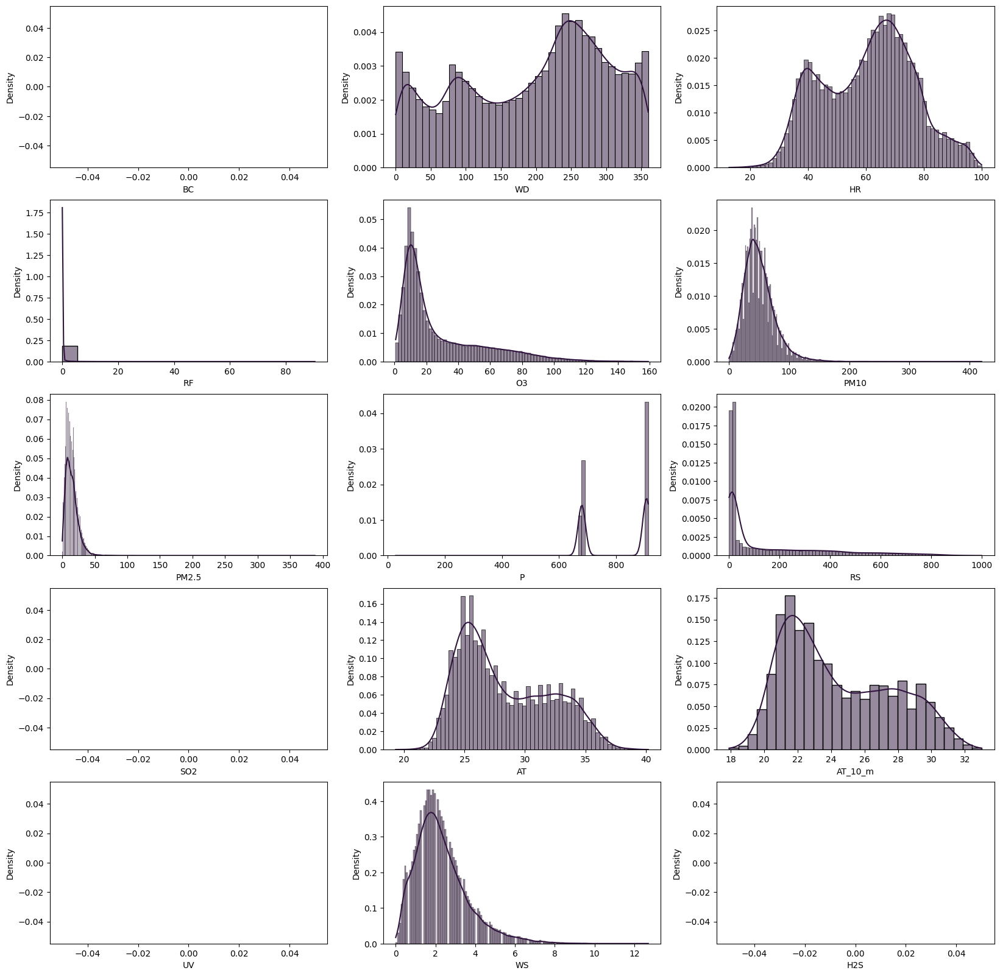

In [51]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_compartir["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_compartir["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

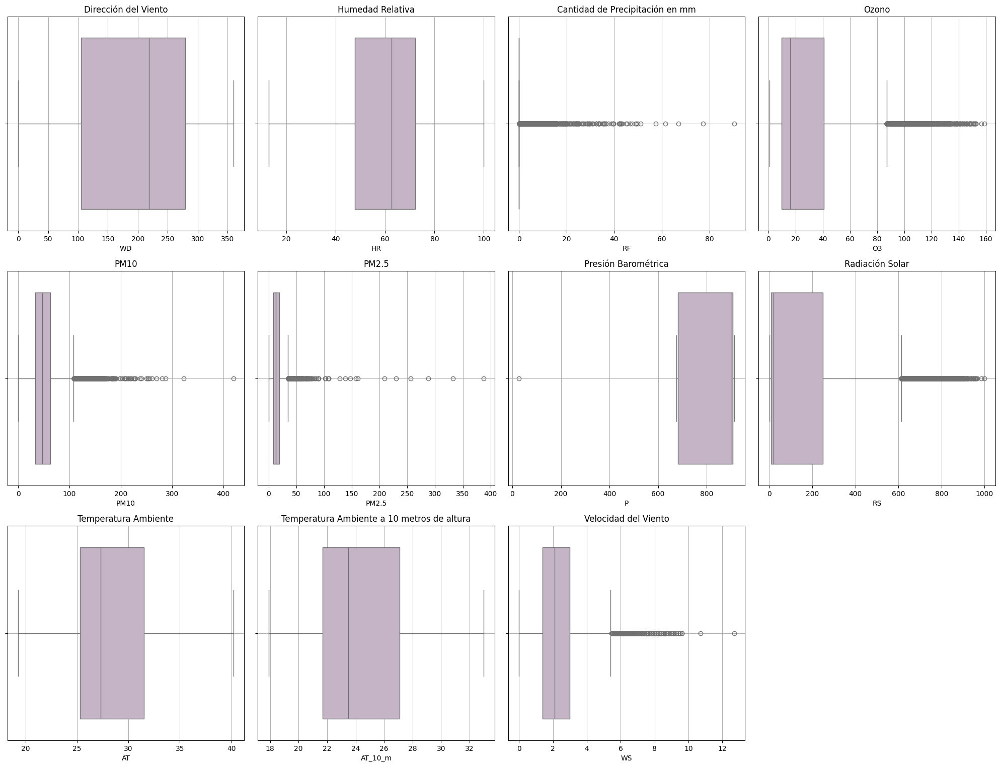

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para WD
plt.subplot(4, 4, 1)
sns.boxplot(x=df_compartir["WD"], color="#c6b1c9") 
plt.title('Dirección del Viento')
plt.grid(True)

# Subplot para HR
plt.subplot(4, 4, 2)
sns.boxplot(x=df_compartir["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para RF
plt.subplot(4, 4, 3)
sns.boxplot(x=df_compartir["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)

# Subplot para O3
plt.subplot(4, 4, 4)
sns.boxplot(x=df_compartir["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 5)
sns.boxplot(x=df_compartir["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 6)
sns.boxplot(x=df_compartir["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 7)
sns.boxplot(x=df_compartir["P"], color="#c6b1c9") 
plt.title('Presión Barométrica')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 8)
sns.boxplot(x=df_compartir["RS"], color="#c6b1c9") 
plt.title('Radiación Solar')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 9)
sns.boxplot(x=df_compartir["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Subplot para AT_10_m
plt.subplot(4, 4, 10)
sns.boxplot(x=df_compartir["AT_10_m"], color="#c6b1c9") 
plt.title('Temperatura Ambiente a 10 metros de altura')
plt.grid(True)

# Subplot para WS
plt.subplot(4, 4, 11)
sns.boxplot(x=df_compartir["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)

# Mostrar los gráficos
plt.tight_layout()
plt.show()

A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

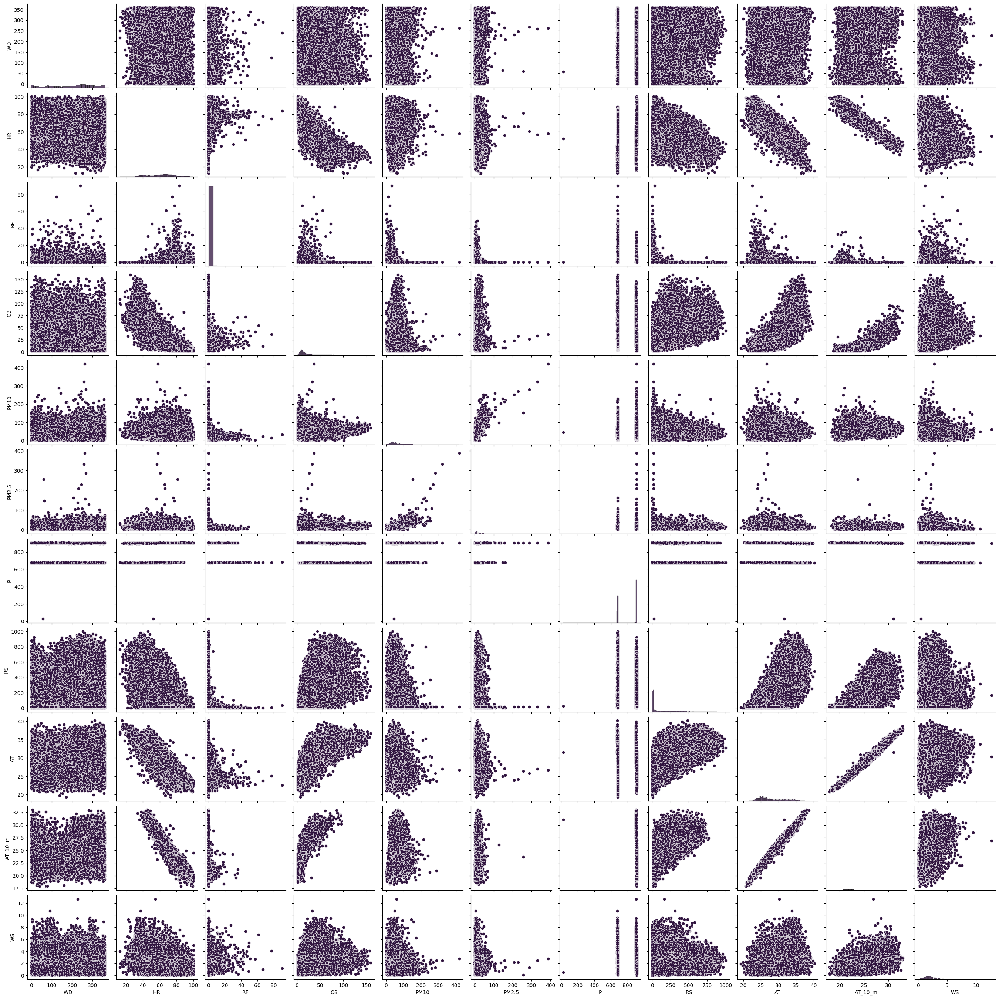

In [53]:
import seaborn as sns
# Eliminar las columnas 'fecha' y 'estacion'
sns.pairplot(df_cor_compartir,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

### <font color="#30143"> Estación Era Obrero </font>

A continuación visualizamos los datos correspondientes a la estación `Era Obrero`a tráves de la función `head()`

In [54]:
df_era_obrero = df_t[df_t['estacion'] == 'era_obrero']
df_era_obrero.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
3,2017-01-01 00:59:59+00:00,era_obrero,NaN,NaN,NaN,NaN,0.0,16.1473,195.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,2017-01-01 01:59:59+00:00,era_obrero,NaN,NaN,NaN,NaN,0.0,8.7702,183.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21,2017-01-01 02:59:59+00:00,era_obrero,NaN,NaN,NaN,NaN,0.0,8.7898,115.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
30,2017-01-01 03:59:59+00:00,era_obrero,NaN,NaN,NaN,NaN,0.0,12.3018,139.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39,2017-01-01 04:59:59+00:00,era_obrero,NaN,NaN,NaN,NaN,0.0,8.0442,130.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [55]:
pd.set_option('display.precision', 2)
df_era_obrero.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,30552.00,0.0,25197.00,50359.00,35093.00,35125.00,14491.00,25177.00,46782.00,0.0,16443.00,0.0,0.0,30552.0
mean,NaN,202.49,NaN,66.48,0.39,19.59,51.01,10.37,900.93,226.60,NaN,26.34,NaN,NaN,1.3
std,NaN,94.60,NaN,13.76,3.21,23.30,30.64,7.51,3.37,275.96,NaN,3.39,NaN,NaN,1.0
min,NaN,0.00,NaN,21.60,0.00,0.00,0.00,0.43,888.60,0.00,NaN,18.70,NaN,NaN,0.0
25%,NaN,121.80,NaN,55.40,0.00,4.06,28.60,4.76,898.70,0.00,NaN,23.60,NaN,NaN,0.6
50%,NaN,199.25,NaN,66.60,0.00,10.05,45.80,8.99,900.80,10.00,NaN,25.70,NaN,NaN,1.0
75%,NaN,298.80,NaN,77.40,0.00,25.41,67.70,14.07,903.10,566.80,NaN,28.90,NaN,NaN,1.6
max,NaN,360.00,NaN,98.50,156.97,290.44,383.40,82.31,910.90,670.90,NaN,37.50,NaN,NaN,7.0


A continuación se realiza un análisis detallado para cada una de las características del conjunto de datos: 

* **BC (Carbono Negro)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **WD (Dirección del Viento)**:Total de observaciones: $30,552$, media: $202.49°$, desviación estándar: $94.60°$, mínimo: $0°$, máximo: $360°$. La dirección del viento cubre todo el rango posible, sugiriendo alta variabilidad en las direcciones del viento.
  
* **H2S (Sulfuro de Hidrógeno)**:No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **HR (Humedad Relativa)**:Total de observaciones: $25,197$, media: $66.48\%$, desviación estándar: $13.76\%$, mínimo: $21.60\%$, máximo: $98.50\%$
La humedad relativa muestra una distribución bastante amplia, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos de humedad. 

* **RF (Precipitación)**: Total de observaciones: $50,359$, media: $0.39 mm$, desviación estándar: $3.21 mm$, mínimo: $0.00 mm$, máximo: $156.97 mm$, La mayoría de las mediciones de precipitación son bajas, con algunos eventos de lluvia intensa.
  
* **O3 (Ozono)**: Total de observaciones: $35,093$, media: $19.59\frac{\mu g}{m^3}$, desviación estándar: $23.30\frac{\mu g}{m^3}$, mínimo: $0\frac{\mu g}{m^3}$, máximo: $290.44\frac{\mu g}{m^3}$. La distribución es amplia con un sesgo a la derecha debido a valores máximos altos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de $\text{O}_3$. 

* **PM10**: Total de observaciones: $35,125$, media: $51.01\frac{\mu g}{m^3}$, desviación estándar: $30.64\frac{\mu g}{m^3}$, mínimo: $0.00\frac{\mu g}{m^3}$, máximo: $383.40\frac{\mu g}{m^3}$, La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de PM10. 

* **PM2.5**: Total de observaciones: $14,491$, media: $10.37\frac{\mu g}{m^3}$, desviación estándar: $7.51\frac{\mu g}{m^3}$, mínimo: $0.43\frac{\mu g}{m^3}$, máximo: $82.31\frac{\mu g}{m^3}$, La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de PM2.5. 

* **P (Presión Atmosférica)**: Total de observaciones: $25,177$, media: $900.93 \text{hPa}$, desviación estándar: $3.37 \text{hPa}$, mínimo: $888.60\text{hPa}$, máximo: $910.90 \text{hPa}$. En cuanto a la distribución de los datos se observa quela mayoría de las mediciones de presión atmosférica se encuentran muy cercanas a la media y los datos siguen una distribución normal. 

* **RS (Radiación Solar)**: Total de observaciones: $46,782$, Media: $226.60 \frac{W}{m^2}$, Desviación estándar: $275.96 \frac{W}{m^2}$, Mínimo: $0.00 \frac{W}{m^2}$, máximo: $670.90\frac{W}{m^2}$: La radiación solar tiene una distribución amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos Radiación Solar. 

* **SO2 (Dióxido de Azufre)**:  No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **AT (Temperatura del Aire)**: Total de observaciones: $16,443$, media: $26.34°\text{C}$, desviación estándar: $3.39°\text{C}$, mínimo: $18.70°\text{C}$, máximo: $37.50°\text{C}$. La temperatura del aire tiene una distribución se encuentran muy cercanas a la media, lo que indica una variabilidad mínima, pero con algunos valores extremos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos Temperatura del aire. 

* **AT_10_m (Temperatura del Aire a 10 metros)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **UV (Índice UV)**:No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **WS (Velocidad del Viento)**: Total de observaciones: $30,552$, media: $1.3 \frac{m}{s}$, desviación estándar: $1.0 \frac{m}{s}$, mínimo: $0.00 \frac{m}{s}$, máximo: $7 \frac{m}{s}$, indicando que las velocidades de viento en el área son generalmente bajas a moderadas. 




#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `Era Obrero`

In [56]:
df_era_obrero.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 3 to 473250
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        30552 non-null  float64            
 4   H2S       0 non-null      float64            
 5   HR        25197 non-null  float64            
 6   RF        50359 non-null  float64            
 7   O3        35093 non-null  float64            
 8   PM10      35125 non-null  float64            
 9   PM2.5     14491 non-null  float64            
 10  P         25177 non-null  float64            
 11  RS        46782 non-null  float64            
 12  SO2       0 non-null      float64            
 13  AT        16443 non-null  float64            
 14  AT_10_m   0 non-null      float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [57]:
data_missing_era_obrero = data_missing(df_t, 'estacion', 'era_obrero')
data_missing_era_obrero

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,22032,41.90
H2S,52584,100.00
HR,27387,52.08
RF,2225,4.23
O3,17491,33.26
PM10,17459,33.20
PM2.5,38093,72.44
P,27407,52.12


#### <font color="#30143"> Correlación entre características</font>

In [58]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_era_obrero = df_era_obrero.drop(columns=['fecha', 'estacion'])
correlations_era_obrero = df_c_era_obrero.corr(method = 'spearman')
correlations_era_obrero

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,1.0000,NaN,-0.1594,-0.0333,0.0524,-0.3047,-0.3964,-0.1980,-0.1977,NaN,0.0771,NaN,NaN,0.4124
H2S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HR,NaN,-0.1594,NaN,1.0000,0.3627,-0.8233,-0.1945,0.0956,0.3983,-0.5899,NaN,-0.9493,NaN,NaN,-0.4497
RF,NaN,-0.0333,NaN,0.3627,1.0000,-0.1616,-0.2189,-0.0733,0.1218,-0.1255,NaN,-0.2978,NaN,NaN,-0.0332
O3,NaN,0.0524,NaN,-0.8233,-0.1616,1.0000,0.1406,-0.0146,-0.2185,0.6288,NaN,0.8317,NaN,NaN,0.4113
PM10,NaN,-0.3047,NaN,-0.1945,-0.2189,0.1406,1.0000,0.4365,0.0521,0.4725,NaN,0.2077,NaN,NaN,-0.1592
PM2.5,NaN,-0.3964,NaN,0.0956,-0.0733,-0.0146,0.4365,1.0000,0.4403,0.2286,NaN,0.0038,NaN,NaN,-0.3436
P,NaN,-0.1980,NaN,0.3983,0.1218,-0.2185,0.0521,0.4403,1.0000,-0.0086,NaN,-0.4547,NaN,NaN,-0.3034


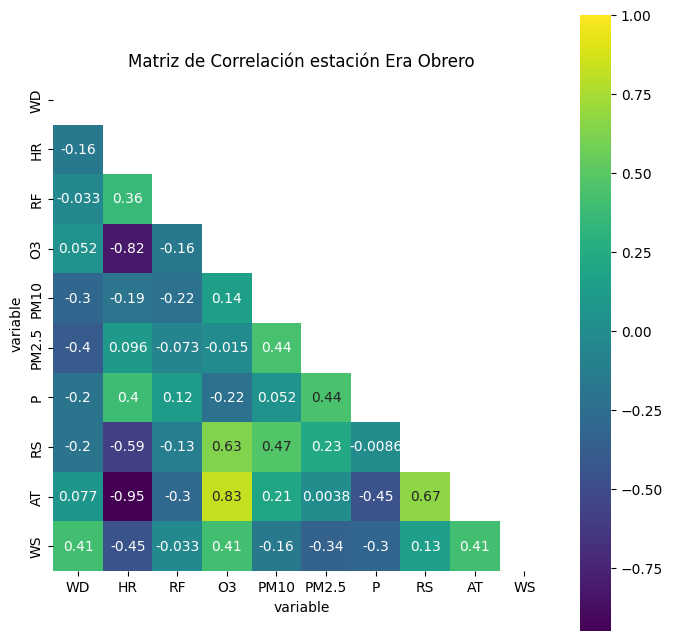

In [59]:
# Eliminar las columnas 'fecha' y 'estacion'
df_cor_obrero = df_era_obrero.drop(columns=['fecha', 'estacion', 'BC', 'SO2', 'UV', 'AT_10_m', 'H2S'])

plt.figure(figsize = (8,8))
mask = np.triu(np.ones_like(df_cor_obrero.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_obrero.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Era Obrero')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.95): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.
* `AT` y `O3` (0.83): Sugiere que las temperaturas más altas están asociadas con un aumento en los niveles de ozono.
* `HR` y `O3` (-0.82): Indica que niveles más altos de humedad relativa están relacionados con una disminución en los niveles de ozono.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `AT` y `RS` (0.67): Indica que un aumento en la temperatura ambiente está asociado con un incremento en la radiación solar.
* `HR` y `RS` (-0.59): Indica que porcentajes más altos de humedad relativa estás asociado con una disminución en la radiación solar.
* `RS` y `O3` (0.63): Indica que un incremento en la radiación solar está asociado con un incremento en la concentración de ozono.

Este análisis resalta las relaciones significativas entre las variables meteorológicas y la calidad del aire, proporcionando información valiosa sobre cómo las condiciones ambientales pueden influir en los niveles de contaminación. Sin embargo, se observó que aparentemente ninguna de las características meteorológicas tiene una influencia fuerte en los niveles de `PM10`. Esto sugiere que el PM10 podría ser el resultado de una fuente de generación adicional. 

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [60]:
# Skew for each attribute
df_c_era_obrero.skew()

variable
BC             NaN
WD         -0.0550
H2S            NaN
HR         -0.0317
RF         16.7823
O3          1.9929
PM10        1.3842
PM2.5       1.3388
P           0.1104
RS          0.6063
SO2            NaN
AT          0.4967
AT_10_m        NaN
UV             NaN
WS          1.6126
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **RF**: 16.7823
* **O3**: 1.9929
* **PM10**: 1.3842
* **PM2.5**: 1.3388
* **WS**: 1.6126

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):

* **RS**: 0.6063
* **P**: 0.1104
* **WD**: -0.0550
* **HR**: -0.0317
* **P**: -0.1368
* **AT**: 0.4967

#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

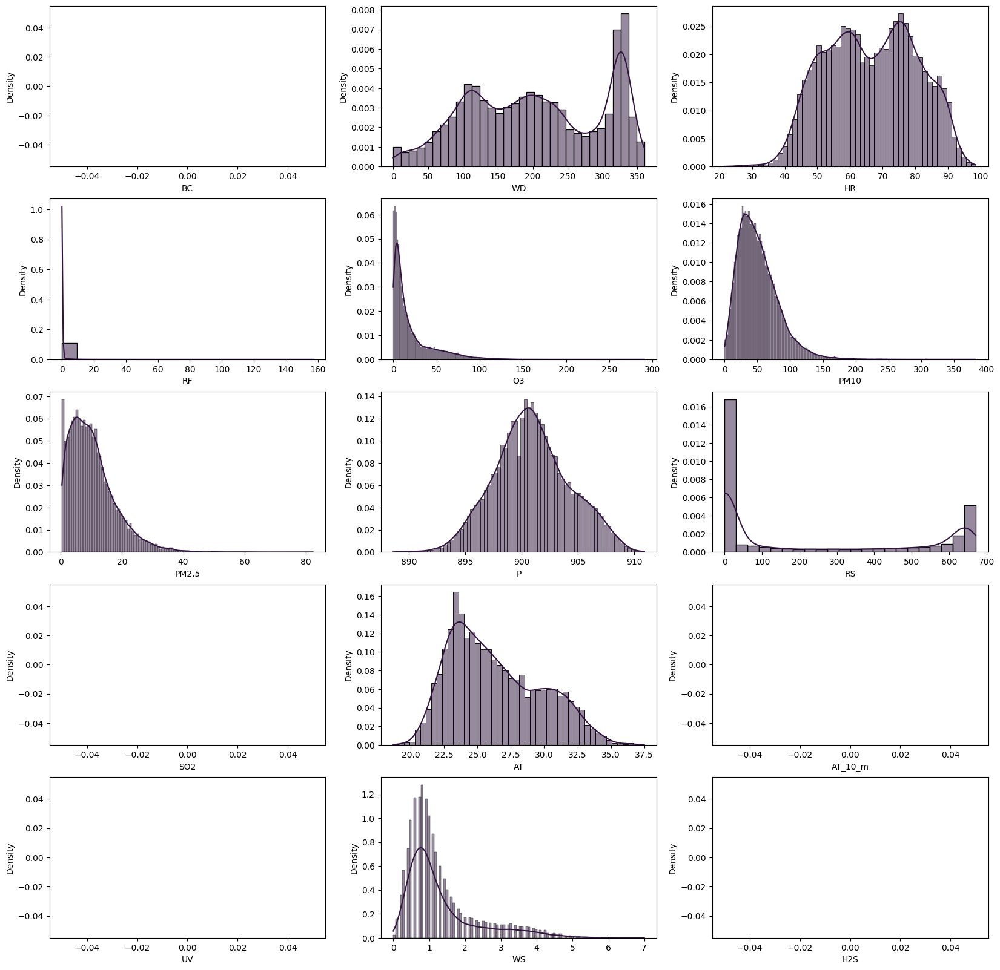

In [61]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_era_obrero["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_era_obrero["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

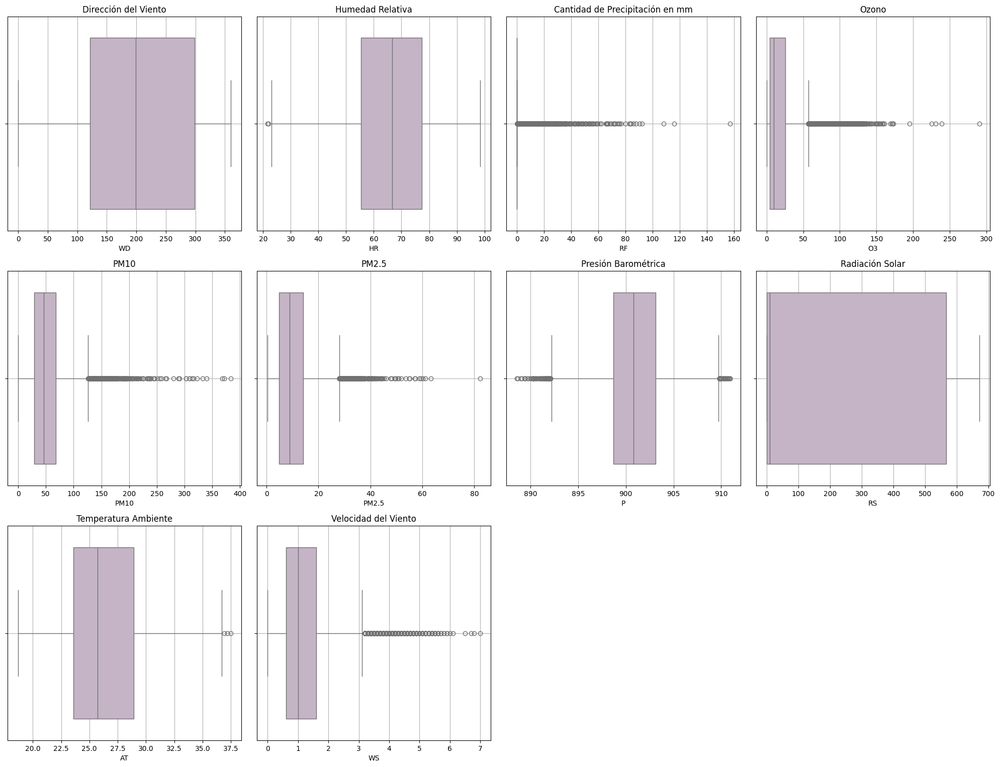

In [62]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para WD
plt.subplot(4, 4, 1)
sns.boxplot(x=df_era_obrero["WD"], color="#c6b1c9") 
plt.title('Dirección del Viento')
plt.grid(True)

# Subplot para HR
plt.subplot(4, 4, 2)
sns.boxplot(x=df_era_obrero["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para RF
plt.subplot(4, 4, 3)
sns.boxplot(x=df_era_obrero["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)

# Subplot para O3
plt.subplot(4, 4, 4)
sns.boxplot(x=df_era_obrero["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 5)
sns.boxplot(x=df_era_obrero["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 6)
sns.boxplot(x=df_era_obrero["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 7)
sns.boxplot(x=df_era_obrero["P"], color="#c6b1c9") 
plt.title('Presión Barométrica')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 8)
sns.boxplot(x=df_era_obrero["RS"], color="#c6b1c9") 
plt.title('Radiación Solar')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 9)
sns.boxplot(x=df_era_obrero["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Subplot para WS
plt.subplot(4, 4, 10)
sns.boxplot(x=df_era_obrero["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)

# Mostrar los gráficos
plt.tight_layout()
plt.show()

A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

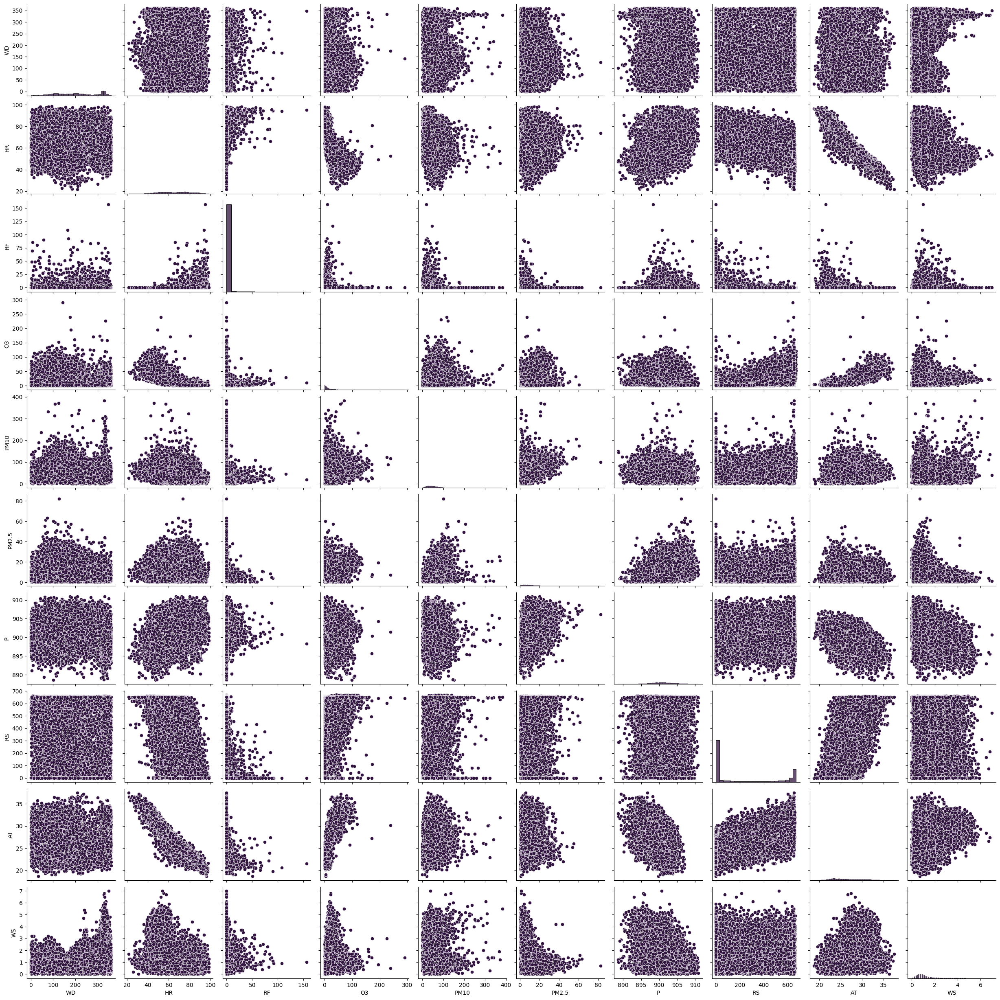

In [63]:
import seaborn as sns
import pandas as pd
sns.pairplot(df_cor_obrero,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

### <font color="#30143"> Estación Ermita </font>

A continuación visualizamos los datos correspondientes a la estación `Ermita`a tráves de la función `head()`

In [64]:
df_ermita = df_t[df_t['estacion'] == 'ermita']
df_ermita.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
4,2017-01-01 00:59:59+00:00,ermita,NaN,NaN,NaN,NaN,NaN,NaN,61.9,NaN,NaN,NaN,2.1475,NaN,NaN,NaN,NaN
13,2017-01-01 01:59:59+00:00,ermita,NaN,NaN,NaN,NaN,NaN,NaN,101.0,NaN,NaN,NaN,2.0689,NaN,NaN,NaN,NaN
22,2017-01-01 02:59:59+00:00,ermita,NaN,NaN,NaN,NaN,NaN,NaN,75.6,NaN,NaN,NaN,2.4617,NaN,NaN,NaN,NaN
31,2017-01-01 03:59:59+00:00,ermita,NaN,NaN,NaN,NaN,NaN,NaN,56.3,NaN,NaN,NaN,2.2522,NaN,NaN,NaN,NaN
40,2017-01-01 04:59:59+00:00,ermita,NaN,NaN,NaN,NaN,NaN,NaN,107.1,NaN,NaN,NaN,2.0689,NaN,NaN,NaN,NaN


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [65]:
pd.set_option('display.precision', 2)
df_ermita.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,0.0,0.0,26997.00,0.0,0.0,39174.00,13878.00,22874.00,0.0,33476.00,32687.00,0.0,0.0,0.0
mean,NaN,NaN,NaN,69.91,NaN,NaN,45.07,14.61,902.81,NaN,4.23,25.17,NaN,NaN,NaN
std,NaN,NaN,NaN,13.02,NaN,NaN,22.94,9.72,3.40,NaN,3.48,3.07,NaN,NaN,NaN
min,NaN,NaN,NaN,18.70,NaN,NaN,0.00,0.36,573.10,NaN,-1.23,8.00,NaN,NaN,NaN
25%,NaN,NaN,NaN,59.60,NaN,NaN,28.90,7.65,901.10,NaN,1.96,22.70,NaN,NaN,NaN
50%,NaN,NaN,NaN,70.60,NaN,NaN,41.60,11.96,903.00,NaN,3.25,24.80,NaN,NaN,NaN
75%,NaN,NaN,NaN,80.00,NaN,NaN,57.08,19.17,904.60,NaN,5.60,27.30,NaN,NaN,NaN
max,NaN,NaN,NaN,97.90,NaN,NaN,257.90,123.10,911.20,NaN,63.30,36.70,NaN,NaN,NaN


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados:  
* **BC (Carbono Negro)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **WD (Dirección del Viento)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **H2S (Sulfuro de Hidrógeno)**:No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **HR (Humedad Relativa)**:Total de observaciones: $26,997$, media: $69.91\%$, desviación estándar: $13.02\%$, mínimo: $18.70\%$, máximo: $97.90\%$
La humedad relativa muestra una distribución bastante amplia, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos de humedad, se óbserva además valores minímos que sugieren una mala medición. 

* **RF (Precipitación)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **NO2 (Dióxido de Nitrógeno)**:Total de observaciones: 1, media: $0.13\frac{\mu g}{m^3}$. La falta de datos suficientes hace que el análisis sea limitado.

* **O3 (Ozono)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **PM10**: Total de observaciones: $39,174$, media: $45.07\frac{\mu g}{m^3}$, desviación estándar: $22.94\frac{\mu g}{m^3}$, mínimo: $0.00\frac{\mu g}{m^3}$, máximo: $257.90\frac{\mu g}{m^3}$, La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de PM10. 

* **PM2.5**: Total de observaciones: $13,878$, media: $14.61\frac{\mu g}{m^3}$, desviación estándar: $9.72\frac{\mu g}{m^3}$, mínimo: $0.36\frac{\mu g}{m^3}$, máximo: $123.10\frac{\mu g}{m^3}$, La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de PM2.5. 

* **P (Presión Atmosférica)**: Total de observaciones: $22,874$, media: $902.81 \text{hPa}$, desviación estándar: $3.40 \text{hPa}$, mínimo: $573.10\text{hPa}$, máximo: $911.20 \text{hPa}$. En cuanto a la distribución de los datos se observa quela mayoría de las mediciones de presión atmosférica se encuentran muy cercanas a la media, lo que indica una variabilidad mínima, pero con algunos valores mínimos que sugieren una mala medición. 

* **RS (Radiación Solar)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.


* **SO2 (Dióxido de Azufre)**: Total de observaciones: $33,476$, media: $4.23\frac{\mu g}{m^3}$, desviación estándar: $3.48\frac{\mu g}{m^3}$, mínimo: $-1.23\frac{\mu g}{m^3}$, máximo: $63.30\frac{\mu g}{m^3}$. La distribución es amplia con un sesgo a la derecha, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos emisión de $\text{SO}_2$

* **AT (Temperatura del Aire)**: Total de observaciones: $32,687$, media: $25.17°\text{C}$, desviación estándar: $3.07°\text{C}$, mínimo: $8.00°\text{C}$, máximo: $36.70°\text{C}$. La temperatura del aire tiene una distribución se encuentran muy cercanas a la media, lo que indica una variabilidad mínima, pero con algunos valores extremos, lo anterior, es posible que sea producto que las condiciones ambientales donde se tomaron estas mediciones pueden variar en términos Temperatura del aire. 


* **AT_10_m (Temperatura del Aire a 10 metros)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo. 

* **UV (Índice UV)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **WS (Velocidad del Viento)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `Ermita`

In [66]:
df_ermita.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 4 to 473251
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        0 non-null      float64            
 4   H2S       0 non-null      float64            
 5   HR        26997 non-null  float64            
 6   RF        0 non-null      float64            
 7   O3        0 non-null      float64            
 8   PM10      39174 non-null  float64            
 9   PM2.5     13878 non-null  float64            
 10  P         22874 non-null  float64            
 11  RS        0 non-null      float64            
 12  SO2       33476 non-null  float64            
 13  AT        32687 non-null  float64            
 14  AT_10_m   0 non-null      float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [67]:
data_missing_ermita = data_missing(df_t, 'estacion', 'ermita')
data_missing_ermita

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,52584,100.00
H2S,52584,100.00
HR,25587,48.66
RF,52584,100.00
O3,52584,100.00
PM10,13410,25.50
PM2.5,38706,73.61
P,29710,56.50


#### <font color="#30143"> Correlación entre características</font>

In [68]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_ermita = df_ermita.drop(columns=['fecha', 'estacion'])
correlations_ermita = df_c_ermita.corr(method = 'spearman')
correlations_ermita

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
H2S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HR,NaN,NaN,NaN,1.0000,NaN,NaN,-0.1023,0.1260,0.4825,NaN,-0.2384,-0.8471,NaN,NaN,NaN
RF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
O3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PM10,NaN,NaN,NaN,-0.1023,NaN,NaN,1.0000,0.6225,0.0062,NaN,0.2493,0.2097,NaN,NaN,NaN
PM2.5,NaN,NaN,NaN,0.1260,NaN,NaN,0.6225,1.0000,0.1690,NaN,0.0169,0.0543,NaN,NaN,NaN
P,NaN,NaN,NaN,0.4825,NaN,NaN,0.0062,0.1690,1.0000,NaN,-0.0383,-0.5579,NaN,NaN,NaN


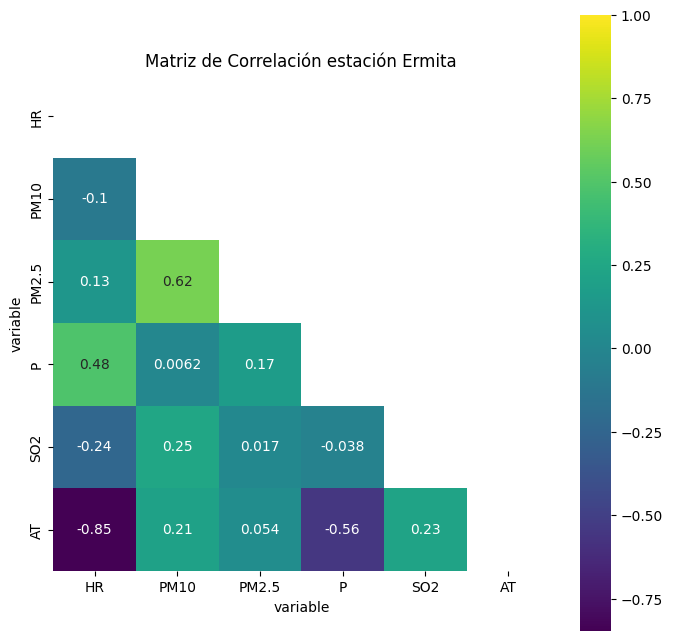

In [69]:
import seaborn as sns
import pandas as pd

df_cor_ermita = df_ermita.drop(columns=['fecha', 'estacion', 'BC', 'WD', 'RF', 'O3', 'RS', 'UV', 'AT_10_m', 'WS', 'H2S'])
plt.figure(figsize = (8,8))

mask = np.triu(np.ones_like(df_cor_ermita.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_ermita.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Ermita')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.85): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `PM2.5` y `PM10` (0.62): Muestra que las concentraciones de estas partículas están estrechamente relacionadas, posiblemente por fuentes comunes o condiciones ambientales.  
* `P` y `AT` (-0.56): Sugiere que al disminuir la temperatura, la presión barométrica aumenta.

Se observó que aparentemente ninguna de las características meteorológicas tiene una influencia fuerte en los niveles de `PM10`. Esto sugiere que el PM10 podría ser el resultado de una fuente de generación adicional. 


#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [70]:
# Skew for each attribute
df_c_ermita.skew()

variable
BC             NaN
WD             NaN
H2S            NaN
HR         -0.1412
RF             NaN
O3             NaN
PM10        1.0929
PM2.5       1.6801
P         -39.8565
RS             NaN
SO2         2.8782
AT          0.4405
AT_10_m        NaN
UV             NaN
WS             NaN
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **PM10**: 1.0929
* **PM2.5**: 1.6801
* **RS**: 1.5010
* **WS**: 1.1840
* **P**: -39.8565
* **SO2**: 2.8782

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):

* **HR**: -0.1412
* **AT**: 0.4405


#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

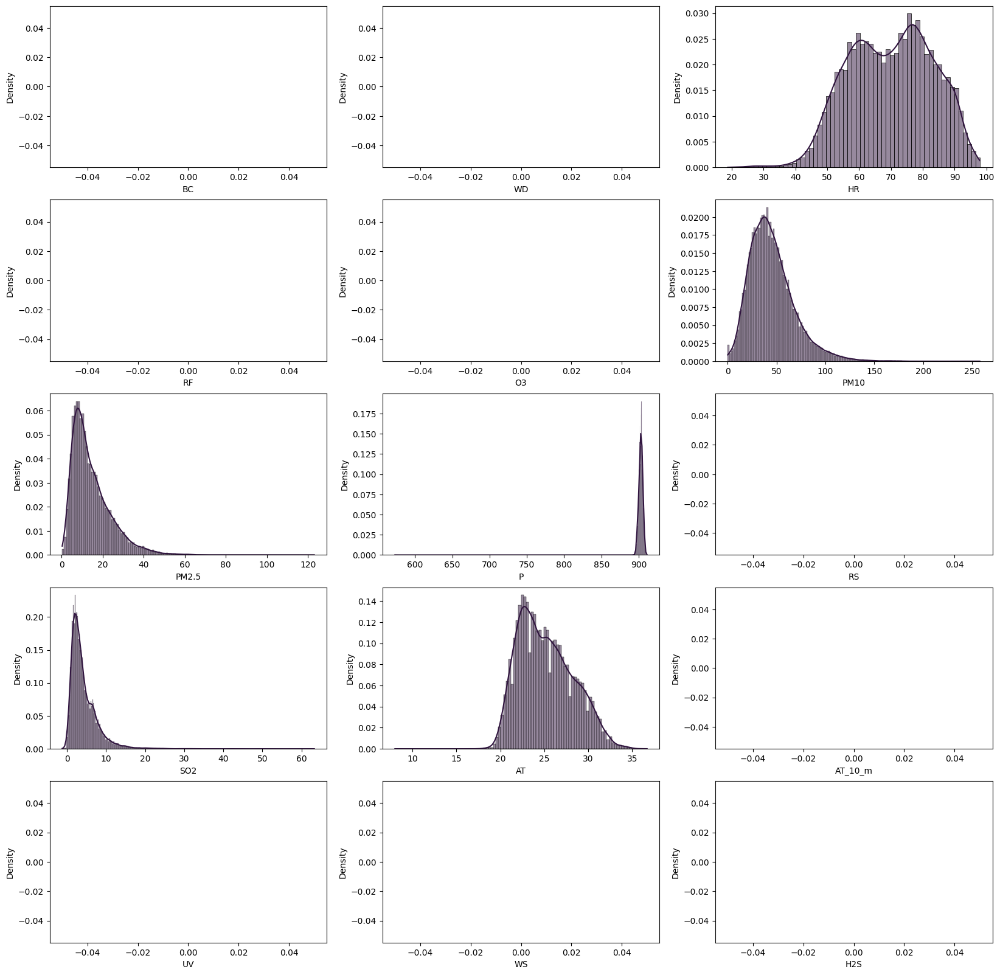

In [71]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_ermita["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_ermita["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

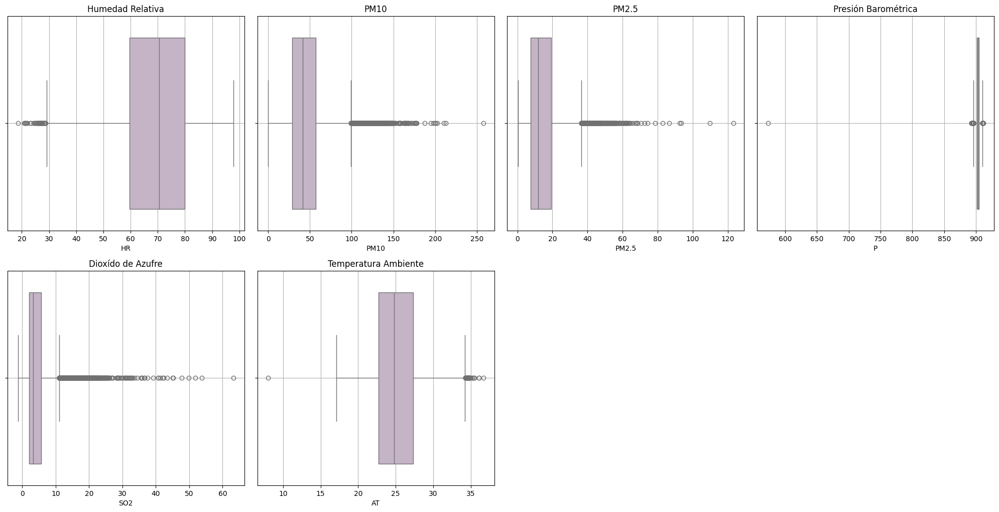

In [72]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))


# Subplot para HR
plt.subplot(4, 4, 1)
sns.boxplot(x=df_ermita["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 2)
sns.boxplot(x=df_ermita["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 3)
sns.boxplot(x=df_ermita["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 4)
sns.boxplot(x=df_ermita["P"], color="#c6b1c9") 
plt.title('Presión Barométrica')
plt.grid(True)

# Subplot para SO2
plt.subplot(4, 4, 5)
sns.boxplot(x=df_ermita["SO2"], color="#c6b1c9") 
plt.title('Dioxído de Azufre')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 6)
sns.boxplot(x=df_ermita["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)


# Mostrar los gráficos
plt.tight_layout()
plt.show()

A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

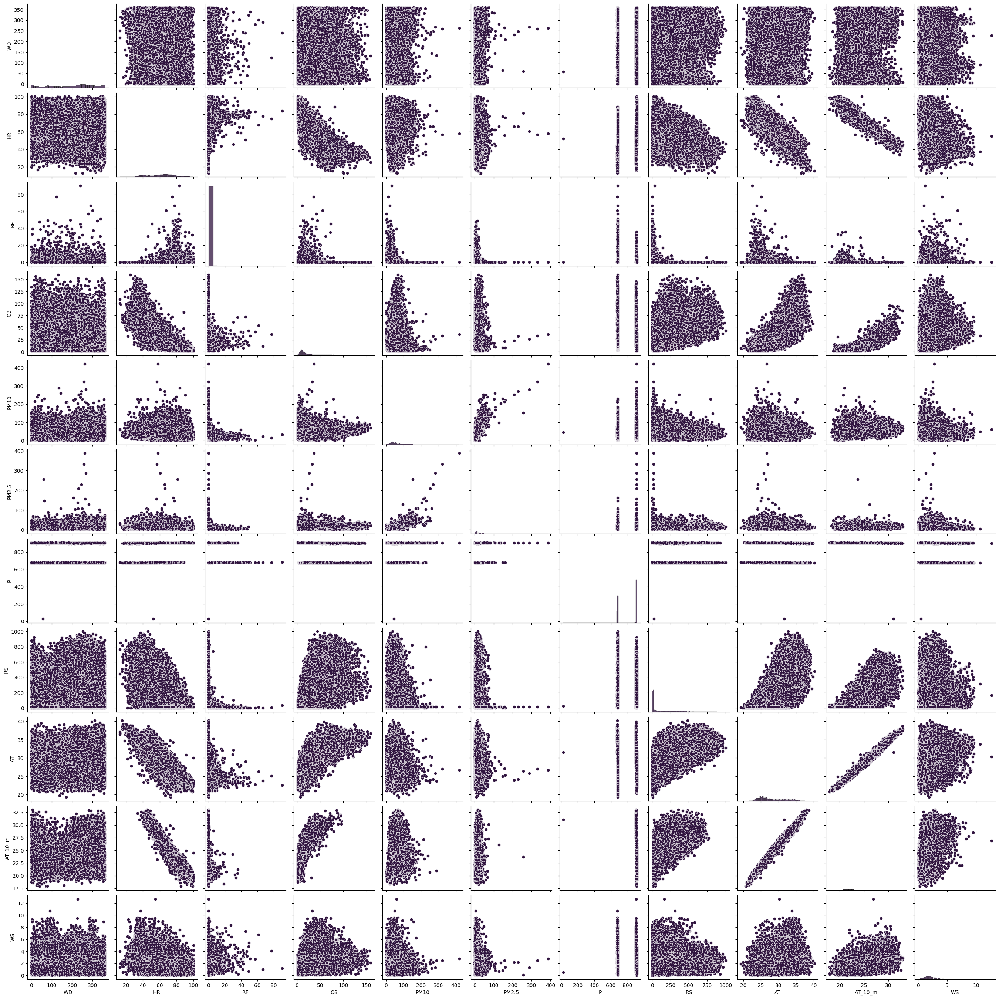

In [73]:
import seaborn as sns

# Eliminar las columnas 'fecha' y 'estacion'
sns.pairplot(df_cor_compartir,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.


### <font color="#30143"> Estación Flora </font>

A continuación visualizamos los datos correspondientes a la estación `Flora`a tráves de la función `head()`

In [74]:
df_flora = df_t[df_t['estacion'] == 'flora']
df_flora.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
5,2017-01-01 00:59:59+00:00,flora,NaN,NaN,NaN,NaN,0.0,8.5347,17.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14,2017-01-01 01:59:59+00:00,flora,NaN,NaN,NaN,NaN,0.0,8.3582,25.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23,2017-01-01 02:59:59+00:00,flora,NaN,NaN,NaN,NaN,0.0,7.4752,22.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
32,2017-01-01 03:59:59+00:00,flora,NaN,NaN,NaN,NaN,0.0,7.8873,24.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41,2017-01-01 04:59:59+00:00,flora,NaN,NaN,NaN,NaN,0.0,9.1233,32.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [75]:
pd.set_option('display.precision', 2)
df_flora.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,25862.00,11252.00,24697.00,48340.00,33374.00,35598.00,15309.00,23931.00,44730.00,27481.00,24697.00,0.0,0.0,25722.00
mean,NaN,154.69,1.74,69.08,0.27,21.42,36.13,16.74,902.94,241.10,5.19,25.29,NaN,NaN,0.66
std,NaN,116.25,1.53,14.53,2.99,28.56,25.91,10.13,2.61,288.07,14.50,3.90,NaN,NaN,0.49
min,NaN,0.00,0.00,23.40,0.00,-3.16,0.00,0.82,894.10,0.00,-2.62,17.10,NaN,NaN,0.00
25%,NaN,55.00,0.70,56.40,0.00,2.51,18.70,9.68,901.20,0.00,0.73,22.00,NaN,NaN,0.30
50%,NaN,121.30,1.39,70.50,0.00,6.83,31.80,14.35,903.00,12.00,2.46,24.90,NaN,NaN,0.60
75%,NaN,259.20,2.22,80.90,0.00,31.35,47.48,21.75,904.80,609.00,5.87,28.20,NaN,NaN,0.90
max,NaN,360.00,23.78,99.00,148.20,266.21,343.80,184.30,910.60,674.00,842.15,37.40,NaN,NaN,5.80


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados:  
* **BC (Carbono Negro)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **WD (Dirección del Viento)**: Total de observaciones: $25,862$, media: $154.69^\circ$, desviación estándar: $116.25^\circ$, mínimo: $0.00^\circ$, máximo: $360.00^\circ$. La dirección del viento muestra una amplia variabilidad y un rango completo de posibles direcciones. La alta desviación estándar sugiere que las mediciones cubren un amplio espectro de direcciones del viento.
  
* **H2S (Sulfuro de Hidrógeno)**:Total de observaciones: $11,252$, media: $1.74 \frac{\mu g}{m^3}$, desviación estándar: $1.53 \frac{\mu g}{m^3}$, mínimo: $0.00 \frac{\mu g}{m^3}$, máximo: $23.78 \frac{\mu g}{m^3}$. La concentración de H2S muestra una distribución con una media relativamente baja y una desviación estándar que indica cierta variabilidad. La presencia de valores máximos altos en comparación con la media sugiere que hay algunas mediciones extremas que podrían ser el resultado de eventos inusuales o errores de medición. La distribución general parece estar sesgada a la derecha, lo que puede reflejar emisiones esporádicas o eventos específicos que aumentan las concentraciones de H2S en el aire.

* **HR (Humedad Relativa)**:Total de observaciones: $26,997$, media: $69.91%$, desviación estándar: $13.02%$, mínimo: $18.70%$, máximo: $97.90%$. La humedad relativa presenta una distribución bastante amplia, con una media que indica una humedad relativamente alta en general. La desviación estándar es considerable, lo que sugiere una variabilidad notable en las mediciones. 

* **RF (Precipitación)**: Total de observaciones: $22,874$, media: $0.27 \text{mm}$, desviación estándar: $2.99 \text{mm}$, mínimo: $0.00 \text{mm}$, máximo: $148.20 \text{mm}$. La precipitación en este conjunto de datos presenta una media muy baja, lo que sugiere que, en general, los registros de precipitación son escasos. La desviación estándar es alta, lo que indica una amplia variabilidad en las mediciones de precipitación. La mayoría de los valores son cercanos a cero, pero hay algunos registros de precipitaciones muy altas (hasta $148.20 \text{mm}$), lo que podría reflejar eventos de lluvia intensa o eventos extremos. La alta variabilidad sugiere que, mientras que la precipitación es generalmente baja, hay periodos o eventos aislados con precipitaciones significativas.

* **O3 (Ozono)**: Total de observaciones: 33,374. Media: $21.42 \frac{\mu g}{m^3}$, desviación estándar: $28.56 \frac{\mu g}{m^3}$, mínimo: $-3.16 \frac{\mu g}{m^3}$, máximo: $266.21 \frac{\mu g}{m^3}$. La distribución de los datos muestra una amplia variabilidad con una media relativamente baja pero con una gran desviación estándar. El valor mínimo negativo sugiere posibles errores de medición. La distribución sesga hacia valores más altos, indicando que las mediciones de ozono varían significativamente y pueden estar influenciadas por condiciones ambientales diversas.

* **PM10**:  Total de observaciones: $35,598$. Media: $36.13 \frac{\mu g}{m^3}$, desviación estándar: $25.91 \frac{\mu g}{m^3}$, mínimo: $0.00 \frac{\mu g}{m^3}$, máximo: $343.80 \frac{\mu g}{m^3}$. La distribución de PM10 muestra una amplia variabilidad con una media de $36.13 \frac{\mu g}{m^3}$, pero con valores extremos que alcanzan hasta $343.80 \frac{\mu g}{m^3}$. La gran desviación estándar indica que los niveles de PM10 pueden variar significativamente, reflejando un sesgo hacia concentraciones más altas. Esta variabilidad puede deberse a diversas fuentes de emisión y condiciones ambientales que afectan la concentración de PM10.

* **PM2.5**: Total de observaciones: $15,309$. Media: $16.74 \frac{\mu g}{m^3}$, desviación estándar: $10.13 \frac{\mu g}{m^3}$, mínimo: $0.82 \frac{\mu g}{m^3}$, máximo: $184.30 \frac{\mu g}{m^3}$. La concentración media de PM2.5 es de $16.74 \frac{\mu g}{m^3}$, con una desviación estándar que indica una considerable variabilidad en los datos. Los niveles de PM2.5 presentan un sesgo hacia la derecha, sugiriendo que, aunque la mayoría de las mediciones están por debajo de la media, hay algunas observaciones con concentraciones mucho más altas. Esta variabilidad puede reflejar la influencia de fuentes específicas de contaminación o variaciones en las condiciones ambientales.

* **P (Presión Atmosférica)**: Total de observaciones: $23,931$. Media: $902.94 \text{hPa}$, desviación estándar: $2.61 \text{hPa}$, mínimo: $894.10 \text{hPa}$, máximo: $910.60 \text{hPa}$. La presión atmosférica presenta una variabilidad muy baja en comparación con su rango total. La mayoría de las observaciones están bastante cerca de la media, con un rango muy estrecho entre el mínimo y el máximo. Esta baja variabilidad sugiere que las mediciones de presión atmosférica en el conjunto de datos son bastante estables.

* **RS (Radiación Solar)**: Total de observaciones: $44,730$. Media: $241.10 \frac{\text{W}}{\text{m}^2}$, desviación estándar: $288.07 \frac{\text{W}}{\text{m}^2}$, mínimo: $0.00 \frac{\text{W}}{\text{m}^2}$, máximo: $674.00 \frac{\text{W}}{\text{m}^2}$. La radiación solar muestra una amplia variabilidad con una media de $241.10 \frac{\text{W}}{\text{m}^2}$ y una desviación estándar considerable. La distribución abarca un amplio rango de valores desde $0.00 \frac{\text{W}}{\text{m}^2}$ hasta $674.00 \frac{\text{W}}{\text{m}^2}$, indicando que la radiación solar varía significativamente dependiendo de las condiciones climáticas y la hora del día. Los valores extremos podrían reflejar momentos de alta radiación o posibles errores en las mediciones.


* **SO2 (Dióxido de Azufre)**: Total de observaciones: $33,476$. Media: $4.23 \frac{\mu g}{m^3}$, desviación estándar: $3.48 \frac{\mu g}{m^3}$, mínimo: $-1.23 \frac{\mu g}{m^3}$, máximo: $63.30 \frac{\mu g}{m^3}$. La concentración de dióxido de azufre muestra una amplia variabilidad con una media de $4.23 \frac{\mu g}{m^3}$. La desviación estándar de $3.48 \frac{\mu g}{m^3}$ indica una dispersión considerable en las mediciones. Los valores extremos, desde negativos hasta $63.30 \frac{\mu g}{m^3}$, sugieren que hay momentos con niveles significativamente altos de SO2, posiblemente debido a fuentes industriales o eventos de alta contaminación. Los valores negativos podrían indicar errores en la medición o ajustes de calibración.

* **AT (Temperatura del Aire)**: Total de observaciones: $32,687$. Media: $25.17^\circ \text{C}$, desviación estándar: $3.07^\circ \text{C}$, mínimo: $8.00^\circ \text{C}$, máximo: $36.70^\circ \text{C}$. La temperatura del aire muestra una distribución relativamente centrada alrededor de la media, con la mayoría de las observaciones agrupadas cerca de $25.17^\circ \text{C}$. La desviación estándar de $3.07^\circ \text{C}$ indica una variabilidad moderada. Los valores extremos, que van desde $8.00^\circ \text{C}$ hasta $36.70^\circ \text{C}$, sugieren que las mediciones abarcan una amplia gama de temperaturas, reflejando posibles variaciones estacionales o diferencias en los ambientes de medición.


* **AT_10_m (Temperatura del Aire a 10 metros)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo. 

* **UV (Índice UV)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **WS (Velocidad del Viento)**: Total de observaciones: $25,722$, media: $0.66 \text{m/s}$, desviación estándar: $0.49 \text{m/s}$, mínimo: $0.00 \text{m/s}$, máximo: $5.80 \text{m/s}$. La velocidad del viento muestra una distribución con baja variabilidad, con la mayoría de las mediciones cercanas a la media y algunos valores extremos que podrían indicar eventos inusuales. 

#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `Flora`.

In [76]:
df_flora.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 5 to 473252
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        25862 non-null  float64            
 4   H2S       11252 non-null  float64            
 5   HR        24697 non-null  float64            
 6   RF        48340 non-null  float64            
 7   O3        33374 non-null  float64            
 8   PM10      35598 non-null  float64            
 9   PM2.5     15309 non-null  float64            
 10  P         23931 non-null  float64            
 11  RS        44730 non-null  float64            
 12  SO2       27481 non-null  float64            
 13  AT        24697 non-null  float64            
 14  AT_10_m   0 non-null      float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [77]:
data_missing_flora = data_missing(df_t, 'estacion', 'flora')
data_missing_flora

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,26722,50.82
H2S,41332,78.60
HR,27887,53.03
RF,4244,8.07
O3,19210,36.53
PM10,16986,32.30
PM2.5,37275,70.89
P,28653,54.49


#### <font color="#30143"> Correlación entre características</font>

In [78]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_flora = df_flora.drop(columns=['fecha', 'estacion'])
correlations_flora = df_c_flora.corr(method = 'spearman')
correlations_flora

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,1.0000,-0.1010,-0.0197,0.0064,-0.0168,-0.1076,-0.1147,-0.1379,-0.0854,-0.1463,-0.0049,NaN,NaN,-0.0296
H2S,NaN,-0.1010,1.0000,0.2785,-0.0749,-0.2333,0.3541,0.2712,0.0534,-0.1794,NaN,-0.2959,NaN,NaN,-0.1342
HR,NaN,-0.0197,0.2785,1.0000,0.2633,-0.6691,0.0849,0.1148,0.4385,-0.5847,-0.0797,-0.9117,NaN,NaN,-0.3821
RF,NaN,0.0064,-0.0749,0.2633,1.0000,-0.0915,-0.0949,-0.1528,0.0706,-0.1441,-0.1144,-0.2257,NaN,NaN,-0.0031
O3,NaN,-0.0168,-0.2333,-0.6691,-0.0915,1.0000,-0.0854,0.0181,-0.1958,0.6928,-0.0470,0.6957,NaN,NaN,0.4416
PM10,NaN,-0.1076,0.3541,0.0849,-0.0949,-0.0854,1.0000,0.5280,0.1988,0.0900,0.2384,-0.0985,NaN,NaN,-0.1164
PM2.5,NaN,-0.1147,0.2712,0.1148,-0.1528,0.0181,0.5280,1.0000,0.3915,0.1788,0.4277,-0.1151,NaN,NaN,-0.1454
P,NaN,-0.1379,0.0534,0.4385,0.0706,-0.1958,0.1988,0.3915,1.0000,-0.0136,0.2240,-0.5042,NaN,NaN,-0.1160


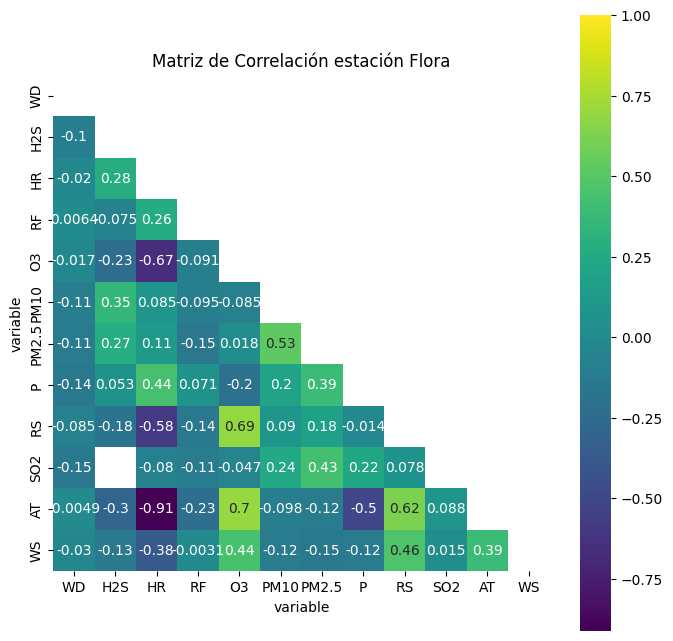

In [79]:
# Eliminar las columnas 'fecha' y 'estacion'
df_cor_flora = df_flora.drop(columns=['fecha', 'estacion', 'BC', 'UV', 'AT_10_m'])

plt.figure(figsize = (8,8))
mask = np.triu(np.ones_like(df_cor_flora.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_flora.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Flora')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.91): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `HR` y `RS` (-0.58): Indica que cuando la humedad relativa aumenta, los niveles de radiación solar tienden a disminuir, y viceversa. 

* `HR` y `O3` (-0.67): Esta relación indica que, en promedio, a medida que la humedad relativa se incrementa, la concentración de ozono tiende a reducirse significativamente, y viceversa.

* `AT` y `O3` (0.70): Indica que cuando la temperatura aumenta, la concentración de ozono también tiende a incrementarse de manera significativa.

* `RS` y `O3` (0.69): Indica que en los días donde se presenta niveles elevalos de radiación solar la concentración de ozono tiende a incrementarse de manera significativa.

* `AT` y `RS` (0.62): Indica que los días con temperaturas más altas tienden a presentar niveles más elevados de radiación solar, y viceversa.

* `PM2.5` y `PM10` (0.53): Muestra que las concentraciones de estas partículas están estrechamente relacionadas, posiblemente por fuentes comunes o condiciones ambientales.

* `P` y `AT` (-0.50): Sugiere que al disminuir la temperatura, la presión barométrica aumenta.

Se observó que aparentemente ninguna de las características meteorológicas tiene una influencia fuerte en los niveles de `PM10`. Esto sugiere que el PM10 podría ser el resultado de una fuente de generación adicional. 

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [80]:
# Skew for each attribute
df_c_flora.skew()

variable
BC             NaN
WD          0.4322
H2S         2.5690
HR         -0.1098
RF         21.8470
O3          1.8007
PM10        1.9335
PM2.5       1.7734
P          -0.2060
RS          0.5489
SO2        27.6686
AT          0.3947
AT_10_m        NaN
UV             NaN
WS          1.9865
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **PM10**: 1.9335
* **PM2.5**: 1.7734
* **RF**: 21.8470
* **WS**: 1.9865
* **O3**: 1.8007
* **SO2**: 27.6686
* **WD**:  0.4322
* **H2S**: 2.5690

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):

* **HR**: -0.1098
* **AT**: 0.3947
* **P**: -0.2060
* **RS**: 0.5489          

#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

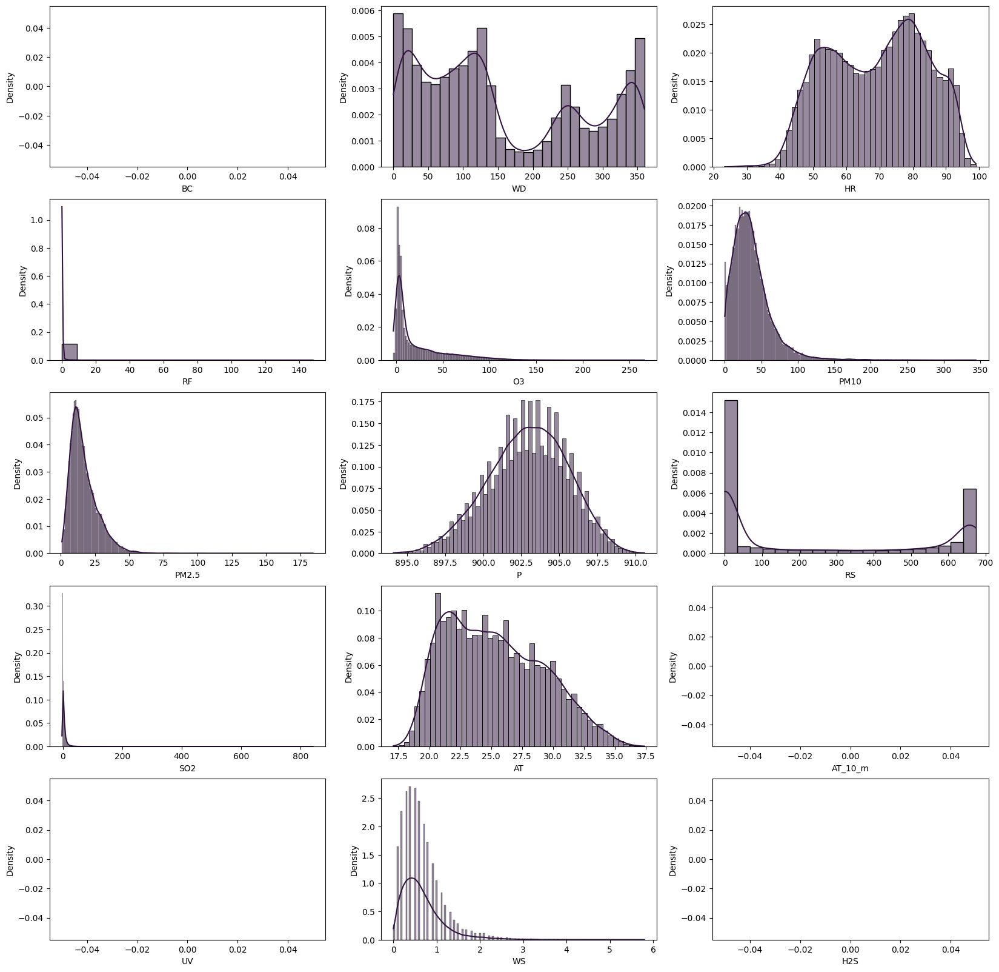

In [81]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_flora["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_flora["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

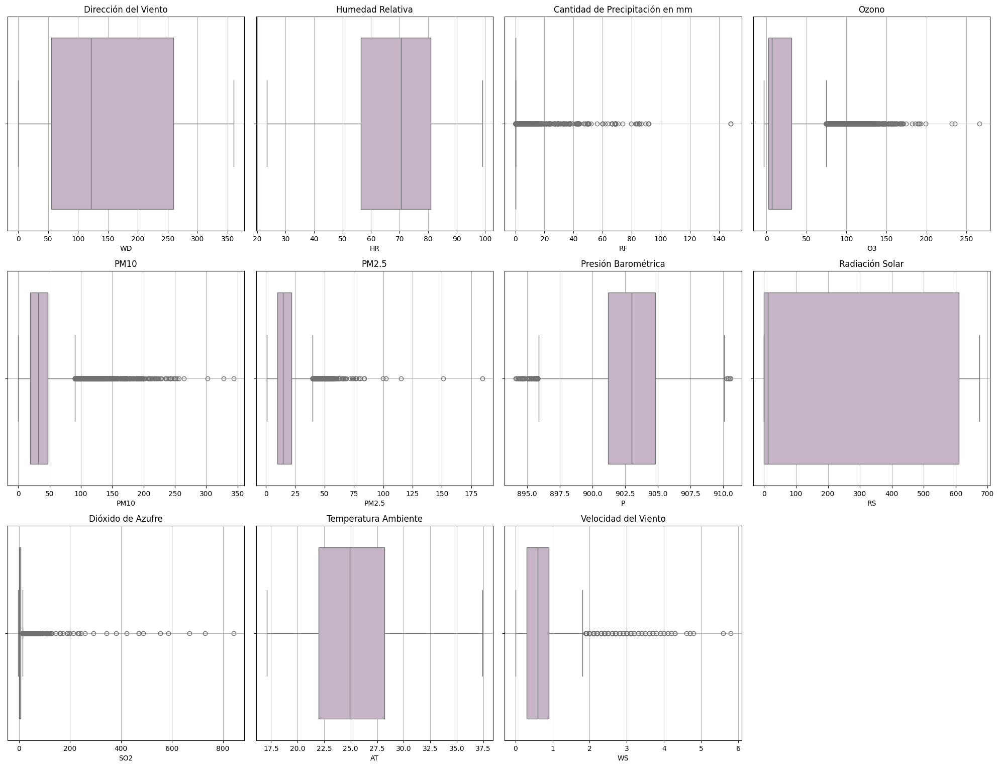

In [82]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para WD
plt.subplot(4, 4, 1)
sns.boxplot(x=df_flora["WD"], color="#c6b1c9") 
plt.title('Dirección del Viento')
plt.grid(True)

# Subplot para HR
plt.subplot(4, 4, 2)
sns.boxplot(x=df_flora["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para RF
plt.subplot(4, 4, 3)
sns.boxplot(x=df_flora["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)

# Subplot para O3
plt.subplot(4, 4, 4)
sns.boxplot(x=df_flora["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 5)
sns.boxplot(x=df_flora["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 6)
sns.boxplot(x=df_flora["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 7)
sns.boxplot(x=df_flora["P"], color="#c6b1c9") 
plt.title('Presión Barométrica')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 8)
sns.boxplot(x=df_flora["RS"], color="#c6b1c9") 
plt.title('Radiación Solar')
plt.grid(True)

# Subplot para SO2
plt.subplot(4, 4, 9)
sns.boxplot(x=df_flora["SO2"], color="#c6b1c9") 
plt.title('Dióxido de Azufre')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 10)
sns.boxplot(x=df_flora["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)


# Subplot para WS
plt.subplot(4, 4, 11)
sns.boxplot(x=df_flora["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)

# Mostrar los gráficos
plt.tight_layout()
plt.show()

A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

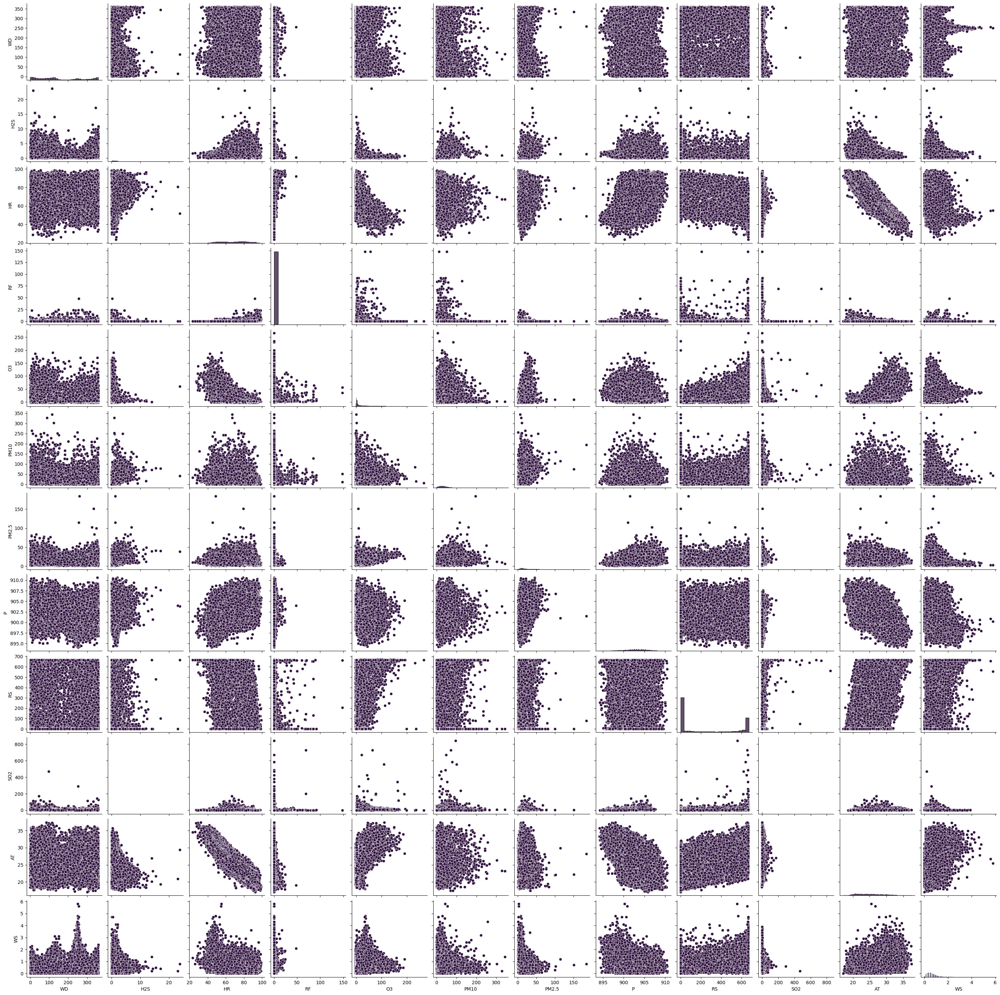

In [83]:
import seaborn as sns
import pandas as pd

sns.pairplot(df_cor_flora,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

### <font color="#30143"> Estación Pance </font>

A continuación visualizamos los datos correspondientes a la estación `Pance`a tráves de la función `head()`

In [84]:
df_pance = df_t[df_t['estacion'] == 'pance']
df_pance.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
6,2017-01-01 00:59:59+00:00,pance,NaN,296.3,NaN,89.6,0.0,3.4139,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1
15,2017-01-01 01:59:59+00:00,pance,NaN,341.6,NaN,88.8,0.0,4.1398,82.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.6
24,2017-01-01 02:59:59+00:00,pance,NaN,188.1,NaN,89.4,0.0,3.1785,77.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1
33,2017-01-01 03:59:59+00:00,pance,NaN,240.1,NaN,90.7,0.0,2.9038,66.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1
42,2017-01-01 04:59:59+00:00,pance,NaN,300.5,NaN,90.7,0.0,3.3943,82.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [85]:
pd.set_option('display.precision', 2)
df_pance.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,35254.00,0.0,35117.00,47830.00,31750.00,35765.00,13144.00,22600.0,41025.00,0.0,32866.00,6571.00,0.0,36392.00
mean,NaN,175.37,NaN,77.14,0.33,32.80,31.62,11.31,902.3,199.41,NaN,24.14,22.96,NaN,2.19
std,NaN,102.59,NaN,15.57,2.67,35.49,16.91,5.97,3.4,260.67,NaN,3.72,3.58,NaN,2.07
min,NaN,0.00,NaN,16.90,0.00,0.00,0.00,0.41,613.5,0.00,NaN,15.00,14.70,NaN,0.00
25%,NaN,84.30,NaN,64.80,0.00,5.85,20.00,7.32,900.5,0.00,NaN,21.10,20.10,NaN,0.70
50%,NaN,177.40,NaN,81.50,0.00,16.30,29.00,10.39,902.5,24.20,NaN,23.20,21.70,NaN,1.60
75%,NaN,263.50,NaN,90.90,0.00,52.13,41.00,13.99,904.3,414.70,NaN,27.20,25.90,NaN,3.00
max,NaN,360.00,NaN,99.20,120.00,206.91,225.00,60.50,910.9,1029.70,NaN,37.70,32.30,NaN,18.50


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados:

* **BC (Carbono Negro)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **WD (Dirección del Viento)**: Total de observaciones: $35,254$, media: $175.37^\circ$, desviación estándar: $102.59^\circ$, mínimo: $0.00^\circ$, máximo: $360.00^\circ$. La dirección del viento abarca un rango completo desde $0$ hasta $360^\circ$, con una alta desviación estándar que indica una gran diversidad en las direcciones del viento.
  
* **H2S (Sulfuro de Hidrógeno)**:No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **HR (Humedad Relativa)**:Total de observaciones: $35,117$, media: $77.14%$, desviación estándar: $15.57%$, mínimo: $16.90%$, máximo: $99.20%$. La humedad relativa muestra una amplia gama de valores, con una alta media y una desviación estándar significativa, sugiriendo variabilidad en las condiciones de humedad.

* **RF (Precipitación)**: Total de observaciones: $47,830$, media: $0.33 \text{ mm}$, desviación estándar: $2.67 \text{ mm}$, mínimo: $0.00 \text{ mm}$, máximo: $120.00 \text{ mm}$. La precipitación tiene una media baja, con una alta variabilidad en las mediciones, reflejando episodios de lluvia que van desde la ausencia total hasta valores extremos.

* **O3 (Ozono)**: Total de observaciones: $31,750$, media: $32.80 \frac{\mu g}{m^3}$, desviación estándar: $35.49 \frac{\mu g}{m^3}$, mínimo: $0.00 \frac{\mu g}{m^3}$, máximo: $206.91 \frac{\mu g}{m^3}$. Los niveles de ozono muestran una alta variabilidad con valores que van desde concentraciones mínimas hasta niveles elevados, lo que indica una amplia gama de exposiciones al ozono.

* **PM10**:  Total de observaciones: $35,765$, media: $31.62 \frac{\mu g}{m^3}$, desviación estándar: $16.91 \frac{\mu g}{m^3}$, mínimo: $0.00 \frac{\mu g}{m^3}$, máximo: $225.00 \frac{\mu g}{m^3}$. La concentración de PM10 muestra una gran variabilidad, con una media moderada y valores extremos altos, sugiriendo variaciones significativas en la cantidad de partículas finas en el aire.

* **PM2.5**: Total de observaciones: $13,144$, media: $11.31 \frac{\mu g}{m^3}$, desviación estándar: $5.97 \frac{\mu g}{m^3}$, mínimo: $0.41 \frac{\mu g}{m^3}$, máximo: $60.50 \frac{\mu g}{m^3}$. La concentración de PM2.5 muestra una distribución que varía considerablemente, con una media más baja que PM10 pero con valores máximos que indican episodios de alta concentración.

* **P (Presión Atmosférica)**: Total de observaciones: $22,600$, media: $902.30 \text{ hPa}$, desviación estándar: $3.40 \text{ hPa}$, mínimo: $613.50 \text{ hPa}$, máximo: $910.90 \text{ hPa}$. La presión atmosférica muestra una media cercana a la normalidad con una desviación estándar baja, indicando que la mayoría de las mediciones están cerca del valor promedio, aunque con algunos valores extremos.

* **RS (Radiación Solar)**: Total de observaciones: $41,025$, media: $199.41 \frac{\text{W}}{\text{m}^2}$, desviación estándar: $260.67 \frac{\text{W}}{\text{m}^2}$, mínimo: $0.00 \frac{\text{W}}{\text{m}^2}$, máximo: $1029.70 \frac{\text{W}}{\text{m}^2}$. La radiación solar tiene una alta variabilidad, con valores que varían ampliamente desde la ausencia total hasta niveles muy altos, lo que refleja condiciones de radiación solar muy diversas.

* **SO2 (Dióxido de Azufre)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **AT (Temperatura del Aire)**: Total de observaciones: $32,866$, media: $24.14^\circ C$, desviación estándar: $3.72^\circ C$, mínimo: $15.00^\circ C$, máximo: $37.70^\circ C$. La temperatura del aire muestra una distribución con una media moderada y una desviación estándar relativamente baja, lo que indica que las temperaturas están bastante concentradas alrededor de la media.


* **AT_10_m (Temperatura del Aire a 10 metros)**: Total de observaciones: $6,571$, media: $22.96^\circ C$, desviación estándar: $3.58^\circ C$, mínimo: $14.70^\circ C$, máximo: $32.30^\circ C$. La temperatura a 10 metros es ligeramente más baja que la temperatura general, con una desviación estándar similar, sugiriendo una distribución comparable pero en un rango ligeramente menor.

* **UV (Índice UV)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **WS (Velocidad del Viento)**: Total de observaciones: $36,392$, media: $2.19 \text{ m/s}$, desviación estándar: $2.07 \text{ m/s}$, mínimo: $0.00 \text{ m/s}$, máximo: $18.50 \text{ m/s}$. La velocidad del viento muestra una media baja pero con una alta desviación estándar, indicando una amplia gama de velocidades, desde calma hasta vientos muy fuertes.

#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `Pance`.

In [86]:
df_pance.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 6 to 473253
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        35254 non-null  float64            
 4   H2S       0 non-null      float64            
 5   HR        35117 non-null  float64            
 6   RF        47830 non-null  float64            
 7   O3        31750 non-null  float64            
 8   PM10      35765 non-null  float64            
 9   PM2.5     13144 non-null  float64            
 10  P         22600 non-null  float64            
 11  RS        41025 non-null  float64            
 12  SO2       0 non-null      float64            
 13  AT        32866 non-null  float64            
 14  AT_10_m   6571 non-null   float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [87]:
data_missing_pance = data_missing(df_t, 'estacion', 'pance')
data_missing_pance

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,17330,32.96
H2S,52584,100.00
HR,17467,33.22
RF,4754,9.04
O3,20834,39.62
PM10,16819,31.99
PM2.5,39440,75.00
P,29984,57.02


#### <font color="#30143"> Correlación entre características</font>

In [88]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_pance = df_pance.drop(columns=['fecha', 'estacion'])
correlations_pance = df_c_pance.corr(method = 'spearman')
correlations_pance

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,1.0000,NaN,-0.1574,-0.0364,0.1536,-0.0144,0.0603,-0.1424,0.2361,NaN,0.2376,0.2428,NaN,0.1130
H2S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HR,NaN,-0.1574,NaN,1.0000,0.3060,-0.7625,-0.2464,-0.2652,0.5045,-0.6089,NaN,-0.9166,-0.9483,NaN,-0.4581
RF,NaN,-0.0364,NaN,0.3060,1.0000,-0.0729,-0.2659,-0.2303,0.1361,-0.1398,NaN,-0.2240,-0.2625,NaN,-0.0181
O3,NaN,0.1536,NaN,-0.7625,-0.0729,1.0000,0.0368,0.1067,-0.3841,0.6513,NaN,0.7888,0.8417,NaN,0.4477
PM10,NaN,-0.0144,NaN,-0.2464,-0.2659,0.0368,1.0000,0.7750,-0.2841,0.0233,NaN,0.2322,0.2840,NaN,0.0125
PM2.5,NaN,0.0603,NaN,-0.2652,-0.2303,0.1067,0.7750,1.0000,-0.1460,0.1651,NaN,0.1881,0.2013,NaN,-0.0265
P,NaN,-0.1424,NaN,0.5045,0.1361,-0.3841,-0.2841,-0.1460,1.0000,-0.0685,NaN,-0.5155,-0.4155,NaN,-0.3337


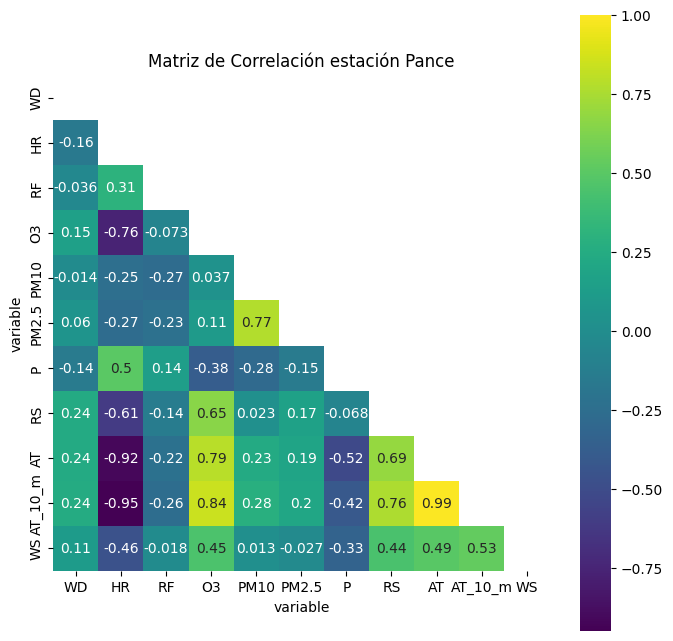

In [89]:
# Eliminar las columnas 'fecha' y 'estacion'
df_cor_pance = df_pance.drop(columns=['fecha', 'estacion', 'BC', 'SO2', 'UV', 'H2S'])

plt.figure(figsize = (8,8))
mask = np.triu(np.ones_like(df_cor_pance.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_pance.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Pance')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.94): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.
* `AT_10_m` y `HR` (-0.97): Indica que la temperatura medida a 10 metros de altura sigue un patrón similar al de la temperatura ambiente general en relación con los niveles de humedad relativa.
* `AT` y `O3` (0.79): Indica que cuando la temperatura aumenta, la concentración de ozono también tiende a incrementarse de manera significativa.
* `AT_10_m` y `O3` (0.84): Indica que la temperatura medida a 10 metros de altura la concentración de ozono tiende a incrementarse de manera significativa.
* `AT_10_m` y `RS` (0.76): Indica que los días con temperaturas medidas a 10 metros de altura más altas tienden a presentar niveles más elevados de radiación solar, y viceversa.
* `HR` y `O3` (-0.76): Esta relación indica que, en promedio, a medida que la humedad relativa se incrementa, la concentración de ozono tiende a reducirse significativamente, y viceversa.
* `PM2.5` y `PM10` (0.77): Muestra que las concentraciones de estas partículas están estrechamente relacionadas, posiblemente por fuentes comunes o condiciones ambientales.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `AT` y `P` (-0.52): Indica que cuando latemperatura ambiente aumenta, la presión atmosférica tienden a disminuir, y viceversa.
* `AT` y `RS` (0.69): Indica que los días con temperaturas  más altas tienden a presentar niveles más elevados de radiación solar, y viceversa.
* `HR` y `P` (0.50): Indica que cuando la humedad relativa aumenta, la presión atmosférica tiende a disminuir, y viceversa. 
* `RS` y `O3` (0.65): Indica que en los días donde se presenta niveles elevalos de radiación solar la concentración de ozono tiende a incrementarse de manera significativa.
* `AT` y `AT_10_m` (0.99): La alta correlación indica que las mediciones de temperatura ambiente a nivel del suelo y a 10 metros de altura son prácticamente idénticas. Esto sugiere que ambas mediciones reflejan las mismas condiciones térmicas con muy poca variación entre ellas.

Se observó que aparentemente ninguna de las características meteorológicas tiene una influencia fuerte en los niveles de `PM10`. Esto sugiere que el PM10 podría ser el resultado de una fuente de generación adicional. 

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [90]:
# Skew for each attribute
df_c_pance.skew()

variable
BC             NaN
WD         -0.0170
H2S            NaN
HR         -0.6724
RF         18.1075
O3          1.2768
PM10        1.1634
PM2.5       1.3870
P         -27.3737
RS          0.9665
SO2            NaN
AT          0.4905
AT_10_m     0.5880
UV             NaN
WS          1.8479
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **PM10**: 1.1634
* **PM2.5**: 1.3870
* **RF**: 18.1075
* **WS**: 1.8479
* **O3**: 1.2768
* **P**: -27.3737


Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):
* **WD**:  -0.0170
* **HR**: -0.6724
* **AT**: 0.4905
* **AT_10_m**: 0.5880
* **RS**:  0.9665   

#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

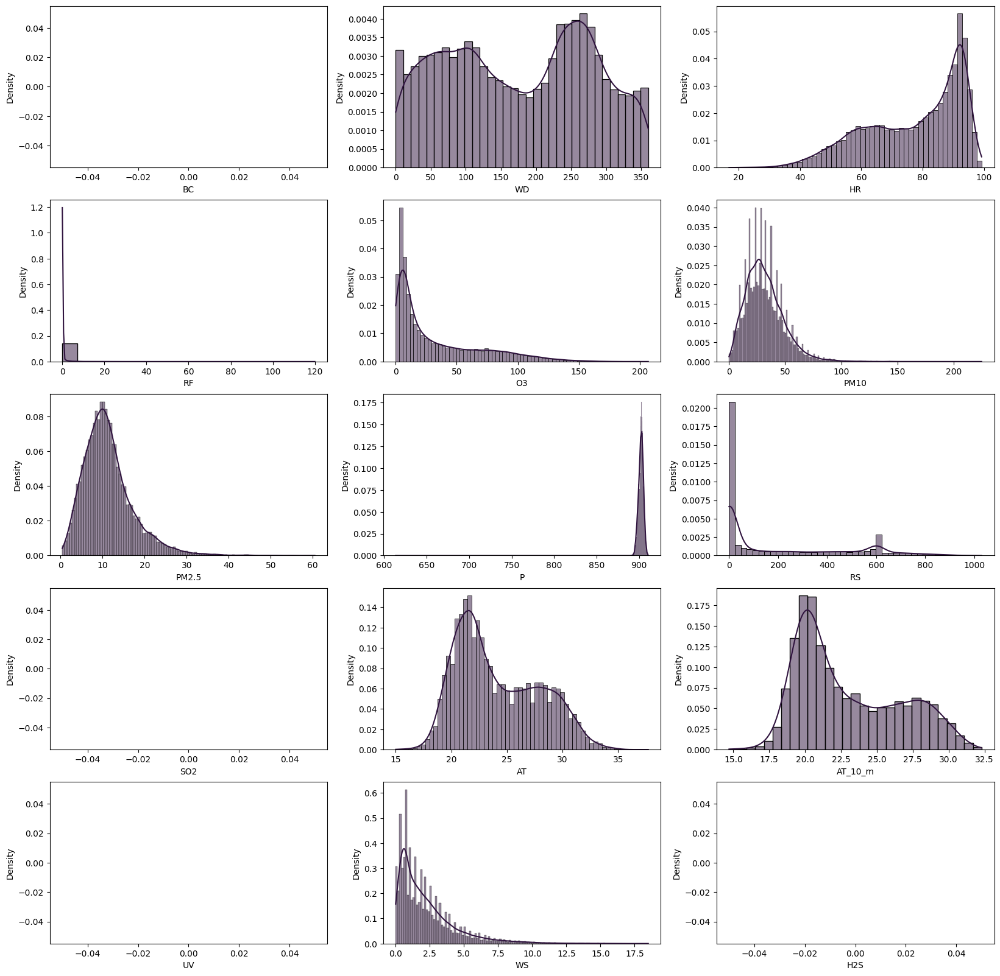

In [91]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_pance["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_pance["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

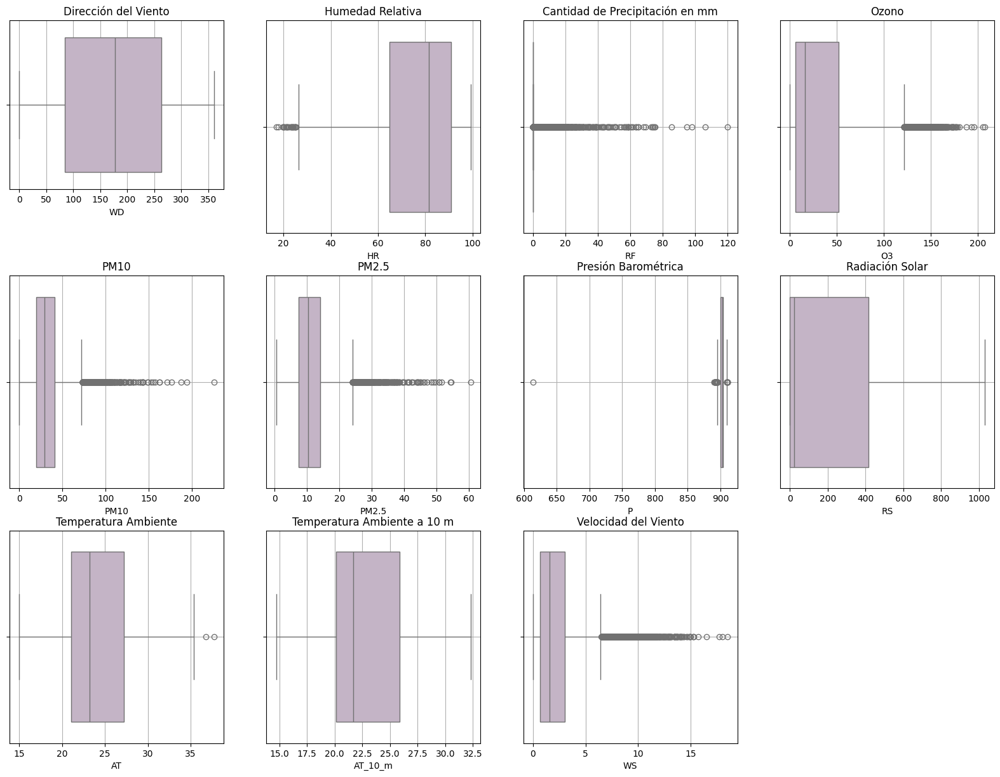

In [92]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para WD
plt.subplot(5, 4, 1)
sns.boxplot(x=df_pance["WD"], color="#c6b1c9") 
plt.title('Dirección del Viento')
plt.grid(True)


# Subplot para HR
plt.subplot(4, 4, 2)
sns.boxplot(x=df_pance["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para RF
plt.subplot(4, 4, 3)
sns.boxplot(x=df_pance["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)

# Subplot para O3
plt.subplot(4, 4, 4)
sns.boxplot(x=df_pance["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 5)
sns.boxplot(x=df_pance["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 6)
sns.boxplot(x=df_pance["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(4, 4, 7)
sns.boxplot(x=df_pance["P"], color="#c6b1c9") 
plt.title('Presión Barométrica')
plt.grid(True)

# Subplot para RS
plt.subplot(4, 4, 8)
sns.boxplot(x=df_pance["RS"], color="#c6b1c9") 
plt.title('Radiación Solar')
plt.grid(True)

# Subplot para AT
plt.subplot(4, 4, 9)
sns.boxplot(x=df_pance["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Subplot para UV
plt.subplot(4, 4, 10)
sns.boxplot(x=df_pance["AT_10_m"], color="#c6b1c9") 
plt.title('Temperatura Ambiente a 10 m')
plt.grid(True)

# Subplot para WS
plt.subplot(4, 4, 11)
sns.boxplot(x=df_pance["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)


# Mostrar los gráficos
plt.tight_layout()
plt.show()

A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

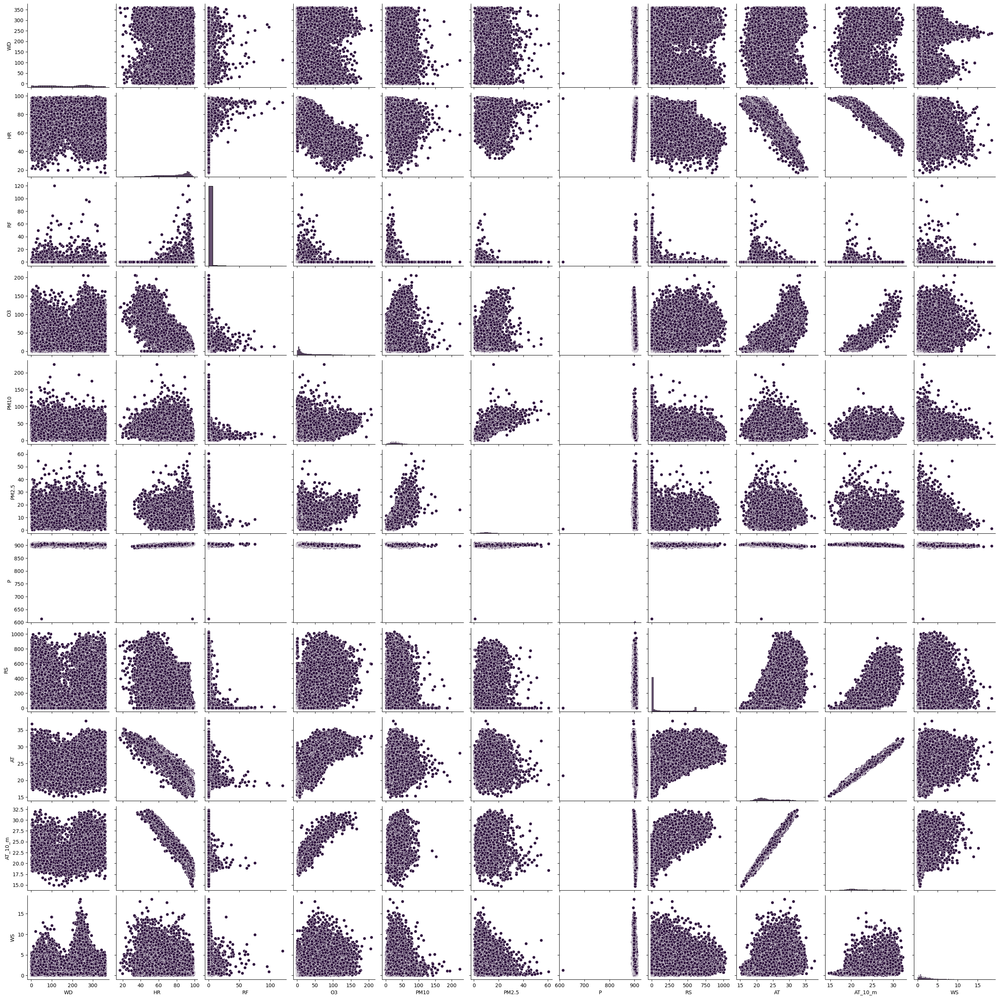

In [93]:
import seaborn as sns
import pandas as pd
sns.pairplot(df_cor_pance,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

### <font color="#30143"> Estación Transitoria </font>

A continuación visualizamos los datos correspondientes a la estación `Transitoria`a tráves de la función `head()`

In [94]:
df_transitoria = df_t[df_t['estacion'] == 'transitoria']
df_transitoria.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
7,2017-01-01 00:59:59+00:00,transitoria,NaN,NaN,NaN,NaN,NaN,NaN,91.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16,2017-01-01 01:59:59+00:00,transitoria,NaN,NaN,NaN,NaN,NaN,NaN,123.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25,2017-01-01 02:59:59+00:00,transitoria,NaN,NaN,NaN,NaN,NaN,NaN,108.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,2017-01-01 03:59:59+00:00,transitoria,NaN,NaN,NaN,NaN,NaN,NaN,83.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
43,2017-01-01 04:59:59+00:00,transitoria,NaN,NaN,NaN,NaN,NaN,NaN,73.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [95]:
pd.set_option('display.precision', 2)
df_transitoria.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,0.0,0.0,4101.00,17245.00,0.0,7450.00,7713.00,7533.00,17050.00,0.0,14346.00,17246.00,0.0,0.0,0.0
mean,NaN,NaN,3.31,71.93,NaN,27.40,26.13,16.11,905.03,NaN,5.55,26.11,NaN,NaN,NaN
std,NaN,NaN,2.94,14.09,NaN,31.73,19.13,9.71,2.82,NaN,11.48,3.28,NaN,NaN,NaN
min,NaN,NaN,0.00,27.60,NaN,-1.57,0.00,0.49,893.60,NaN,-4.53,18.60,NaN,NaN,NaN
25%,NaN,NaN,0.65,59.80,NaN,4.53,13.00,9.35,903.20,NaN,2.33,23.40,NaN,NaN,NaN
50%,NaN,NaN,2.42,73.30,NaN,14.79,21.00,14.14,905.15,NaN,4.35,25.60,NaN,NaN,NaN
75%,NaN,NaN,5.87,84.00,NaN,38.47,34.00,20.77,907.00,NaN,7.07,28.60,NaN,NaN,NaN
max,NaN,NaN,27.98,100.70,NaN,214.47,238.00,157.82,913.50,NaN,519.53,36.30,NaN,NaN,NaN


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados:  
* **BC (Carbono Negro)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
* **WD (Dirección del Viento)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  
  
* **H2S (Sulfuro de Hidrógeno)**:Total de observaciones: $4,101$, media: $3.31 , \mu g/m^3$, desviación estándar: $2.94 , \mu g/m^3$, mínimo: $0.00 , \mu g/m^3$, máximo: $27.98 , \mu g/m^3$. La concentración de H2S muestra una media relativamente baja con una desviación estándar que indica una variabilidad moderada. La presencia de valores máximos altos en comparación con la media sugiere que existen algunas mediciones extremas, posiblemente debidas a eventos específicos o emisiones esporádicas. La distribución está sesgada hacia la derecha, lo que puede indicar que los valores más altos son menos frecuentes pero pueden ocurrir bajo condiciones particulares.

* **HR (Humedad Relativa)**:Total de observaciones: $17,245$, media: $71.93%$, desviación estándar: $14.09%$, mínimo: $27.60%$, máximo: $100.70%$. La humedad relativa tiene una media bastante alta y una desviación estándar que refleja una notable variabilidad en las mediciones. Los valores mínimos y máximos muestran un rango amplio, con una gran cantidad de observaciones cercanas al máximo, lo que puede indicar condiciones atmosféricas húmedas frecuentes. La distribución parece relativamente simétrica, sugiriendo una variabilidad amplia pero uniforme en las condiciones de humedad.

* **RF (Precipitación)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  

* **O3 (Ozono)**: Total de observaciones: $7,450$, media: $27.40 , \mu g/m^3$, desviación estándar: $31.73 , \mu g/m^3$, mínimo: $-1.57 , \mu g/m^3$, máximo: $214.47 , \mu g/m^3$. La concentración de ozono muestra una media baja con una alta desviación estándar, lo que indica una gran variabilidad en las mediciones. Los valores negativos pueden ser errores en la medición o datos incorrectos, mientras que los valores máximos altos sugieren la presencia de episodios con concentraciones elevadas de ozono. La distribución parece sesgada a la derecha, indicando que los niveles más altos son menos frecuentes pero más significativos cuando ocurren.

* **PM10**:  Total de observaciones: $7,713$, media: $26.13 , \mu g/m^3$, desviación estándar: $19.13 , \mu g/m^3$, mínimo: $0.00 , \mu g/m^3$, máximo: $238.00 , \mu g/m^3$. La concentración de PM10 muestra una media relativamente baja con una alta desviación estándar, reflejando una considerable variabilidad en las mediciones. El rango de valores indica la presencia de episodios con concentraciones extremadamente altas, lo que podría ser resultado de eventos puntuales o contaminación. La distribución sugiere una posible sesgo hacia la derecha, con algunos eventos con concentraciones de PM10 significativamente más altas que la media.

* **PM2.5**: Total de observaciones: $7,533$, media: $16.11 , \mu g/m^3$, desviación estándar: $9.71 , \mu g/m^3$, mínimo: $0.49 , \mu g/m^3$, máximo: $157.82 , \mu g/m^3$. La concentración de PM2.5 presenta una media moderada y una desviación estándar que indica una variabilidad considerable. La amplia diferencia entre el mínimo y el máximo sugiere que los niveles de PM2.5 pueden variar significativamente, con algunos eventos de alta concentración. La distribución muestra un sesgo a la derecha, con valores extremos que podrían reflejar episodios de contaminación elevados.

* **P (Presión Atmosférica)**: Total de observaciones: $17,050$, media: $905.03 , hPa$, desviación estándar: $2.82 , hPa$, mínimo: $893.60 , hPa$, máximo: $913.50 , hPa$. La presión barométrica muestra una media bastante estable con una baja desviación estándar, lo que indica que las mediciones son bastante consistentes. El rango de valores es relativamente estrecho, sugiriendo que la presión barométrica no varía drásticamente en las condiciones observadas. La distribución parece bastante normal, con poca variabilidad extrema.

* **RS (Radiación Solar)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **SO2 (Dióxido de Azufre)**:  Total de observaciones: $14,346$, media: $5.55 , \mu g/m^3$, desviación estándar: $11.48 , \mu g/m^3$, mínimo: $-4.53 , \mu g/m^3$, máximo: $519.53 , \mu g/m^3$. La concentración de SO2 presenta una media baja, pero una desviación estándar alta, lo que indica una considerable variabilidad en las mediciones. La presencia de valores negativos sugiere que algunos datos podrían ser incorrectos, ya que en condiciones normales, las concentraciones de SO2 no deberían ser negativas. Los valores máximos extremadamente altos reflejan algunas mediciones muy elevadas que podrían ser el resultado de errores de medición o condiciones excepcionales. La distribución de los datos muestra una alta dispersión y asimetría a la derecha, lo que indica que las concentraciones extremadamente altas son menos frecuentes, pero pueden ser significativas.

* **AT (Temperatura del Aire)**:  Total de observaciones: $17,246$, media: $26.11^\circ C$, desviación estándar: $3.28^\circ C$, mínimo: $18.60^\circ C$, máximo: $36.30^\circ C$. La temperatura ambiental muestra una media relativamente alta, con una desviación estándar moderada, lo que sugiere que la temperatura varía de manera razonable en el rango de datos registrados. La desviación estándar indica que hay una variabilidad moderada en las temperaturas registradas, con algunos valores extremos que podrían ser atribuibles a eventos climáticos inusuales o variaciones diurnas y estacionales. La distribución de la temperatura ambiental parece bastante equilibrada, aunque los valores más altos se acercan al límite máximo registrado.


* **AT_10_m (Temperatura del Aire a 10 metros)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo. 

* **UV (Índice UV)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **WS (Velocidad del Viento)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.
  

#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `Transitoria`.

In [96]:
df_transitoria.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 7 to 473254
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        0 non-null      float64            
 3   WD        0 non-null      float64            
 4   H2S       4101 non-null   float64            
 5   HR        17245 non-null  float64            
 6   RF        0 non-null      float64            
 7   O3        7450 non-null   float64            
 8   PM10      7713 non-null   float64            
 9   PM2.5     7533 non-null   float64            
 10  P         17050 non-null  float64            
 11  RS        0 non-null      float64            
 12  SO2       14346 non-null  float64            
 13  AT        17246 non-null  float64            
 14  AT_10_m   0 non-null      float64            
 15  UV        0 non-null   

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [97]:
data_missing_transitoria = data_missing(df_t, 'estacion', 'transitoria')
data_missing_transitoria

,Datos faltantes,Porcentaje (%)
variable,,
BC,52584,100.00
WD,52584,100.00
H2S,48483,92.20
HR,35339,67.20
RF,52584,100.00
O3,45134,85.83
PM10,44871,85.33
PM2.5,45051,85.67
P,35534,67.58


#### <font color="#30143"> Correlación entre características</font>

In [98]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_transitoria = df_transitoria.drop(columns=['fecha', 'estacion'])
correlations_transitoria = df_c_transitoria.corr(method = 'spearman')
correlations_transitoria

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
H2S,NaN,NaN,1.0000,-0.1034,NaN,-0.0006,NaN,-0.0564,0.2827,NaN,NaN,0.1239,NaN,NaN,NaN
HR,NaN,NaN,-0.1034,1.0000,NaN,-0.7589,NaN,0.1065,0.5289,NaN,-0.2774,-0.9542,NaN,NaN,NaN
RF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
O3,NaN,NaN,-0.0006,-0.7589,NaN,1.0000,NaN,-0.0620,-0.4073,NaN,0.1957,0.7949,NaN,NaN,NaN
PM10,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PM2.5,NaN,NaN,-0.0564,0.1065,NaN,-0.0620,NaN,1.0000,0.2016,NaN,0.3821,-0.0438,NaN,NaN,NaN
P,NaN,NaN,0.2827,0.5289,NaN,-0.4073,NaN,0.2016,1.0000,NaN,0.1423,-0.5154,NaN,NaN,NaN


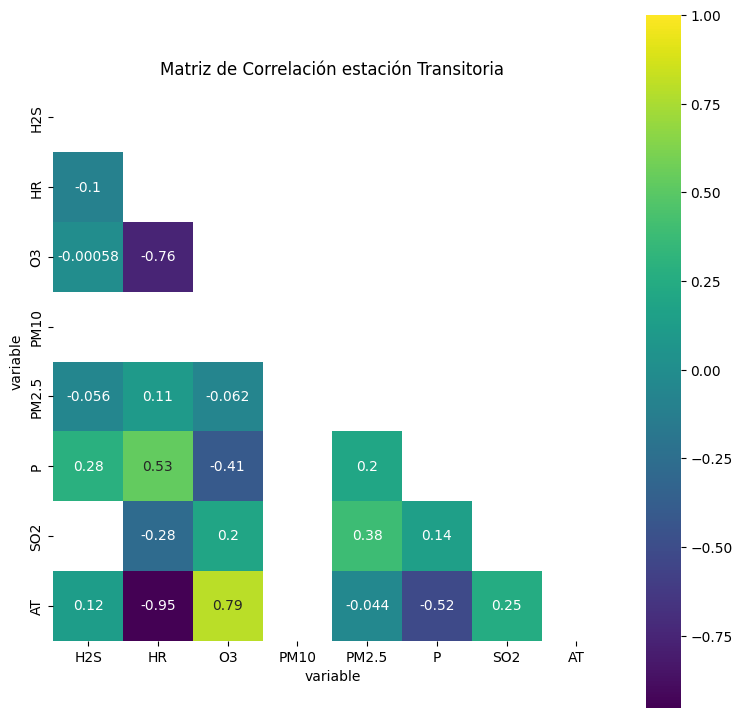

In [99]:
import seaborn as sns
import pandas as pd

# Eliminar las columnas 'fecha' y 'estacion'
df_cor_transitoria = df_transitoria.drop(columns=['fecha', 'estacion', 'BC', 'WD','RF' , 'RS', 'AT_10_m', 'UV', 'WS'])


plt.figure(figsize = (9,9))
mask = np.triu(np.ones_like(df_cor_transitoria.corr().corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_transitoria.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Transitoria')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `AT` y `HR` (-0.95): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.
* `AT` y `O3` (0.80): Indica que cuando la temperatura aumenta, la concentración de ozono también tiende a incrementarse de manera significativa.
* `HR` y `O3` (-0.76): Esta relación indica que, en promedio, a medida que la humedad relativa se incrementa, la concentración de ozono tiende a reducirse significativamente, y viceversa.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `AT` y `P` (-0.52): Indica que cuando latemperatura ambiente aumenta, la presión atmosférica tienden a disminuir, y viceversa.
* `HR` y `P` (0.53): Indica que cuando la humedad relativa aumenta, la presión atmosférica tiende a disminuir, y viceversa. 

No fue posible realizar un análisis contrastando las características meteorológicas con el nivel de concentración de `PM10` debido a la gran cantidad de datos faltantes.

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [100]:
# Skew for each attribute
df_c_transitoria.skew()

variable
BC             NaN
WD             NaN
H2S         1.1567
HR         -0.1643
RF             NaN
O3          1.5966
PM10        1.7162
PM2.5       1.8831
P          -0.2015
RS             NaN
SO2        24.8894
AT          0.4205
AT_10_m        NaN
UV             NaN
WS             NaN
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):

* **PM10**: 1.7162
* **PM2.5**: 1.8831
* **O3**: 1.5966
* **SO2**: 24.8894
* **H2S**: 1.1567

Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):

* **HR**: -0.1643   
* **AT**: 0.4205
* **P**: -0.2015

#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

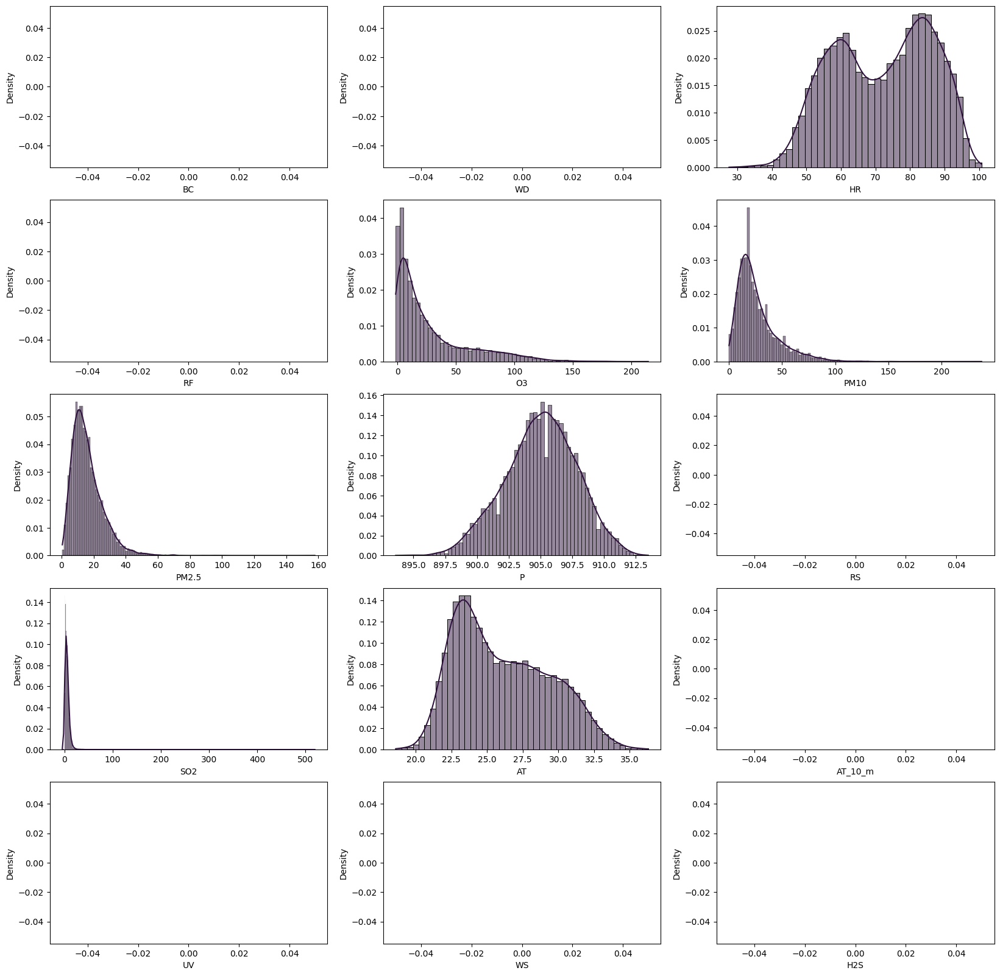

In [101]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_transitoria["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_transitoria["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

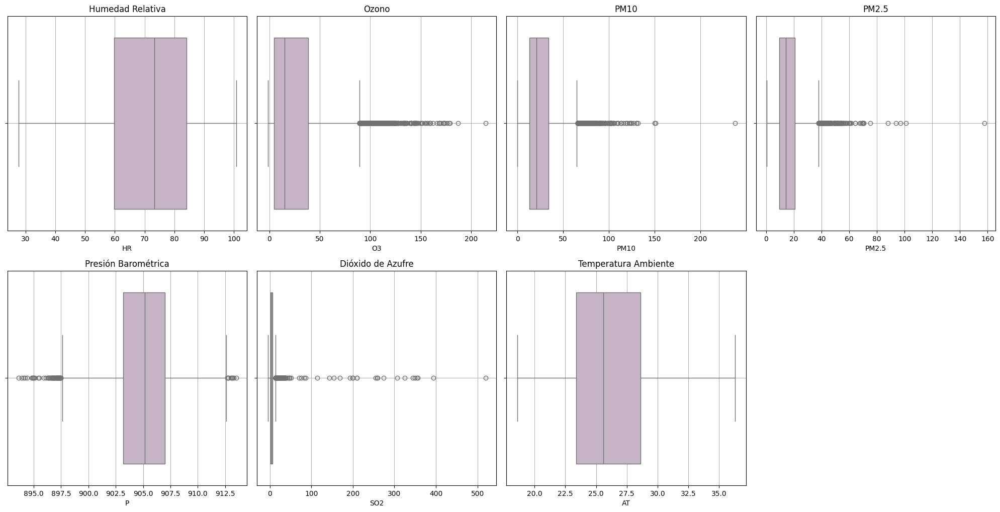

In [102]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para HR
plt.subplot(4, 4, 1)
sns.boxplot(x=df_transitoria["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para O3
plt.subplot(4, 4, 2)
sns.boxplot(x=df_transitoria["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM10
plt.subplot(4, 4, 3)
sns.boxplot(x=df_transitoria["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(4, 4, 4)
sns.boxplot(x=df_transitoria["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para Presión Barométrica
plt.subplot(4, 4, 5)
sns.boxplot(x=df_transitoria["P"], color="#c6b1c9") 
plt.title('Presión Barométrica')
plt.grid(True)


# Subplot para SO2
plt.subplot(4, 4, 6)
sns.boxplot(x=df_transitoria["SO2"], color="#c6b1c9") 
plt.title('Dióxido de Azufre')
plt.grid(True)

# Subplot para Temperatura Ambiente
plt.subplot(4, 4, 7)
sns.boxplot(x=df_transitoria["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Mostrar los gráficos
plt.tight_layout()
plt.show()


A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

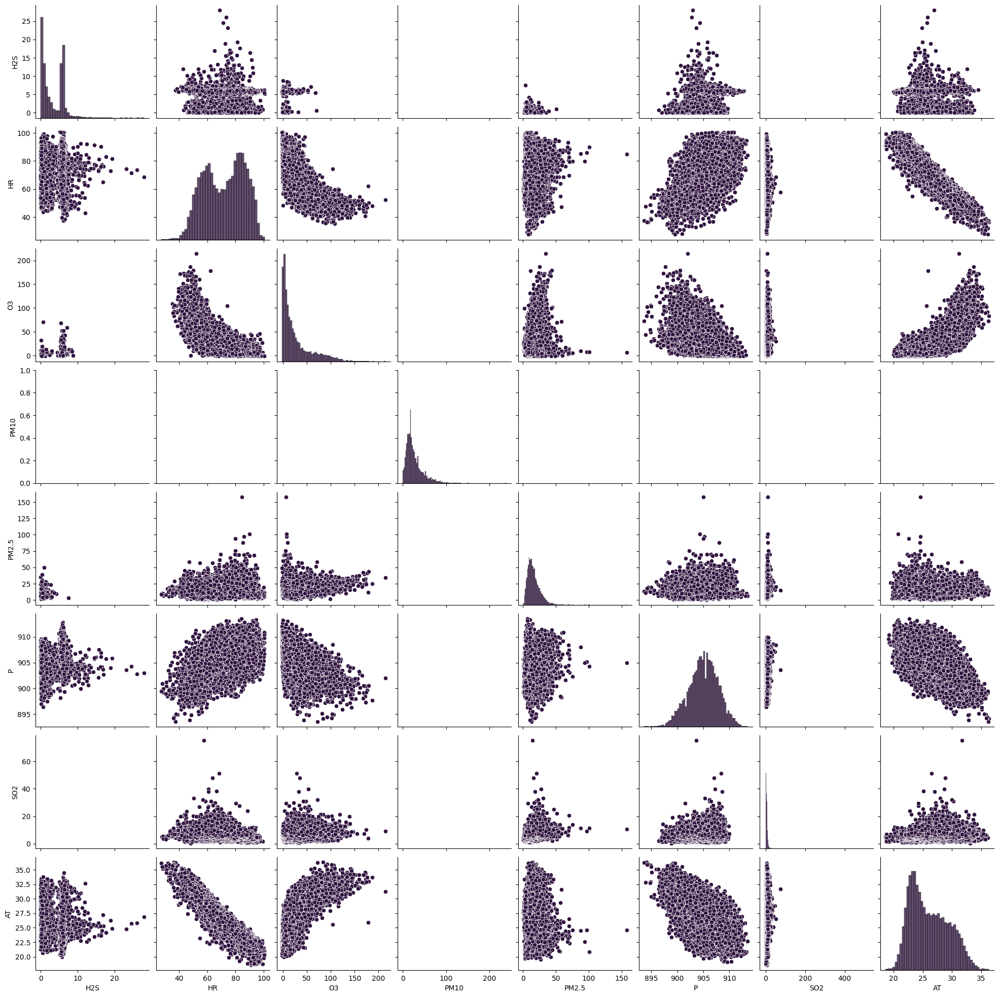

In [103]:
import seaborn as sns
import pandas as pd

sns.pairplot(df_cor_transitoria,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.

### <font color="#30143"> Estación Univalle </font>

A continuación visualizamos los datos correspondientes a la estación `Univalle`a tráves de la función `head()`

In [104]:
df_univalle = df_t[df_t['estacion'] == 'univalle']
df_univalle.head()

variable,fecha,estacion,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
8,2017-01-01 00:59:59+00:00,univalle,NaN,NaN,NaN,NaN,NaN,7.3575,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17,2017-01-01 01:59:59+00:00,univalle,NaN,NaN,NaN,NaN,NaN,8.5740,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26,2017-01-01 02:59:59+00:00,univalle,NaN,NaN,NaN,NaN,NaN,7.9461,NaN,59.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,2017-01-01 03:59:59+00:00,univalle,NaN,NaN,NaN,NaN,NaN,11.8113,NaN,27.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
44,2017-01-01 04:59:59+00:00,univalle,NaN,NaN,NaN,NaN,NaN,26.1536,NaN,32.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### <font color="#30143"> Resumen estadístico</font>

A continuación, se presenta un resumen de las métricas de estadística descriptiva, que incluye indicadores clave como la media, la desviación estándar, así como los valores mínimos y máximos, entre otros.

In [105]:
pd.set_option('display.precision', 2)
df_univalle.describe()

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
count,8620.00,28766.00,0.0,26403.00,28552.00,27186.00,11823.00,34729.00,26402.00,21594.00,0.0,26402.00,0.0,8620.00,28765.00
mean,4.55,123.54,NaN,80.35,0.26,32.06,24.18,21.71,903.57,374.25,NaN,23.55,NaN,2.79,0.65
std,18.99,82.54,NaN,15.82,2.12,35.27,15.29,11.04,2.05,404.68,NaN,3.30,NaN,1.79,0.72
min,0.03,0.00,NaN,23.30,0.00,0.00,0.60,0.00,896.00,0.00,NaN,15.80,NaN,0.02,0.00
25%,1.30,67.40,NaN,66.40,0.00,9.20,13.00,13.00,902.00,0.00,NaN,20.80,NaN,1.57,0.20
50%,1.99,107.50,NaN,83.10,0.00,16.25,21.00,21.00,904.00,159.00,NaN,22.80,NaN,2.41,0.50
75%,2.96,156.50,NaN,94.90,0.00,41.20,32.00,29.00,905.00,843.00,NaN,26.20,NaN,3.51,0.80
max,408.71,359.90,NaN,100.00,44.00,232.89,226.00,173.00,910.00,1002.00,NaN,33.80,NaN,20.77,37.70


A continuación se realiza un análisis detallado para cada una de las características del conjunto de tados:

* **BC (Carbono Negro)**: Total de observaciones: $8,620$, media: $4.55 \frac{\mu g}{m^3}$, desviación estándar: $18.99 \frac{\mu g}{m^3}$, mínimo: $0.03 \frac{\mu g}{m^3}$, máximo: $408.71 \frac{\mu g}{m^3}$. La concentración de carbón negro muestra una gran variabilidad, con una media baja pero con una desviación estándar alta. Los valores máximos extremadamente altos sugieren la presencia de eventos o fuentes puntuales que contribuyen a altos niveles de carbón negro. 

  
* **WD (Dirección del Viento)**: Total de observaciones: $28,766$, media: $123.54^\circ$, desviación estándar: $82.54^\circ$, mínimo: $0.00^\circ$, máximo: $359.90^\circ$. La dirección del viento muestra una amplia variabilidad en las mediciones, con un rango completo de direcciones cubierto y una desviación estándar significativa que indica una alta dispersión.
  
* **H2S (Sulfuro de Hidrógeno)**:No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **HR (Humedad Relativa)**:Total de observaciones: $26,403$, media: $80.35%$, desviación estándar: $15.82%$, mínimo: $23.30%$, máximo: $100%$. La humedad relativa muestra una amplia gama de valores, con una alta media y una desviación estándar significativa, sugiriendo variabilidad en las condiciones de humedad.

* **RF (Precipitación)**: Total de observaciones: $28,552$, media: $0.26 \text{ mm}$, desviación estándar: $2.12 \text{ mm}$, mínimo: $0.0 \text{ mm}$, máximo: $44.0\text{ mm}$.  La precipitación muestra una media baja, indicando que la mayoría de las observaciones están cerca de cero. La alta desviación estándar refleja la presencia de eventos de precipitación ocasionales y extremos.

* **O3 (Ozono)**: Total de observaciones: $27,186$, media: $32.06 \frac{\mu g}{m^3}$, desviación estándar: $32.27 \frac{\mu g}{m^3}$, mínimo: $0.00 \frac{\mu g}{m^3}$, máximo: $232.89 \frac{\mu g}{m^3}$. Los niveles de ozono muestran una alta variabilidad, con una media moderada pero con una desviación estándar alta que sugiere que hay mediciones muy bajas y muy altas.

* **PM10**:  Total de observaciones: $11,823$, media: $24.18 \frac{\mu g}{m^3}$, desviación estándar: $15.29 \frac{\mu g}{m^3}$, mínimo: $0.00 \frac{\mu g}{m^3}$, máximo: $226.0 \frac{\mu g}{m^3}$. Las concentraciones de PM10 presentan una alta variabilidad, con valores que oscilan entre bajos y extremadamente altos, reflejando posibles episodios de contaminación.

* **PM2.5**: Total de observaciones: $34,729$, media: $21.71 \frac{\mu g}{m^3}$, desviación estándar: $11.04 \frac{\mu g}{m^3}$, mínimo: $0.0 \frac{\mu g}{m^3}$, máximo: $173.0 \frac{\mu g}{m^3}$. La media de PM2.5 es relativamente alta y la desviación estándar indica una amplia variabilidad, con algunos valores extremos significativamente más altos.

* **P (Presión Atmosférica)**: Total de observaciones: $26,402$, media: $903.57 \text{ hPa}$, desviación estándar: $2.05 \text{ hPa}$, mínimo: $896.50 \text{ hPa}$, máximo: $910.00 \text{ hPa}$. La presión atmosférica muestra una baja variabilidad en comparación con otras variables, con una desviación estándar baja y valores en un rango estrecho.

* **RS (Radiación Solar)**: Total de observaciones: $21,594$, media: $374.25 \frac{\text{W}}{\text{m}^2}$, desviación estándar: $408.68 \frac{\text{W}}{\text{m}^2}$, mínimo: $0.00 \frac{\text{W}}{\text{m}^2}$, máximo: $1002.00 \frac{\text{W}}{\text{m}^2}$. La radiación solar muestra una alta variabilidad, con una media alta pero una desviación estándar muy grande que indica una amplia gama de valores.

* **SO2 (Dióxido de Azufre)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **AT (Temperatura del Aire)**: Total de observaciones: $26,402$, media: $23.5^\circ C$, desviación estándar: $3.30^\circ C$, mínimo: $15.80^\circ C$, máximo: $33.80^\circ C$. La temperatura ambiental tiene una media moderada y una desviación estándar que indica una variabilidad considerable, con temperaturas que oscilan entre valores relativamente bajos y altos.


* **AT_10_m (Temperatura del Aire a 10 metros)**: No se tienen registros de esta variable en el conjunto de datos, por lo tanto, no se puede realizar un análisis descriptivo.

* **UV (Índice UV)**: Total de observaciones: $8,620$, media: $2.79 \frac{\text{W}}{\text{m}^2}$, desviación estándar: $1.79 \frac{\text{W}}{\text{m}^2}$, mínimo: $0.00 \frac{\text{W}}{\text{m}^2}$, máximo: $20.77 \frac{\text{W}}{\text{m}^2}$. La radiación UV muestra una media baja con una desviación estándar relativamente alta, indicando que hay algunas mediciones extremadamente altas en comparación con la media.

* **WS (Velocidad del Viento)**: Total de observaciones: $28,765$, media: $0.65 \text{ m/s}$, desviación estándar: $0.72 \text{ m/s}$, mínimo: $0.00 \text{ m/s}$, máximo: $37.70 \text{ m/s}$. La velocidad del viento tiene una media baja y una alta desviación estándar, reflejando una amplia gama de velocidades desde casi nulas hasta muy altas.

#### <font color="#30143"> Tipos de datos y valores NaN</font>

Podemos ver el tipo de variable y los datos faltantes de cada característica con la propiedad `info()` del conjunto de datos filtado para la estación `Univalle`.

In [106]:
df_univalle.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52584 entries, 8 to 473255
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype              
---  ------    --------------  -----              
 0   fecha     52584 non-null  datetime64[ns, UTC]
 1   estacion  52584 non-null  object             
 2   BC        8620 non-null   float64            
 3   WD        28766 non-null  float64            
 4   H2S       0 non-null      float64            
 5   HR        26403 non-null  float64            
 6   RF        28552 non-null  float64            
 7   O3        27186 non-null  float64            
 8   PM10      11823 non-null  float64            
 9   PM2.5     34729 non-null  float64            
 10  P         26402 non-null  float64            
 11  RS        21594 non-null  float64            
 12  SO2       0 non-null      float64            
 13  AT        26402 non-null  float64            
 14  AT_10_m   0 non-null      float64            
 15  UV        8620 non-null

A continuación extraemos el número de datos faltantes y el porcentaje para cada característica del conjunto de datos. 

In [107]:
data_missing_univalle = data_missing(df_t, 'estacion', 'univalle')
data_missing_univalle

,Datos faltantes,Porcentaje (%)
variable,,
BC,43964,83.61
WD,23818,45.30
H2S,52584,100.00
HR,26181,49.79
RF,24032,45.70
O3,25398,48.30
PM10,40761,77.52
PM2.5,17855,33.96
P,26182,49.79


#### <font color="#30143"> Correlación entre características</font>

In [108]:
pd.set_option('display.precision', 4)
# Pairwise Pearson correlations
df_c_univalle = df_univalle.drop(columns=['fecha', 'estacion'])
correlations_univalle = df_c_univalle.corr(method = 'spearman')
correlations_univalle

variable,BC,WD,H2S,HR,RF,O3,PM10,PM2.5,P,RS,SO2,AT,AT_10_m,UV,WS
variable,,,,,,,,,,,,,,,
BC,1.0000,-0.1643,NaN,0.0249,-0.0845,-0.0510,0.5673,0.5995,0.1367,0.0963,NaN,0.0418,NaN,0.8886,-0.1256
WD,-0.1643,1.0000,NaN,-0.5160,0.0329,0.3102,-0.2375,-0.0041,-0.2775,0.2090,NaN,0.5068,NaN,-0.2157,0.6929
H2S,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HR,0.0249,-0.5160,NaN,1.0000,0.2532,-0.6669,-0.0071,-0.2238,0.4444,-0.5824,NaN,-0.9422,NaN,0.0634,-0.7245
RF,-0.0845,0.0329,NaN,0.2532,1.0000,-0.0679,-0.1610,-0.0910,0.0874,-0.1178,NaN,-0.2090,NaN,-0.0976,0.0105
O3,-0.0510,0.3102,NaN,-0.6669,-0.0679,1.0000,-0.0439,0.1337,-0.2990,0.4897,NaN,0.6667,NaN,-0.1199,0.5456
PM10,0.5673,-0.2375,NaN,-0.0071,-0.1610,-0.0439,1.0000,0.6596,0.1351,0.2666,NaN,0.0459,NaN,0.6235,-0.1857
PM2.5,0.5995,-0.0041,NaN,-0.2238,-0.0910,0.1337,0.6596,1.0000,-0.1156,0.0710,NaN,0.2320,NaN,0.6577,-0.0108
P,0.1367,-0.2775,NaN,0.4444,0.0874,-0.2990,0.1351,-0.1156,1.0000,0.0852,NaN,-0.4460,NaN,0.1545,-0.3144


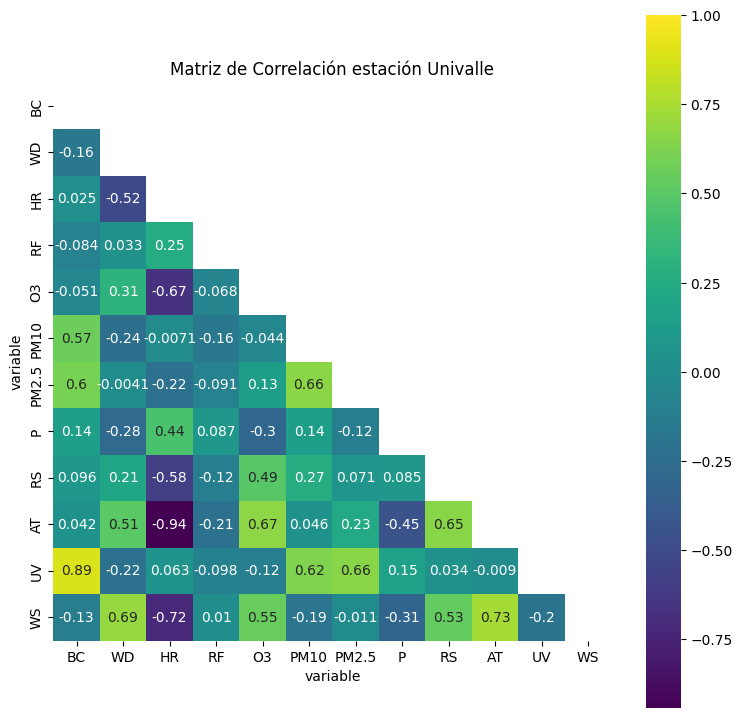

In [109]:
import seaborn as sns
import pandas as pd

# Eliminar las columnas 'fecha' y 'estacion'
df_cor_univalle = df_univalle.drop(columns=['fecha', 'estacion', 'SO2', 'AT_10_m', 'H2S'])

plt.figure(figsize = (9,9))
mask = np.triu(np.ones_like(df_cor_univalle.corr(method = 'spearman'), dtype=bool))
ax = sns.heatmap(df_cor_univalle.corr(method = 'spearman'), vmax = 1, square = True, annot = True, mask =mask, cmap = 'viridis')
plt.title('Matriz de Correlación estación Univalle')
plt.show()

Podemos observar que algunos atributos presentan una correlación significativa (por ejemplo, $>0.75$ o $<−0.75$). Aquí algunos ejemplos:

* `UV` y `BC` (0.89): Indica que aumenta el indice de rayos UV, los niveles de concentración de carbon negro aumentan.
* `AT` y `HR` (-0.95): Indica que a temperaturas más altas, los niveles de humedad relativa tienden a disminuir.

Además, para muchas características no es posible calcular un valor de correlación (NaN) debido a la falta de datos. Al examinar las relaciones con correlaciones entre $0.50$ y $0.75$, encontramos lo siguiente:

* `PM10` y `BC` (0.57): Indica que aumenta la concentración de PM10, los niveles de concentración de carbon negro aumentan.
* `PM2.5` y `BC` (0.60): Indica que aumenta la concentración de PM2.5, los niveles de concentración de carbon negro aumentan.
* `WD` y `HR` (-0.52): Indica a medida que la dirección del viento cambia con respecto a su origen, la humedad relativa tiende a disminuir ligeramente. Esto podría indicar que cambios en la dirección del viento están asociados con variaciones en la cantidad de humedad en el aire.
* `WD` y `AT` (0.51): Indica que cuando la dirección del viento cambia con respecto a su origen, la temperatura ambiental tiende a aumentar.
* `WD` y `WS` (0.69): Indica a medida que la dirección del viento cambia con respecto a su origen, la velocidad del viento tiende a incrementarse de manera considerable. Esto implica que las variaciones en la dirección del viento están asociadas con aumentos notables en su velocidad.
* `HR` y `WS` (-0.72): Indica que cuando la humedad relativa aumenta, la velocidad del viento tiende a disminuir, y viceversa. 
* `HR` y `RS` (-0.72): Indica que cuando la humedad relativa aumenta, el nivel de radiación solar tiende a disminuir, y viceversa. 
* `HR` y `O3` (-0.67): Indica que cuando la humedad relativa aumenta, la concentración de ozono tiende a disminuir, y viceversa. 
* `AT` y `O3` (0.67): Indica que cuando la temperatura aumenta, la concentración de ozono también tiende a incrementarse de manera significativa.
* `WS` y `O3` (0.55): Indica que cuando la velocidad del viento, la concentración de ozono también tiende a incrementarse de manera significativa.
* `PM2.5` y `PM10` (0.66): Muestra que las concentraciones de estas partículas están estrechamente relacionadas, posiblemente por fuentes comunes o condiciones ambientales.
* `UV` y `PM10` (0.77): Indica que a medida que el indice de rayos UV aumenta, la concentración de PM10 aumenta de manera significativa. 
* `AT` y `RS` (0.65): Indica que los días con temperaturas  más altas tienden a presentar niveles más elevados de radiación solar, y viceversa.
* `WS` y `RS` (0.53): Indica que al aumentar la velocidad del viento, tienden a presentar niveles más elevados de radiación solar, y viceversa.
* `AT` y `WS` (0.65): Indica que los días con temperaturas  más altas tienden a aumentar la velocidad del viento, y viceversa. 

Se observó que aparentemente ninguna de las características meteorológicas tiene una influencia fuerte en los niveles de `PM10`. Esto sugiere que el PM10 podría ser el resultado de una fuente de generación adicional. 

#### <font color="#30143"> Asimetría</font>

A continuación se estima el sesgo de cada atributo utilizando la función `skew()`. El resultado de inclinación muestra una inclinación positiva (derecha) o negativa (izquierda). Los valores más cercanos a cero muestran menos sesgo.

In [110]:
# Skew for each attribute
df_c_univalle.skew()

variable
BC         12.4746
WD          1.0489
H2S            NaN
HR         -0.3805
RF         10.4393
O3          1.6684
PM10        1.6626
PM2.5       0.7053
P          -0.3044
RS          0.4419
SO2            NaN
AT          0.4755
AT_10_m        NaN
UV          1.9907
WS          6.6351
dtype: float64

Para evaluar si las variables presentan sesgo, se comparara el valor absoluto de sus coeficientes con un umbral, como 1.0, Se considera que los coeficientes más próximos a cero indican un menor sesgo. Los valores de inclinación reflejan una inclinación positiva (hacia la derecha) o negativa (hacia la izquierda).

Variables con posible sesgo (valores absolutos mayores a 1.0):
* **PM10**: 1.6626
*  **O3**: 1.6684
* **RF**: 10.4393  
* **WS**: 6.6351
* **BC**: 12.4746
* **UV**: 1.9907
  
Variables sin sesgo significativo (valores absolutos menores o cercanos a 1.0):
* **PM2.5**: 0.7053
* **P**: -0.3044
* **WD**:  1.0489
* **HR**: -0.3805
* **AT**: 0.4755
* **RS**:  0.4419

#### <font color="#30143"> Visualización del conjunto de datos</font>

A continuación se visualiza las gráficas de cada variable de forma individual.

* <font color="#30143F"><b>Histograma y gráfico de densidad</b></font>

<Axes: xlabel='H2S', ylabel='Density'>

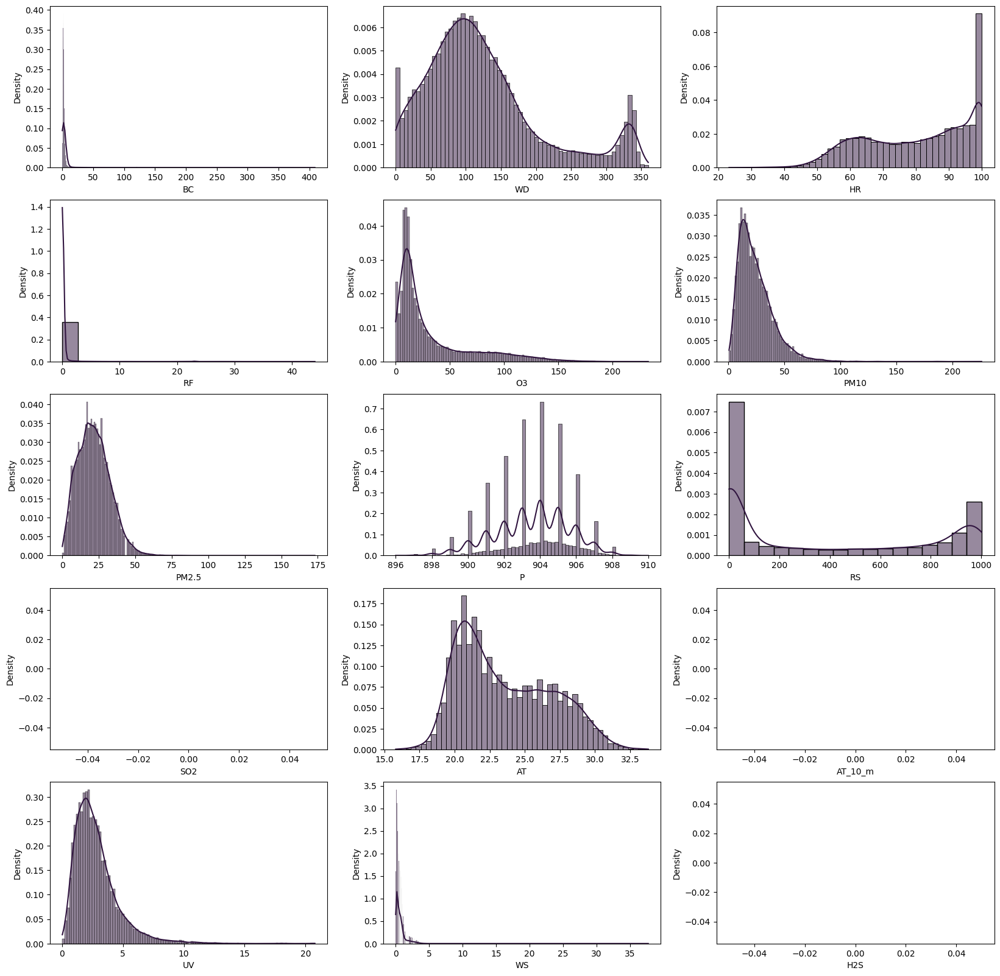

In [111]:
# Univariate Histograms
import matplotlib.pyplot as plt
import seaborn as sns

f, ax =plt.subplots(5,3,figsize=(20,20))
sns.histplot(df_univalle["BC"], ax=ax[0, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["WD"], ax=ax[0, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["HR"], ax=ax[0, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["RF"], ax=ax[1, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["O3"], ax=ax[1,1], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["PM10"], ax=ax[1, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["PM2.5"], ax=ax[2, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["P"], ax=ax[2, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["RS"], ax=ax[2, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["SO2"], ax=ax[3, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["AT"], ax=ax[3, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["AT_10_m"], ax=ax[3, 2], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["UV"], ax=ax[4, 0], kde=True, stat="density", color="#30143F")
sns.histplot(df_univalle["WS"], ax=ax[4, 1], kde=True, stat="density", color="#30143F")
sns.histplot(df_base_aerea["H2S"], ax=ax[4, 2], kde=True, stat="density", color="#30143F")

* <font color="#30143F"><b>Diagrama de Cajas y Bigotes</b></font>

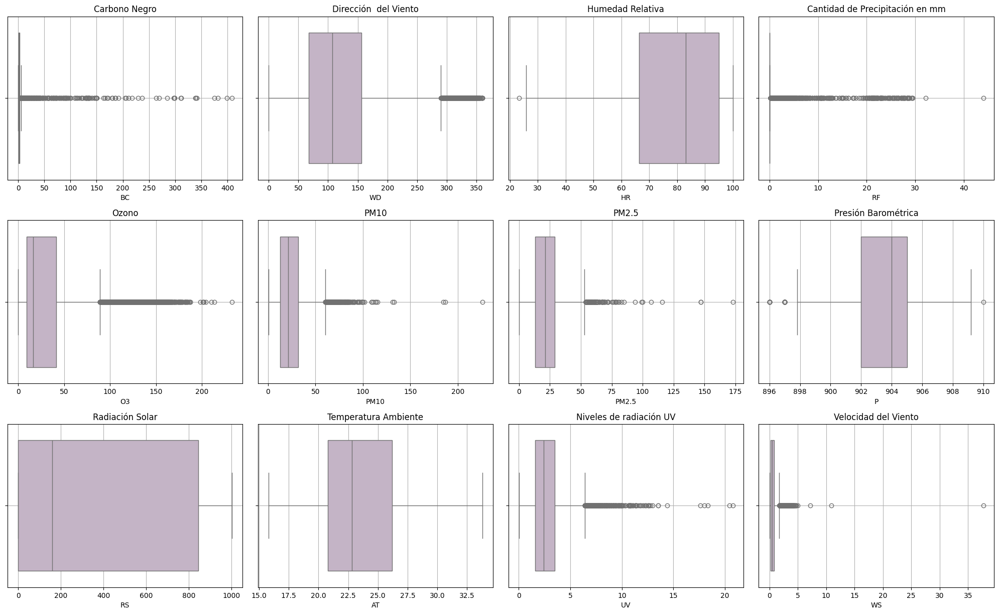

In [112]:
import seaborn as sns
import matplotlib.pyplot as plt

# Configura la figura general y el tamaño de los subplots
plt.figure(figsize=(20, 20))

# Subplot para BC
plt.subplot(5, 4, 1)
sns.boxplot(x=df_univalle["BC"], color="#c6b1c9") 
plt.title('Carbono Negro')
plt.grid(True)

# Subplot para WD
plt.subplot(5, 4, 2)
sns.boxplot(x=df_univalle["WD"], color="#c6b1c9") 
plt.title('Dirección  del Viento')
plt.grid(True)


# Subplot para HR
plt.subplot(5, 4, 3)
sns.boxplot(x=df_univalle["HR"], color="#c6b1c9") 
plt.title('Humedad Relativa')
plt.grid(True)

# Subplot para RF
plt.subplot(5, 4, 4)
sns.boxplot(x=df_univalle["RF"], color="#c6b1c9") 
plt.title('Cantidad de Precipitación en mm')
plt.grid(True)


# Subplot para O3
plt.subplot(5, 4, 5)
sns.boxplot(x=df_univalle["O3"], color="#c6b1c9") 
plt.title('Ozono')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(5, 4, 6)
sns.boxplot(x=df_univalle["PM10"], color="#c6b1c9") 
plt.title('PM10')
plt.grid(True)

# Subplot para PM2.5
plt.subplot(5, 4, 7)
sns.boxplot(x=df_univalle["PM2.5"], color="#c6b1c9") 
plt.title('PM2.5')
plt.grid(True)

# Subplot para P
plt.subplot(5, 4, 8)
sns.boxplot(x=df_univalle["P"], color="#c6b1c9") 
plt.title('Presión Barométrica')
plt.grid(True)

# Subplot para P
plt.subplot(5, 4, 9)
sns.boxplot(x=df_univalle["RS"], color="#c6b1c9") 
plt.title('Radiación Solar')
plt.grid(True)


# Subplot para AT
plt.subplot(5, 4, 10)
sns.boxplot(x=df_univalle["AT"], color="#c6b1c9") 
plt.title('Temperatura Ambiente')
plt.grid(True)

# Subplot para UV
plt.subplot(5, 4, 11)
sns.boxplot(x=df_univalle["UV"], color="#c6b1c9") 
plt.title('Niveles de radiación UV')
plt.grid(True)

# Subplot para WS
plt.subplot(5, 4, 12)
sns.boxplot(x=df_univalle["WS"], color="#c6b1c9") 
plt.title('Velocidad del Viento')
plt.grid(True)

# Mostrar los gráficos
plt.tight_layout()
plt.show()

A continuación se visualiza las interacciones entre las variables. 

* <font color="#30143F"><b>Diagrama de Dispersión</b></font>

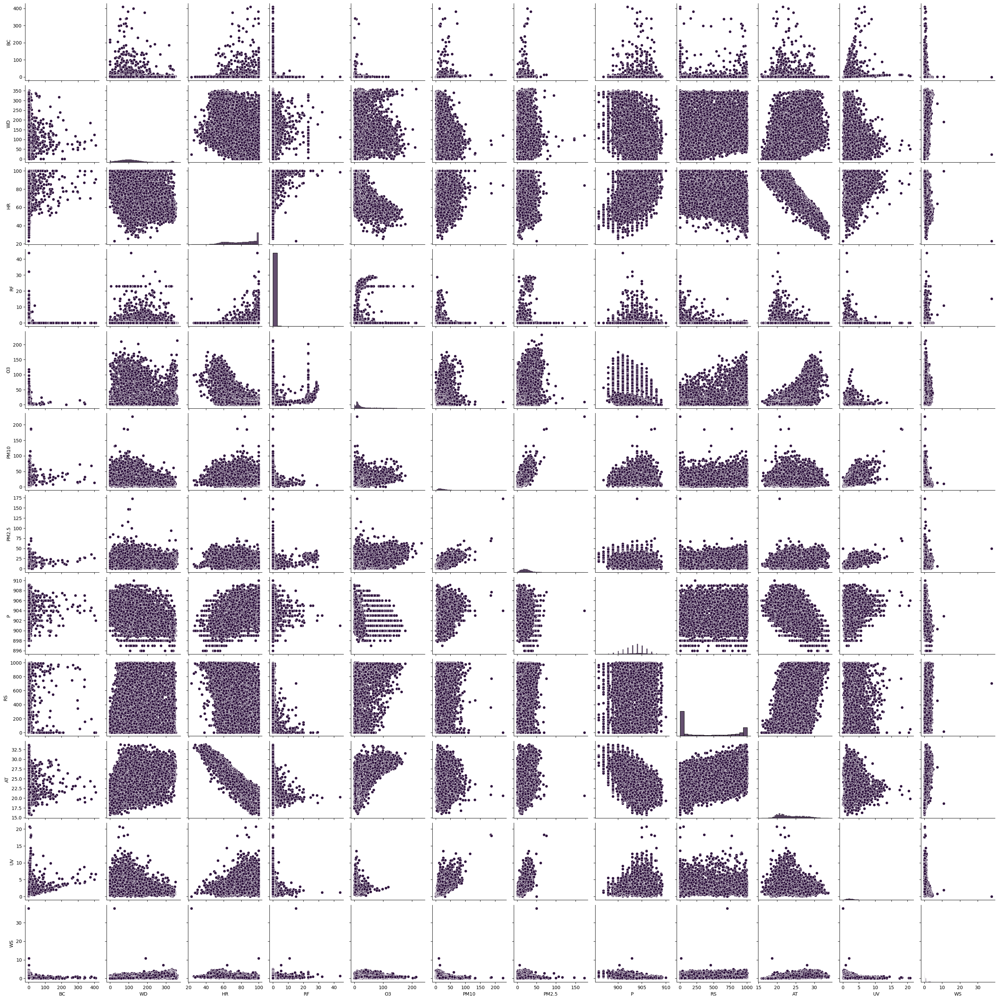

In [113]:
import seaborn as sns
import pandas as pd

sns.pairplot(df_cor_univalle,              
             plot_kws={'color': '#30143F'},   # Color de los scatter plots
             diag_kws={'color': '#30143F'})   # Color de los histogramas

A través de los gráficos generados, se corroboran los análisis derivados de los cálculos de correlación y asimetría, confirmando así la validez de las estimaciones numéricas realizadas. 

Los gráficos permiten visualizar de manera clara y efectiva la relación y el sesgo en los datos, respaldando los resultados obtenidos de las métricas numéricas.


## <font color="#30143"> Resumen Segmetación de estaciones - Datos faltantes </font>

A continuación observamos el resumen de datos faltantes, luego de realizar la segmentación por estación de medición. 

In [114]:
import pandas as pd

def combine_station_data(df, station_column):
    # Inicializar un DataFrame vacío para almacenar los resultados
    df_combined = pd.DataFrame()

    # Obtener todas las estaciones únicas
    estaciones = df[station_column].unique()
    
    for estacion in estaciones:
        # Filtrar los datos por la estación actual
        df_station = df[df[station_column] == estacion]
        
        # Calcular los datos faltantes y el porcentaje
        missing_data = df_station.isna().sum()
        total_rows = df_station.shape[0]

        # Filtrar solo las columnas con datos faltantes
        missing_vars = missing_data[missing_data > 0]
        
        # Crear un DataFrame con los datos faltantes y porcentaje
        df_station_missing = pd.DataFrame({
            'Variable': missing_vars.index,
            f'Datos Faltantes {estacion} (%)': round((missing_vars / total_rows) * 100, 2)
        })
        
        # Merge con el DataFrame combinado
        if df_combined.empty:
            df_combined = df_station_missing
        else:
            df_combined = pd.merge(df_combined, df_station_missing, on='Variable', how='outer')
    
    return df_combined

In [115]:
from IPython.display import display

result = combine_station_data(df_t, 'estacion')

# Muestra el DataFrame completo en Jupyter Notebook
display(result)


,Variable,Datos Faltantes base_aerea (%),Datos Faltantes canaveralejo (%),Datos Faltantes compartir (%),Datos Faltantes era_obrero (%),Datos Faltantes ermita (%),Datos Faltantes flora (%),Datos Faltantes pance (%),Datos Faltantes transitoria (%),Datos Faltantes univalle (%)
0,AT,28.44,43.53,5.79,68.73,37.84,53.03,37.50,67.20,49.79
1,AT_10_m,100.00,100.00,86.36,100.00,100.00,100.00,87.50,100.00,100.00
2,BC,100.00,100.00,100.00,100.00,100.00,100.00,100.00,100.00,83.61
3,H2S,100.00,100.00,100.00,100.00,100.00,78.60,100.00,92.20,100.00
4,HR,100.00,43.52,13.41,52.08,48.66,53.03,33.22,67.20,49.79
5,O3,39.26,100.00,33.17,33.26,100.00,36.53,39.62,85.83,48.30
6,P,100.00,58.93,5.77,52.12,56.50,54.49,57.02,67.58,49.79
7,PM10,100.00,40.88,27.20,33.20,25.50,32.30,31.99,85.33,77.52
8,PM2.5,38.81,80.02,37.66,72.44,73.61,70.89,75.00,85.67,33.96
9,RF,77.89,53.57,5.77,4.23,100.00,8.07,9.04,100.00,45.70


Ahora filtraremos los resultados obtenido para cada una de las estaciones donde PM10 tenga un porcentaje de datos faltantes inferior al $35\%$

In [116]:
# Filtrar el DataFrame para mostrar solo las columnas donde el porcentaje de datos faltantes para PM10 es menor a 35%
pm10_row = result[result['Variable'] == 'PM10']
# Filtrar por columnas en las que PM10 es menor al 35%
filtered_columns = [col for col in result.columns[1:] if pm10_row[col].values[0] < 35]
# Filtrar el DataFrame original por esas columnas
filtered_result = result[['Variable'] + filtered_columns]


In [117]:
from IPython.display import display
# Muestra el DataFrame completo en Jupyter Notebook
display(filtered_result)

,Variable,Datos Faltantes compartir (%),Datos Faltantes era_obrero (%),Datos Faltantes ermita (%),Datos Faltantes flora (%),Datos Faltantes pance (%)
0,AT,5.79,68.73,37.84,53.03,37.50
1,AT_10_m,86.36,100.00,100.00,100.00,87.50
2,BC,100.00,100.00,100.00,100.00,100.00
3,H2S,100.00,100.00,100.00,78.60,100.00
4,HR,13.41,52.08,48.66,53.03,33.22
5,O3,33.17,33.26,100.00,36.53,39.62
6,P,5.77,52.12,56.50,54.49,57.02
7,PM10,27.20,33.20,25.50,32.30,31.99
8,PM2.5,37.66,72.44,73.61,70.89,75.00
9,RF,5.77,4.23,100.00,8.07,9.04


A continuación se presentan las variables meteorológicas y ambientales que influyen significativamente en la predicción de las concentraciones de PM10:

* AT (temperatura del aire)
* HR (humedad relativa)
* P (presión atmosférica)
* RF (precipitación)
* RS (radiación solar)
* WD (dirección del viento)
* WS (velocidad del viento)

Dado lo anterior, se seleccionará las estación que menos datos faltantes tenga: `Estación Compartir`, para un total de datos faltantes de las variables críticas como se muestra a continuación: 

* AT (temperatura del aire): solo $5.79\%$ de datos faltantes
* HR (humedad relativa): $13.41\%$ de datos faltantes
* P (presión atmosférica): $5.77\%$ de datos faltantes
* RF (precipitación): $5.77\%$ de datos faltantes
* RS (radiación solar): $6.06\%$ de datos faltantes
* WD (dirección del viento): $5.77\%$ de datos faltantes
* WS (velocidad del viento): $5.77\%$ de datos faltantes
* PM10: $27.20\%$ de datos faltantes.
* PM2.5: $37.66\%$ de datos faltantes.

---